In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Time Series imports
from prophet import Prophet
from prophet.serialize import model_to_json, model_from_json
import statsmodels.tsa.api as sm
from statsmodels.tsa.stattools import adfuller, acf, pacf
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.vector_ar.var_model import VAR
from statsmodels.iolib.smpickle import load_pickle

# Stats and Viz imports
import json
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import time, json
from datetime import date
from sklearn.metrics import mean_squared_error
import matplotlib.pylab as plt
import os
from prophet.plot import add_changepoints_to_plot

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

Importing plotly failed. Interactive plots will not work.


In [2]:
pwd

'C:\\Users\\Alec\\OneDrive\\Documents\\Syracuse\\IST718-BigDataAnalytics\\project'

### Read the data in

In [2]:
data = pd.read_csv("./data/AHOLD ALL 3.csv")

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 324438 entries, 0 to 324437
Data columns (total 39 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   WO#                         324438 non-null  object 
 1   Property Number             324438 non-null  object 
 2   Specialty                   324438 non-null  object 
 3   Date/Time Created           324438 non-null  object 
 4   Total Charged Amount        324438 non-null  float64
 5   Portfolio                   324438 non-null  object 
 6   Priority                    324438 non-null  object 
 7   Customer GL Account Code    324438 non-null  object 
 8   Work Description            324438 non-null  object 
 9   Work Order Address          324438 non-null  object 
 10  District                    324438 non-null  object 
 11  Region                      324438 non-null  object 
 12  Date/Time Completed - Last  324438 non-null  object 
 13  Status        

- Convert our date column to datetime
- Drop Cancelled Work Orders
- Remove currency symbols from cost columns

In [3]:
data["Date/Time Created"] = pd.to_datetime(data["Date/Time Created"])

In [4]:
data_no_cancels = data[data["Status"] != "Cancelled"]

In [5]:
def clean_currency(x):
    """ If the value is a string, then remove currency symbol and delimiters
    otherwise, the value is numeric and can be converted
    """
    if isinstance(x, str):
        return(x.replace('$', '').replace(',', '').replace("(", "").replace(")", ""))
    return(x)

In [6]:
convrted_col_names = ['_'.join(col.lower().replace(".", "").replace("/", " ").replace("-", "").split(" ")) 
                      for col in  data_no_cancels.columns.tolist()]
data_no_cancels.columns = convrted_col_names

In [7]:
currency_cols = ["total_cost", "total_charged_amount", "total_labor_cost", "total_services_cost", "total_materials_cost", "total_spot_purchase_cost", "total_miscellaneous_cost"]

In [8]:
for col in currency_cols:
    data_no_cancels[col] = data_no_cancels[col].apply(clean_currency).astype(float)

C:\Users\Alec\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


- Drop text columns

In [9]:
drop_cols = ["customer_gl_account_code", "work_description", "work_order_address",
            "work_order_address_2", "property_name", "reason_note", "description"]

data_no_cancels = data_no_cancels.drop(drop_cols, axis=1)

In [10]:
data_no_cancels.dtypes

wo#                                   object
property_number                       object
specialty                             object
date_time_created             datetime64[ns]
total_charged_amount                 float64
portfolio                             object
priority                              object
district                              object
region                                object
date_time_completed__last             object
status                                object
organization                          object
item_asset                            object
item_asset_model                      object
type_category                         object
type                                  object
total_cost                           float64
work_order_city                       object
work_order_state_prov                 object
work_order_zip_postal_code            object
repair_category                       object
repair_code                           object
reason    

In [11]:
print(data_no_cancels.isna().sum())
print(data_no_cancels.isna().sum() / data_no_cancels.shape[0])

wo#                                0
property_number                    0
specialty                          0
date_time_created                  0
total_charged_amount               0
portfolio                          0
priority                           0
district                           0
region                             0
date_time_completed__last          0
status                             0
organization                       0
item_asset                         0
item_asset_model                   0
type_category                      0
type                               0
total_cost                         0
work_order_city                    0
work_order_state_prov              0
work_order_zip_postal_code         0
repair_category                    0
repair_code                        0
reason                        292543
total_labor_hours                  0
created_to_picked_up               0
created_to_started                 0
total_labor_cost                   0
t

- Get our % of corts per total cost by work order Specialty incase we need to split costs later

In [12]:
cost_cols_to_drop =[
    "total_labor_cost",
    "total_labor_cost",
    "total"
]

In [13]:
cost_cols = ["total_cost",
    "total_labor_cost",
    "total_services_cost",
    "total_materials_cost",
    "total_spot_purchase_cost",
    "total_miscellaneous_cost"]

cost_metrics = {k:"sum" for k in cost_cols}

In [14]:
cost_metrics

{'total_cost': 'sum',
 'total_labor_cost': 'sum',
 'total_services_cost': 'sum',
 'total_materials_cost': 'sum',
 'total_spot_purchase_cost': 'sum',
 'total_miscellaneous_cost': 'sum'}

In [15]:
specialty_cost_agg = data_no_cancels.groupby("specialty").agg(
    cost_metrics
)

In [16]:
specialty_cost_agg.columns

Index(['total_cost', 'total_labor_cost', 'total_services_cost',
       'total_materials_cost', 'total_spot_purchase_cost',
       'total_miscellaneous_cost'],
      dtype='object')

In [17]:
for col in specialty_cost_agg.columns:
    if col == "total_cost":
        print("skipping..", col)
        continue
    else:
        specialty_cost_agg[col + "_ratio"] = (specialty_cost_agg[col] / specialty_cost_agg["total_cost"]).round(2)
    

skipping.. total_cost


In [18]:
specialty_cost_agg.head()

,total_cost,total_labor_cost,total_services_cost,total_materials_cost,total_spot_purchase_cost,total_miscellaneous_cost,total_labor_cost_ratio,total_services_cost_ratio,total_materials_cost_ratio,total_spot_purchase_cost_ratio,total_miscellaneous_cost_ratio
specialty,,,,,,,,,,,
ALARMS,693952.310,3203.820,608035.340,0.000,21060.350,61652.800,0.000,0.880,0.000,0.030,0.090
BUILDING,761526.570,29428.690,616675.530,0.000,45607.760,69814.590,0.040,0.810,0.000,0.060,0.090
CARPENTRY,5913858.800,632184.080,2596607.530,0.000,2280028.090,405039.100,0.110,0.440,0.000,0.390,0.070
CLEANING,1152180.080,7754.370,1023003.670,0.000,35719.240,85702.800,0.010,0.890,0.000,0.030,0.070
"Compactor, Baler, Docks",0.000,0.000,0.000,0.000,0.000,0.000,NaN,NaN,NaN,NaN,NaN


In [19]:
specialty_cost_agg[[col for col in specialty_cost_agg.columns if col.endswith("_ratio")]].sum(axis=1)

specialty
ALARMS                           1.000
BUILDING                         1.000
CARPENTRY                        1.010
CLEANING                         1.000
Compactor, Baler, Docks          0.000
DOOR REPAIR                      1.000
Door - Auto                      0.000
Door - Other Door Repairs        1.000
Door - Overhead, Rollup          0.000
Door - Perimeter Alarm           0.000
ELEC-LOW VOLTAGE                 1.010
ELECTRICAL                       0.990
ELEVATOR                         0.000
ELEVATOR REPAIR                  1.000
ENERGY MGMT                      0.000
Electrical - General Repairs     0.000
Energy Management                0.000
FIRE PREVENTION                  1.000
FLOOR REPAIR                     1.010
FOOD EQUIP                       1.000
FRONT END                        1.010
Fire Prevention - Alarms         1.000
Fire Prevention - Ansul          1.000
Fire Prevention - Extinguisher   1.000
Fire Prevention - Sprinkler      1.000
Flooring Repair

- Set our management fee that we will add to the total cost in order to charge the customer

In [20]:
# flat management fee charged to customer on top of cost 
mgmt_fee = 0.09

In [21]:
data_no_cancels.shape

(292543, 32)

- Identify categorical columns that need to be one hot encoded 

In [42]:
one_hot_encode_cols = ["work_order_state_prov", "repair_category", "priority", "specialty_group"]

In [43]:
ohe_df = pd.DataFrame()

for i in one_hot_encode_cols:
    dummies = pd.get_dummies(data_no_cancels[i], prefix=i)
    if ohe_df.empty:
        ohe_df = dummies
    else:
        ohe_df = ohe_df.join(dummies)
        print(ohe_df.shape)

(292543, 30)
(292543, 35)
(292543, 40)


- Set other columns to drop that will not forecasted, or will be covered by one hot encoding 

In [44]:
cost_cols_drop = cost_cols[1:]
additional_drop_cols = [
    "total_charged_amount", "reason", "date_time_completed__last",
    "property_number", 'status', 'organization', 'item_asset',
       'item_asset_model', 'type','work_order_city', 'work_order_zip_postal_code',
    'repair_code', 'created_to_picked_up',
       'created_to_started'   
]

remaining_drop_cols = one_hot_encode_cols + cost_cols_drop + additional_drop_cols

In [45]:
data_no_cancels.columns

Index(['wo#', 'property_number', 'specialty', 'date_time_created',
       'total_charged_amount', 'portfolio', 'priority', 'district', 'region',
       'date_time_completed__last', 'status', 'organization', 'item_asset',
       'item_asset_model', 'type_category', 'type', 'total_cost',
       'work_order_city', 'work_order_state_prov',
       'work_order_zip_postal_code', 'repair_category', 'repair_code',
       'reason', 'total_labor_hours', 'created_to_picked_up',
       'created_to_started', 'total_labor_cost', 'total_services_cost',
       'total_materials_cost', 'total_spot_purchase_cost',
       'total_miscellaneous_cost', 'specialty_group'],
      dtype='object')

In [46]:
data_dropped_cols = data_no_cancels.drop(remaining_drop_cols, axis=1)

In [47]:
data_dropped_cols.head()

,wo#,specialty,date_time_created,portfolio,district,region,type_category,total_cost,total_labor_hours
1,AHD000001960,OPERATIONS REQUEST,2013-01-09 21:10:00,Giant Food,District 95,Region 9,Basic,4424.000,2.650
2,1731290,CARPENTRY,2012-09-04 11:34:00,Central,District 326,Region 032,Request,91.510,3.000
3,1414124,CARPENTRY,2011-04-08 09:04:00,South,District 336,Region 033,Request,71.260,3.000
5,AHD000003737,CLEANING,2013-02-20 13:35:00,Giant Food,District 105,Region 10,Basic,125.000,0.300
6,1389983,FLOOR REPAIR,2011-02-25 14:19:00,South,District 333,Region 033,Request,0.000,2.000


In [48]:
data_dropped_cols.shape

(292543, 9)

In [49]:
data_dropped_cols_ohe = data_dropped_cols.join(ohe_df)
data_dropped_cols_ohe.shape

(292543, 49)

In [50]:
data_dropped_cols_ohe.sort_values("date_time_created").head()

,wo#,specialty,date_time_created,portfolio,district,region,type_category,total_cost,total_labor_hours,work_order_state_prov_CT,work_order_state_prov_DC,work_order_state_prov_DE,work_order_state_prov_MA,work_order_state_prov_MD,work_order_state_prov_NJ,work_order_state_prov_NY,work_order_state_prov_PA,work_order_state_prov_RI,work_order_state_prov_VA,work_order_state_prov_WV,repair_category_CASE,repair_category_CLEARED DRAIN,repair_category_CONDENSER,repair_category_DEFROST/DE-ICE,repair_category_DIDN'T ATTEMPT REPAIR,repair_category_EVAPORATOR,repair_category_FOLLOW-UP REQUIRED,repair_category_HEAT RECLAIM,repair_category_HOT WATER RECLAIM,repair_category_NO TROUBLE FOUND,repair_category_NOT REPAIRED,repair_category_PIPING,repair_category_POWER RESTORED,repair_category_PROJECT WORK,repair_category_RACK,repair_category_RELOCATE/MOVE,repair_category_REPAIRED,repair_category_SPLIT PACKAGED UNIT,repair_category_VALVES RACK,priority_P1,priority_P2,priority_P3,priority_P4,priority_P5,specialty_group_Baltic Specialty Group,specialty_group_DTZ Hard Services,specialty_group_DTZ NOC,specialty_group_DTZ Soft Services,specialty_group_Legacy Metrix Specilaty Group
281478,1289786,PLUMBING,2011-01-01 09:04:00,North,District 315,Region 031,Request,255.000,5.000,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0
229351,1289840,PLUMBING,2011-01-01 09:19:00,North,District 315,Region 031,Request,0.000,4.000,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0
65026,1289887,REFRIGERATION,2011-01-01 10:10:00,North,District 316,Region 031,Request,0.000,38.970,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0
286930,1289640,CARPENTRY,2011-01-01 10:19:00,Central,District 325,Region 032,Request,45.000,2.000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0
85971,1290036,DOOR REPAIR,2011-01-01 15:49:00,South,District 332,Region 033,Request,0.000,1.750,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0


In [51]:
group_cols {data_dropped_cols_ohe.columns} - {'total_cost', 'total_labor_hours'}

SyntaxError: invalid syntax (<ipython-input-51-2954c067ad0a>, line 1)

In [117]:
data_dropped_cols_ohe.set_index("date_time_created").resample('M').sum()

,total_cost,total_labor_hours,specialty_ALARMS,specialty_BUILDING,specialty_CARPENTRY,specialty_CLEANING,"specialty_Compactor, Baler, Docks",specialty_DOOR REPAIR,specialty_Door - Auto,specialty_Door - Other Door Repairs,"specialty_Door - Overhead, Rollup",specialty_Door - Perimeter Alarm,specialty_ELEC-LOW VOLTAGE,specialty_ELECTRICAL,specialty_ELEVATOR,specialty_ELEVATOR REPAIR,specialty_ENERGY MGMT,specialty_Electrical - General Repairs,specialty_Energy Management,specialty_FIRE PREVENTION,specialty_FLOOR REPAIR,specialty_FOOD EQUIP,specialty_FRONT END,specialty_Fire Prevention - Alarms,specialty_Fire Prevention - Ansul,specialty_Fire Prevention - Extinguisher,specialty_Fire Prevention - Sprinkler,specialty_Flooring Repairs,specialty_Food Equipment,specialty_Front End - Cart Corral,specialty_Front End - Mart Carts,specialty_Front End - Register Lanes,specialty_Front End - Technology,specialty_GAS STATION,specialty_GLASS REPAIR,specialty_Gas Station Equipment,specialty_General Maintenance,specialty_HVAC,specialty_HVAC Repair,specialty_Jacks - Manual,specialty_Jacks - Powered,specialty_Janitorial - Cart Cleaning,specialty_Janitorial - Floor Care,specialty_Janitorial - Window Cleaning,specialty_LIGHTING,specialty_LOCKSMITH,specialty_Landscaping,specialty_Legacy Metrix Specialty,specialty_Life Safety,specialty_MILLWRIGHT,specialty_MUSAK,specialty_OPERATIONS REQUEST,specialty_PAINTING,specialty_PEST CONTROL,specialty_PLUMBING,specialty_PLUMBING-DRAINS,specialty_PLUMBING-EXTERIOR,specialty_Parking Lot - Line Painting,specialty_Parking Lot - Lot Sweeping,specialty_Parking Lot - Repairs,specialty_Plumbing - Drains,specialty_Plumbing - EVAC,specialty_Plumbing - Exterior,specialty_Plumbing - General Repairs,specialty_Power Outages,specialty_Pressure Washing,specialty_REFRIGERATION,specialty_ROOF REPAIR,specialty_Refrigeration Repair,specialty_Roofing,specialty_SIGN REPAIR,specialty_STARBUCKS,specialty_STORE EXTERIOR,specialty_Snow and Ice,specialty_VENTILATION,specialty_Welding and Fabrication,region_Region 031,region_Region 032,region_Region 033,region_Region 10,region_Region 13,region_Region 14,region_Region 15,region_Region 33,region_Region 9,type_category_Basic,type_category_PMRM,type_category_Request,work_order_state_prov_CT,work_order_state_prov_DC,work_order_state_prov_DE,work_order_state_prov_MA,work_order_state_prov_MD,work_order_state_prov_NJ,work_order_state_prov_NY,work_order_state_prov_PA,work_order_state_prov_RI,work_order_state_prov_VA,work_order_state_prov_WV,repair_category_CASE,repair_category_CLEARED DRAIN,repair_category_CONDENSER,repair_category_DEFROST/DE-ICE,repair_category_DIDN'T ATTEMPT REPAIR,repair_category_EVAPORATOR,repair_category_FOLLOW-UP REQUIRED,repair_category_HEAT RECLAIM,repair_category_HOT WATER RECLAIM,repair_category_NO TROUBLE FOUND,repair_category_NOT REPAIRED,repair_category_PIPING,repair_category_POWER RESTORED,repair_category_PROJECT WORK,repair_category_RACK,repair_category_RELOCATE/MOVE,repair_category_REPAIRED,repair_category_SPLIT PACKAGED UNIT,repair_category_VALVES RACK,priority_P1,priority_P2,priority_P3,priority_P4,priority_P5,specialty_group_Baltic Specialty Group,specialty_group_DTZ Hard Services,specialty_group_DTZ NOC,specialty_group_DTZ Soft Services,specialty_group_Legacy Metrix Specilaty Group
date_time_created,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2011-01-31,70722.460,5907.260,5.000,0.000,478.000,11.000,0.000,149.000,0.000,0.000,0.000,0.000,1.000,21.000,0.000,0.000,0.000,0.000,0.000,8.000,52.000,14.000,66.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,5.000,9.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,71.000,0.000,0.000,0.000,54.000,0.000,0.000,14.000,2.000,45.000,5.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,113.000,92.000,0.000,0.000,0.000,0.000,14.000,0.000,1.000,0.000,482.000,436.000,284.000,14.000,0.000,1.000,0.000,0.000,14

In [ ]:
data.rename()

In [54]:
data_dropped_cols_ohe.groupby(["date_time_created", "portfolio"])\
    .agg({"total_cost": 'sum', 
            "total_labor_hours": 'sum',
              "wo#": "count"}).reset_index().head(35)#.set_index("date_time_created").resample('M').sum()

,date_time_created,portfolio,total_cost,total_labor_hours,wo#
0,2011-01-01 09:04:00,North,255.000,5.000,1
1,2011-01-01 09:19:00,North,0.000,4.000,1
2,2011-01-01 10:10:00,North,0.000,38.970,1
3,2011-01-01 10:19:00,Central,45.000,2.000,1
4,2011-01-01 15:49:00,South,0.000,1.750,1
5,2011-01-01 17:34:00,North,0.000,0.500,1
6,2011-01-02 09:34:00,North,0.000,3.500,1
7,2011-01-02 10:49:00,Central,0.000,3.500,1
8,2011-01-02 10:49:00,North,81.600,2.000,1
9,2011-01-02 11:34:00,North,0.000,2.000,1


In [56]:
data_dropped_cols_ohe.groupby([pd.Grouper(key="date_time_created", freq="MS"), "portfolio"])\
    .agg({"total_cost": 'sum', 
            "total_labor_hours": 'sum',
              "wo#": "count"}).reset_index().head()

,date_time_created,portfolio,total_cost,total_labor_hours,wo#
0,2011-01-01,Central,27471.870,1850.540,436
1,2011-01-01,Giant Food,0.000,639.530,29
2,2011-01-01,Giant Martins,0.000,0.380,1
3,2011-01-01,North,28213.940,2245.190,482
4,2011-01-01,South,15036.650,1171.620,283


### Group the data by month and the portfolio value so we can pass it to our model

In [57]:
motnhly_grp = data_dropped_cols_ohe.groupby([pd.Grouper(key="date_time_created", freq="MS"), "portfolio"])\
    .agg({"total_cost": 'sum', 
            "total_labor_hours": 'sum',
              "wo#": "count"}).reset_index().reset_index()

In [91]:
count = 0

def monthly_port_prophet_ts_reg(data):
    # Select the columns to pass to the prophet model
#     data.dropna()
    
    data = data.rename({"date_time_created": "ds",
                        "total_cost": "y"
                       }
                       , axis=1)
    #time_series_data = data[['ds','MedianPrice']]
    
    #time_series_data.columns = ["ds", "y"]
    store = data.portfolio.iloc[0]    
    
    # Instantiate and fit the prophet model
    m = Prophet(yearly_seasonality=True)
    m.fit(data)
    
    # Save the model
    fname = "./models/monthly_port/{0}_model.json".format(store) 
    with open(fname, 'w') as fout:
        json.dump(model_to_json(m), fout)
    
    # Make a monthly dataframe to predict next 12 months (FY 2018)
    future = m.make_future_dataframe(periods=12,freq="MS")
    forecast_df = m.predict(future)
    forecast_df = forecast_df.set_index('ds')

    # joing the forecast and historical data together
    history_data = data.set_index('ds')
    results_df = forecast_df.join(history_data, how="left")
    results_df["yhat"] = results_df["yhat"].apply(lambda x: x if x >= 0 else 0)
    #results_df = results_df.reset_index(level=0)

#     results_df["portfolio"] = store
    global count
    count +=1
    global start_time
    print("Done.. {0}".format(count))
    print(f"Elapsed: {(time.time() - start_time)/ 60:.2f} mins")
    
    return results_df

In [92]:
start_time = time.time()
monthly_port_results = motnhly_grp.groupby("portfolio").apply(monthly_port_prophet_ts_reg)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 1
Elapsed: 0.05 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 2
Elapsed: 0.09 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 3
Elapsed: 0.13 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 4
Elapsed: 0.16 mins
Done.. 5
Elapsed: 0.20 mins


In [93]:
monthly_port_results.index.set_names(["store", "ds"], inplace=True)
monthly_port_results = monthly_port_results.reset_index().drop("store", axis=1)

In [94]:
monthly_port_results.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat,index,portfolio,y,total_labor_hours,wo#
0,2011-01-01,-62850.212,-99655.067,81573.877,-62850.212,-62850.212,54276.536,54276.536,54276.536,54276.536,54276.536,54276.536,0.000,0.000,0.000,0.000,0.000,Central,27471.870,1850.540,436.000
1,2011-02-01,-53056.464,-95352.258,73825.020,-53056.464,-53056.464,45621.871,45621.871,45621.871,45621.871,45621.871,45621.871,0.000,0.000,0.000,0.000,5.000,Central,17279.400,1976.270,349.000
2,2011-03-01,-44210.498,-31792.240,135534.037,-44210.498,-44210.498,92909.453,92909.453,92909.453,92909.453,92909.453,92909.453,0.000,0.000,0.000,48698.955,10.000,Central,45911.000,1838.383,406.000
3,2011-04-01,-34416.750,-67338.975,104358.994,-34416.750,-34416.750,49834.889,49834.889,49834.889,49834.889,49834.889,49834.889,0.000,0.000,0.000,15418.139,15.000,Central,38693.180,1940.010,369.000
4,2011-05-01,-24938.929,-126869.165,41004.004,-24938.929,-24938.929,-17719.582,-17719.582,-17719.582,-17719.582,-17719.582,-17719.582,0.000,0.000,0.000,0.000,20.000,Central,27174.020,1912.980,435.000


In [95]:
portfolios = data_dropped_cols_ohe["portfolio"].unique().tolist()
portfolios

['Giant Food', 'Central', 'South', 'North', 'Giant Martins']

- plot the forecast and the forecast components

**************************************************
Giant Food
**************************************************
**************************************************
Central
**************************************************
**************************************************
South
**************************************************
**************************************************
North
**************************************************
**************************************************
Giant Martins
**************************************************


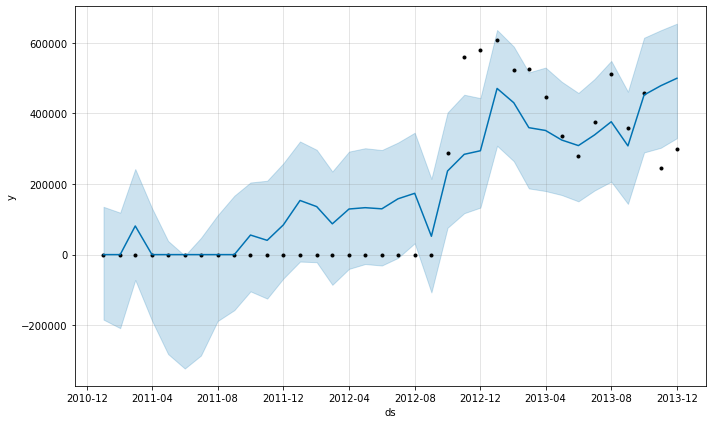

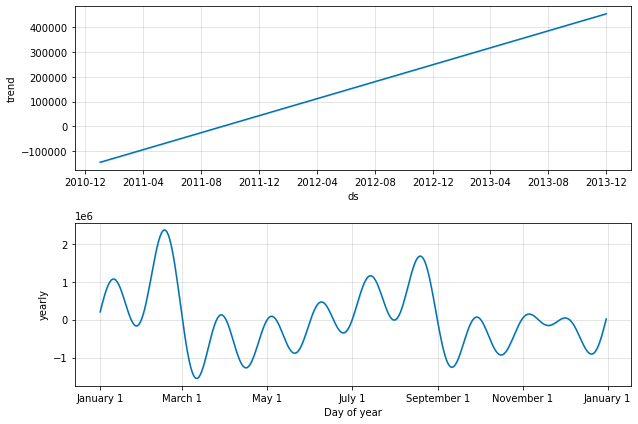

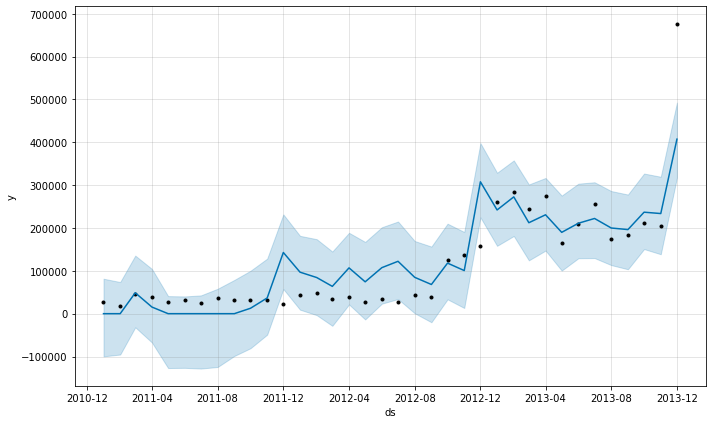

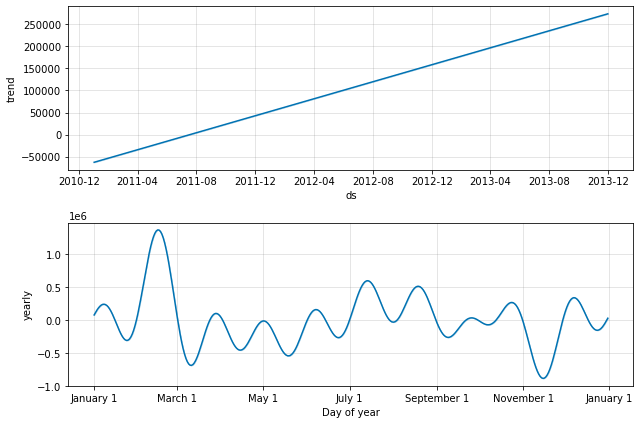

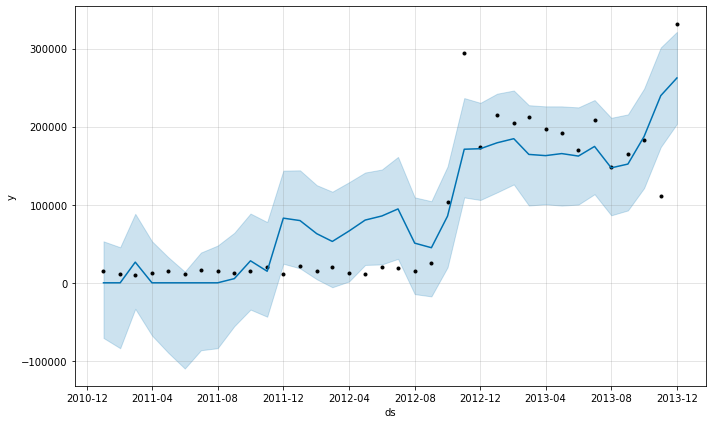

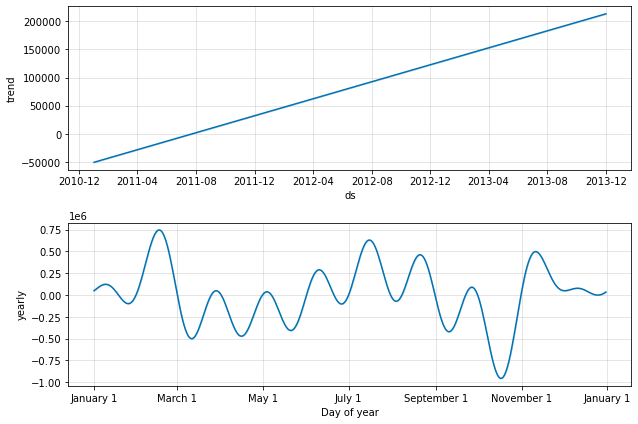

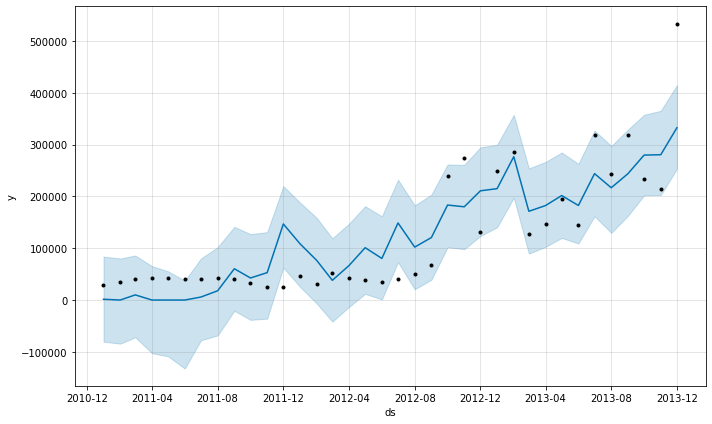

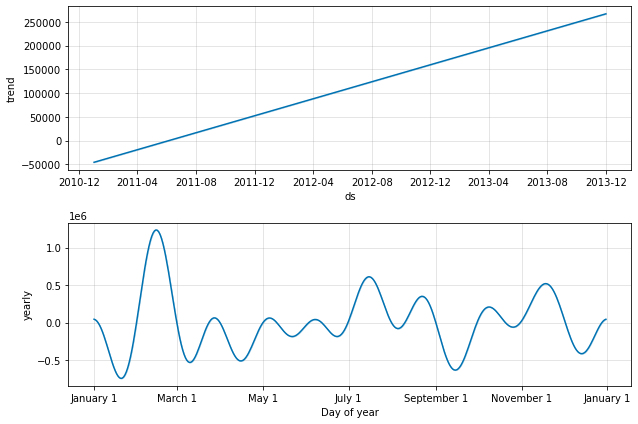

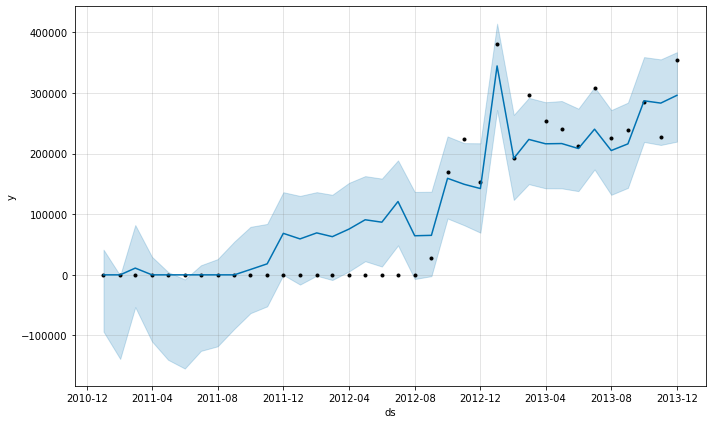

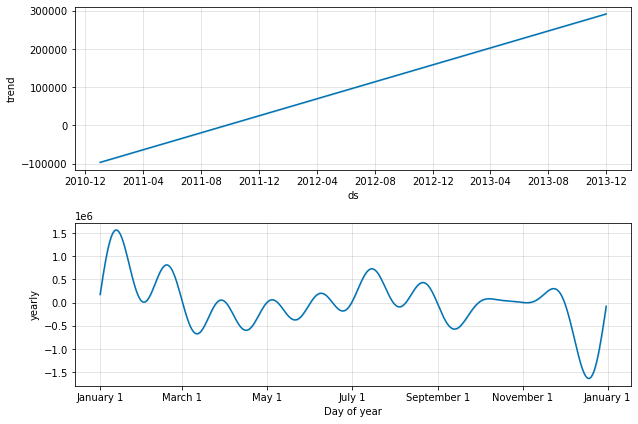

In [96]:
for store in portfolios:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = monthly_port_results[monthly_port_results["portfolio"] == store]
    with open("./models/monthly_port/prophet/{0}_model.json".format(store), 'r') as fin:
        m = model_from_json(json.load(fin))  # Load model
        fig1 = m.plot(store_results)
        fig1.savefig("./images/monthly_port/{0}_forecast_plot.png".format(store))
        fig2 = m.plot_components(store_results)
        fig2.savefig("./images/monthly_port/{0}_forecast_components.png".format(store))
        

**************************************************
Giant Food
**************************************************
**************************************************
Central
**************************************************
**************************************************
South
**************************************************
**************************************************
North
**************************************************
**************************************************
Giant Martins
**************************************************


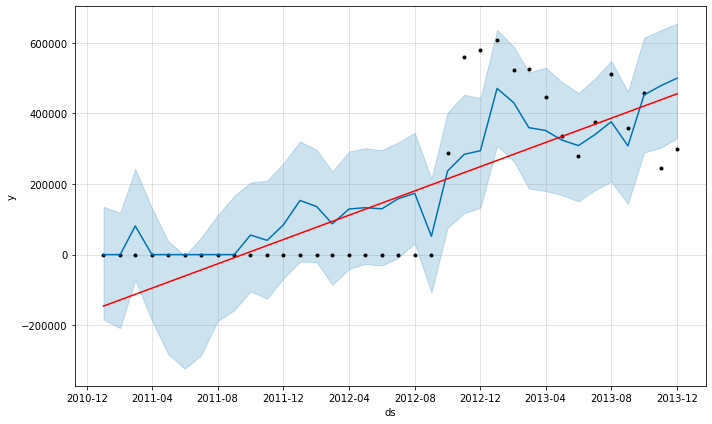

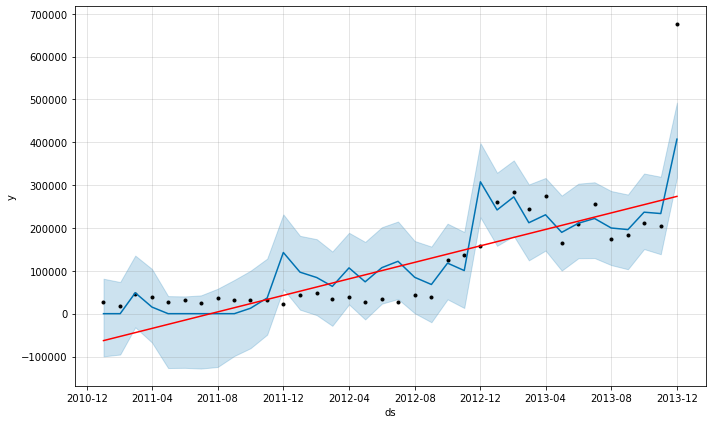

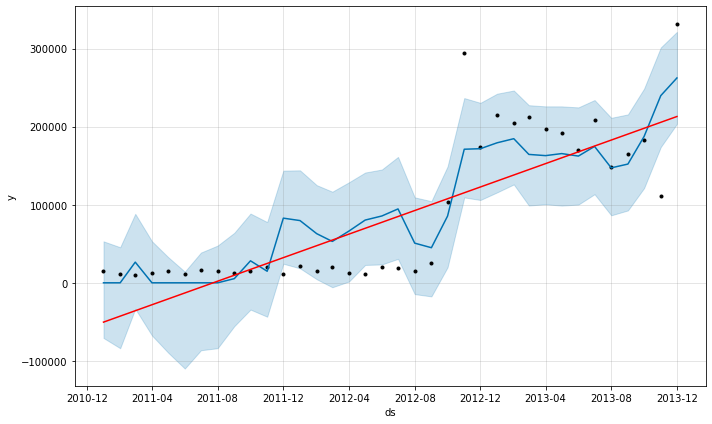

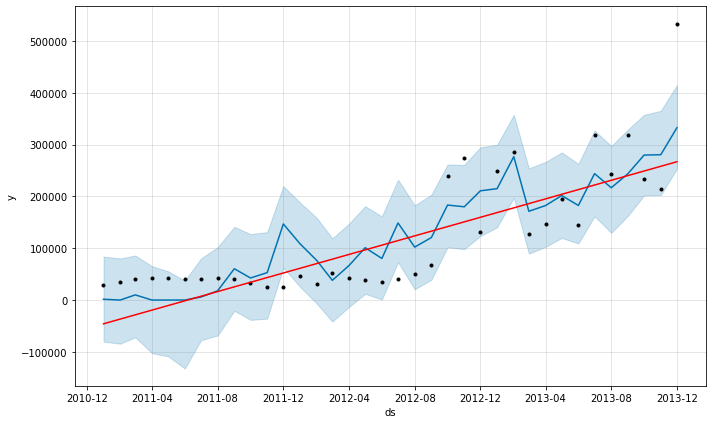

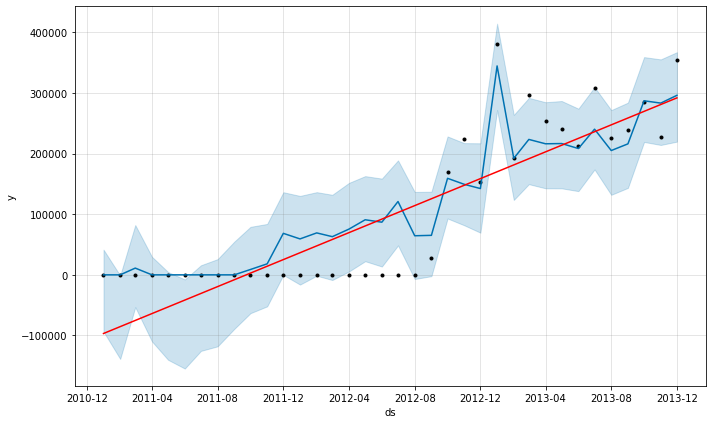

In [97]:
for store in portfolios:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = monthly_port_results[monthly_port_results["portfolio"] == store]
    with open("./models/monthly_port/prophet/{0}_model.json".format(store), 'r') as fin:
        m = model_from_json(json.load(fin))  # Load model
        fig1 = m.plot(store_results)
        a = add_changepoints_to_plot(fig1.gca(), m, store_results)
        fig1.savefig("./images/monthly_port/{0}_forecast_plot_w_changepoints.png".format(store))
        
        

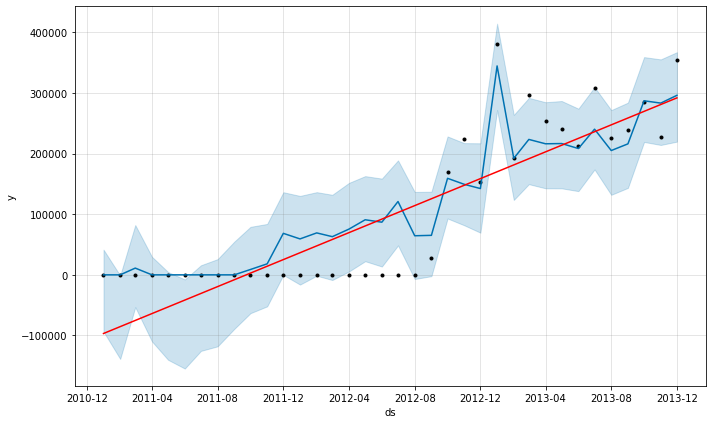

In [98]:
fig1

- evaluate the model and save the metrics

In [99]:
def monthly_port_eval_forecast(data):
    #print(data.head())
    data = data.dropna(how='any')
    data = data.replace(np.inf, 0).replace(-np.inf, 0)
    mean_fcst_vals = np.mean(data["y"])
    std_fcst_vals = np.std(data["yhat"])

    mse = mean_squared_error(data["y"], data["yhat"])
    rmse = np.sqrt(mse)
    rmse_pct = np.round(rmse / mean_fcst_vals, 6)
    results_dict = {
      "portfolio": [data["portfolio"].iloc[0]],
      "mse": [mse],
      "rmse": [rmse],
      "rmse_pct": [rmse_pct],
      "forecast_standard_deviation": [std_fcst_vals]
    }

    return pd.DataFrame.from_dict(results_dict)

In [100]:
monthly_port_results_errors = monthly_port_results.groupby("portfolio").apply(monthly_port_eval_forecast)
monthly_port_results_errors

,,portfolio,mse,rmse,rmse_pct,forecast_standard_deviation
portfolio,,,,,,
Central,0,Central,4264285662.882,65301.498,0.551,103567.632
Giant Food,0,Giant Food,14418636528.633,120077.627,0.676,163488.534
Giant Martins,0,Giant Martins,2375635030.348,48740.487,0.463,103170.684
North,0,North,3851041049.175,62056.757,0.497,96920.964
South,0,South,2142155265.386,46283.423,0.515,76579.108


In [101]:
monthly_port_results_errors.to_csv("./results/monthly_port/result_error_metrics.csv", index=False)

In [102]:
monthly_port_results.to_csv("./results/monthly_port/forecast.csv", index=False)

### Build a Vector Auto Regression (VAR) model to forecast total cost and labor hours

In [71]:
count = 0
def monthly_port_var_ts(data):
    data = data.rename({"date_time_created": "ds",
                        "total_cost": "y"
                       }
                       , axis=1)
    #time_series_data = data[['ds','MedianPrice']]
    data = data.set_index("ds")
    
    #time_series_data.columns = ["ds", "y"]
    store = data.portfolio.iloc[0] 
    ts_data = data.drop("portfolio", axis=1)
    model = VAR(endog=ts_data)
    model_fit = model.fit()
    
    model_fit.save("./models/monthly_port/var/{0}_var_model.pickle".format(store))
    
    predictions = model_fit.forecast(model_fit.y, steps=12)
    
    
    pred = pd.DataFrame(index=range(0,len(predictions)),columns=[ts_data.columns])
    for j in range(0,len(ts_data.columns)):
        for i in range(0, len(predictions)):
            pred.iloc[i][j] = predictions[i][j]
    global count
    count +=1
    global start_time
    print("Done.. {0}".format(count))
    print(f"Elapsed: {(time.time() - start_time)/ 60:.2f} mins")
    
    return pred

In [72]:
start_time = time.time()
var_monthly_port_results = motnhly_grp.groupby("portfolio").apply(monthly_port_var_ts).reset_index().drop("level_1", axis=1)

Done.. 1
Elapsed: 0.00 mins
Done.. 2
Elapsed: 0.00 mins
Done.. 3
Elapsed: 0.00 mins
Done.. 4
Elapsed: 0.00 mins
Done.. 5
Elapsed: 0.00 mins


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\base\wrapper.py:34: FutureWarning: y is a deprecated alias for endog, will be removed in version 0.11.0
  obj = getattr(results, attr)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3

In [73]:
var_monthly_port_results.to_csv("./results/monthly_port/var/forecast.csv", index=False)

In [74]:
var_monthly_port_results

,portfolio,index,y,total_labor_hours,wo#
0,Central,180.000,567265.375,23890.096,3162.925
1,Central,185.000,523459.867,27487.094,3623.591
2,Central,190.000,503471.260,31171.290,3935.562
3,Central,195.000,494097.439,33798.656,4130.250
4,Central,200.000,491049.398,35570.769,4260.462
5,Central,205.000,492575.236,36852.714,4362.948
6,Central,210.000,497608.122,37905.268,4457.543
7,Central,215.000,505312.800,38873.872,4553.159
8,Central,220.000,515004.588,39827.727,4652.890
9,Central,225.000,526138.840,40794.377,4757.157


- print model summary to text files

In [75]:
for store in portfolios:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = monthly_port_results[monthly_port_results["portfolio"] == store]
    
    vm = load_pickle("./models/monthly_port/var/{0}_var_model.pickle".format(store))
    with open("./results/monthly_port/var/{0}_model_summary.txt".format(store), 'w') as f:
        print(vm.summary(),file=f)

**************************************************
Giant Food
**************************************************
**************************************************
Central
**************************************************
**************************************************
South
**************************************************
**************************************************
North
**************************************************
**************************************************
Giant Martins
**************************************************


- save forecast and autocorrelation plots 

**************************************************
Giant Food
**************************************************
**************************************************
Central
**************************************************
**************************************************
South
**************************************************
**************************************************
North
**************************************************
**************************************************
Giant Martins
**************************************************


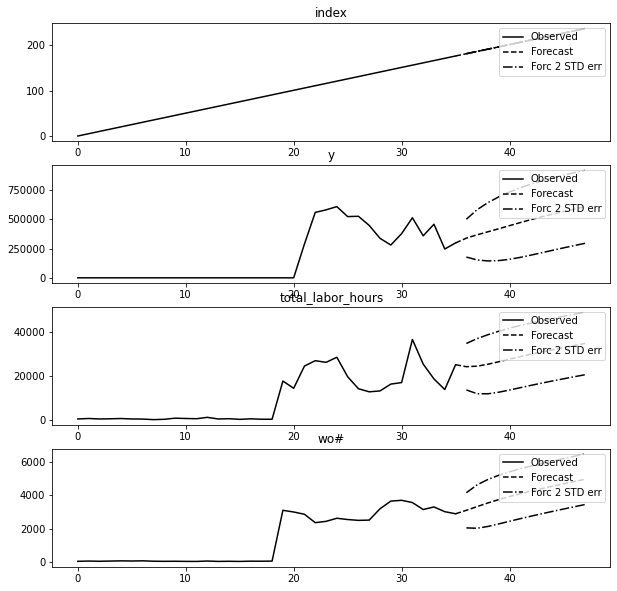

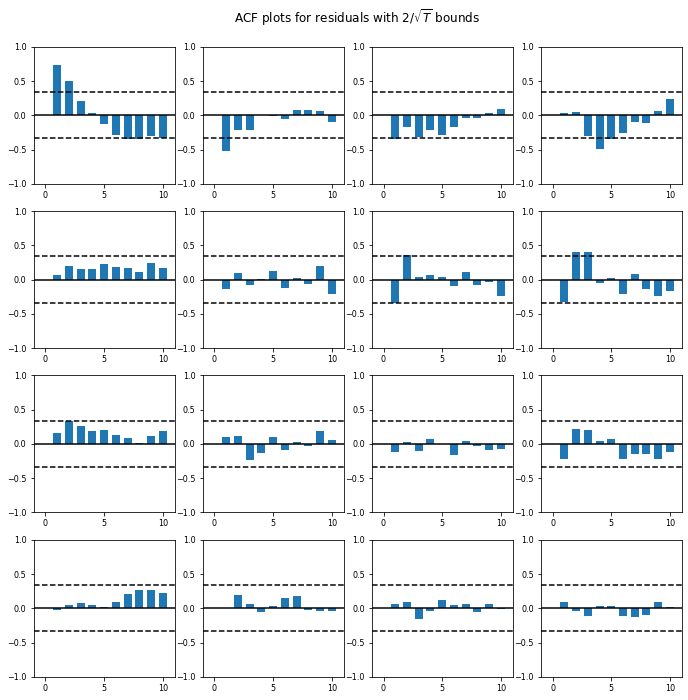

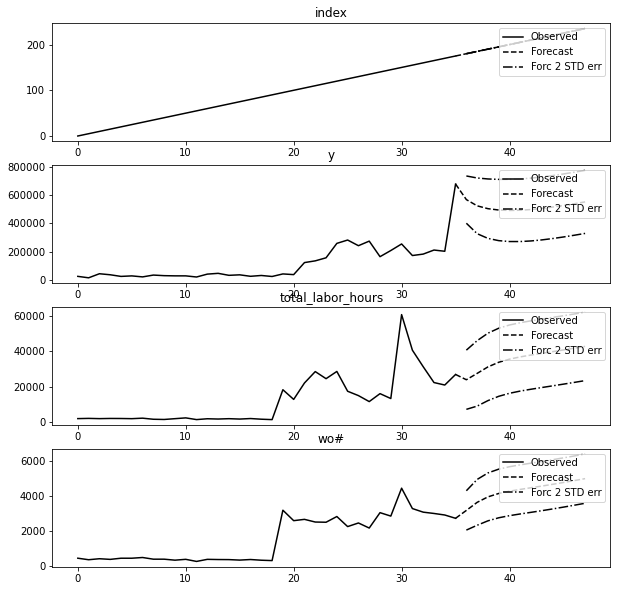

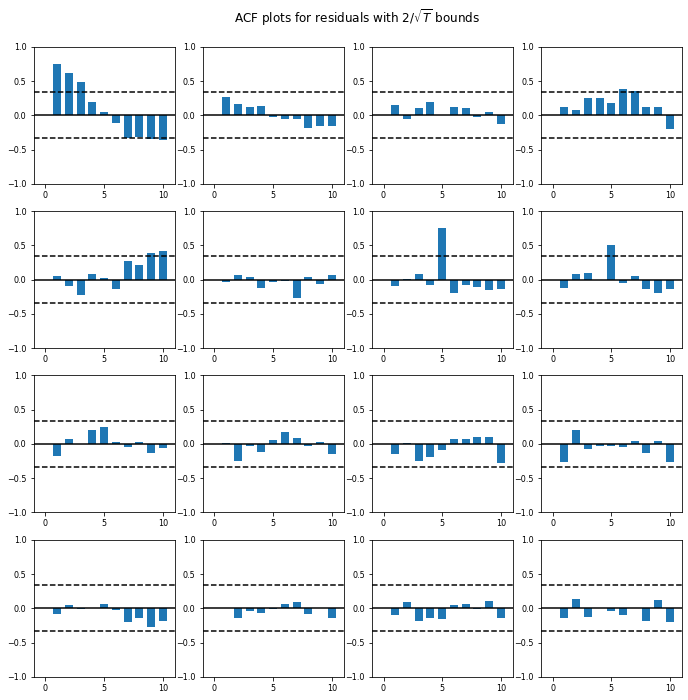

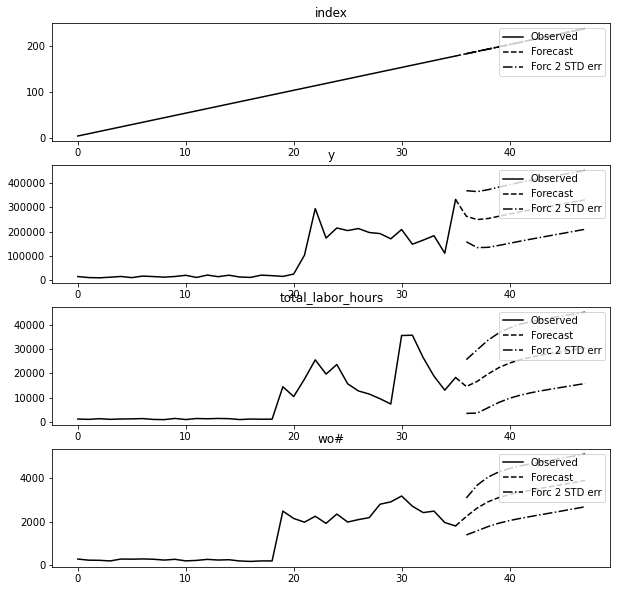

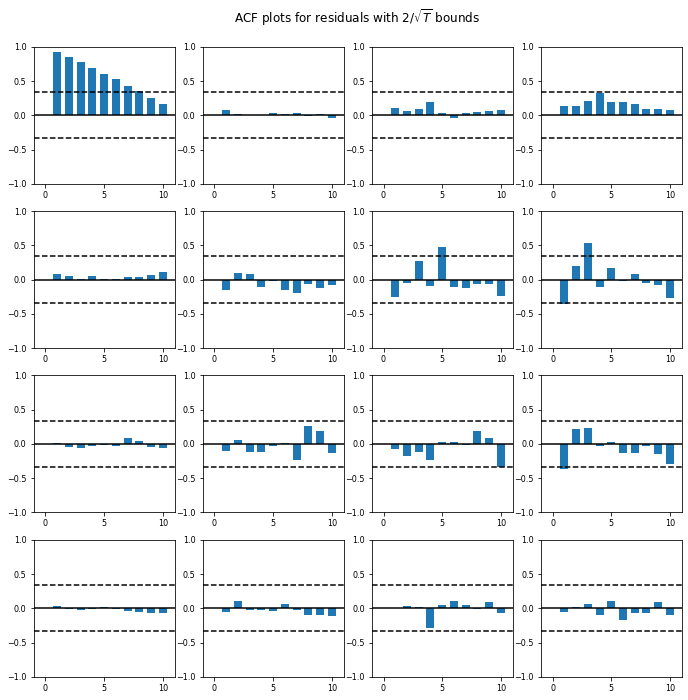

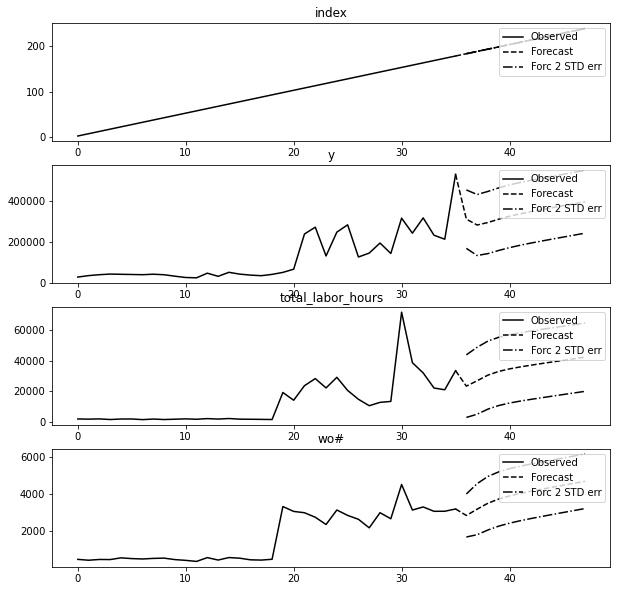

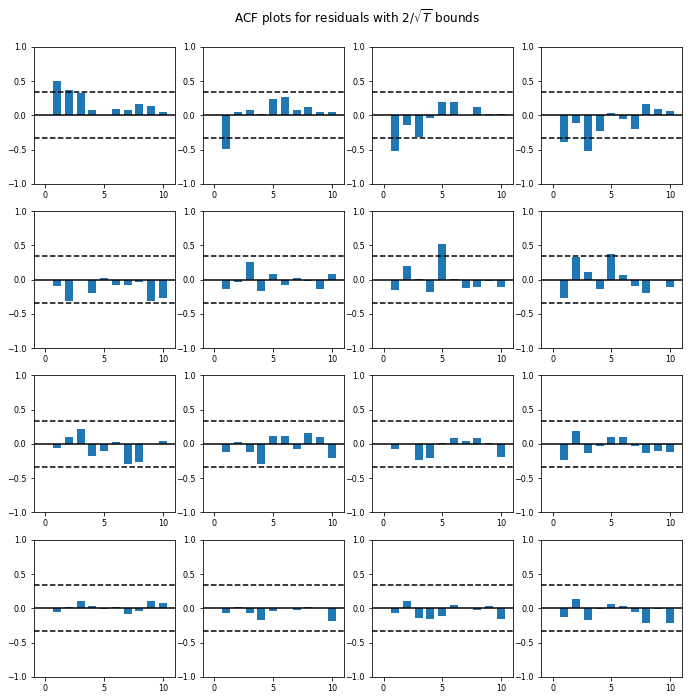

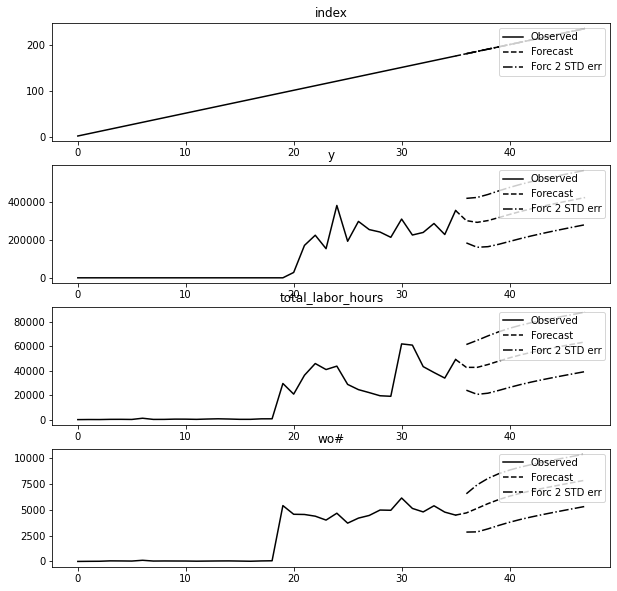

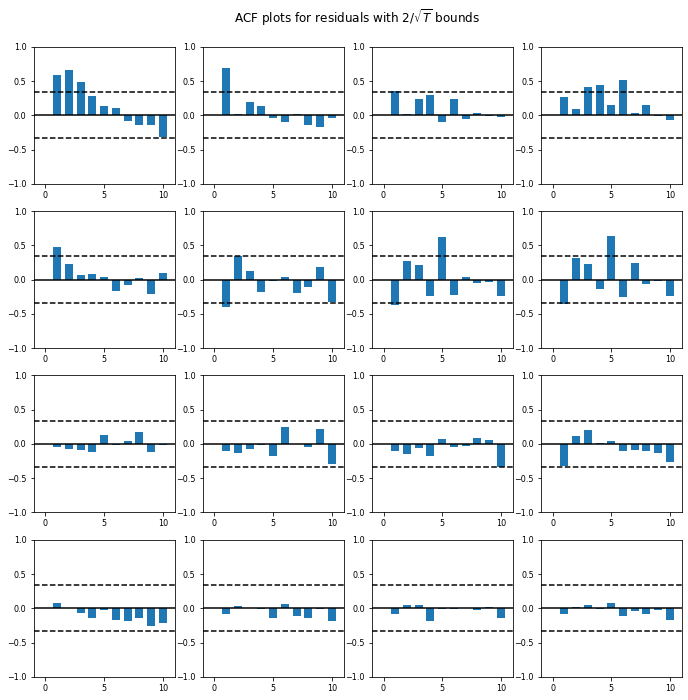

In [76]:
for store in portfolios:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = monthly_port_results[monthly_port_results["portfolio"] == store]
    
    vm = load_pickle("./models/monthly_port/var/{0}_var_model.pickle".format(store))
    fig1 = vm.plot_forecast(12)
    fig1.savefig("./images/monthly_port/var/{0}_forecast.png".format(store))
    
    fig2 = vm.plot_acorr()
    fig2.savefig("./images/monthly_port/var/{0}_acorr.png".format(store))

### Group the data by month and the Region so we can pass it to our model

In [78]:
monthly_region_agg = data_dropped_cols_ohe.groupby([pd.Grouper(key="date_time_created", freq="MS"), "region"])\
    .agg({"total_cost": 'sum', 
            "total_labor_hours": 'sum',
              "wo#": "count"}).reset_index().reset_index()

In [89]:
count = 0

def region_prophet_ts_reg(data):
    # Select the columns to pass to the prophet model
#     data.dropna()
    
    data = data.rename({"date_time_created": "ds",
                        "total_cost": "y"
                       }
                       , axis=1)
    #time_series_data = data[['ds','MedianPrice']]
    
    #time_series_data.columns = ["ds", "y"]
    store = data.region.iloc[0]    
    
    # Instantiate and fit the prophet model
    m = Prophet(yearly_seasonality=True)
    m.fit(data)
    
    # Save the model
    fname = "./models/region/{0}_model.json".format(store) 
    with open(fname, 'w') as fout:
        json.dump(model_to_json(m), fout)
    
    # Make a monthly dataframe to predict next 12 months (FY 2018)
    future = m.make_future_dataframe(periods=12,freq="MS")
    forecast_df = m.predict(future)
    forecast_df = forecast_df.set_index('ds')

    # joing the forecast and historical data together
    history_data = data.set_index('ds')
    results_df = forecast_df.join(history_data, how="left")
    #results_df = results_df.reset_index(level=0)
    results_df["yhat"] = results_df["yhat"].apply(lambda x: x if x >= 0 else 0)
#     results_df["portfolio"] = store
    global count
    count +=1
    global start_time
    print("Done.. {0}".format(count))
    print(f"Elapsed: {(time.time() - start_time)/ 60:.2f} mins")
    
    return results_df

In [90]:
start_time = time.time()
region_results = monthly_region_agg.groupby("region").apply(region_prophet_ts_reg)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 1
Elapsed: 0.03 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 2
Elapsed: 0.07 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 3
Elapsed: 0.12 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 4
Elapsed: 0.15 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 5
Elapsed: 0.19 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 6
Elapsed: 0.22 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.


Done.. 7
Elapsed: 0.27 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 8
Elapsed: 1.10 mins
Done.. 9
Elapsed: 1.14 mins


In [103]:
region_results.index.set_names(["store", "ds"], inplace=True)
region_results = region_results.reset_index().drop("store", axis=1)

In [104]:
region_results.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat,index,region,y,total_labor_hours,wo#
0,2011-01-01,-45910.852,-76329.679,91458.783,-45910.852,-45910.852,47440.314,47440.314,47440.314,47440.314,47440.314,47440.314,0.000,0.000,0.000,1529.461,0.000,Region 031,28213.940,2245.190,482.000
1,2011-02-01,-36805.231,-78399.029,83570.135,-36805.231,-36805.231,36781.282,36781.282,36781.282,36781.282,36781.282,36781.282,0.000,0.000,0.000,0.000,6.000,Region 031,35375.050,2139.593,436.000
2,2011-03-01,-28580.799,-76744.464,93679.471,-28580.799,-28580.799,38533.449,38533.449,38533.449,38533.449,38533.449,38533.449,0.000,0.000,0.000,9952.650,13.000,Region 031,39923.320,2280.170,477.000
3,2011-04-01,-19475.178,-95085.027,66876.110,-19475.178,-19475.178,3049.921,3049.921,3049.921,3049.921,3049.921,3049.921,0.000,0.000,0.000,0.000,21.000,Region 031,42927.820,1896.090,472.000
4,2011-05-01,-10663.287,-107390.266,59735.425,-10663.287,-10663.287,-16552.688,-16552.688,-16552.688,-16552.688,-16552.688,-16552.688,0.000,0.000,0.000,0.000,29.000,Region 031,41847.590,2213.210,565.000


In [105]:
regions = data_dropped_cols_ohe["region"].unique().tolist()
regions

['Region 9',
 'Region 032',
 'Region 033',
 'Region 10',
 'Region 031',
 'Region 13',
 'Region 15',
 'Region 14',
 'Region 33']

- plot the forecast and the forecast components

**************************************************
Region 9
**************************************************
**************************************************
Region 032
**************************************************
**************************************************
Region 033
**************************************************
**************************************************
Region 10
**************************************************
**************************************************
Region 031
**************************************************
**************************************************
Region 13
**************************************************
**************************************************
Region 15
**************************************************
**************************************************
Region 14
**************************************************
**************************************************
Region 33
*****************************************

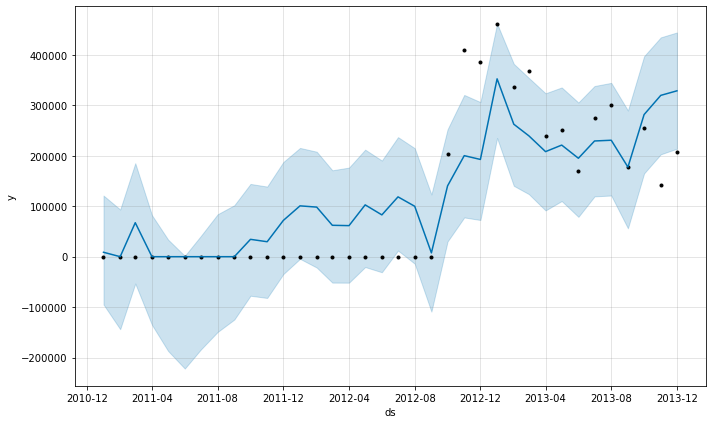

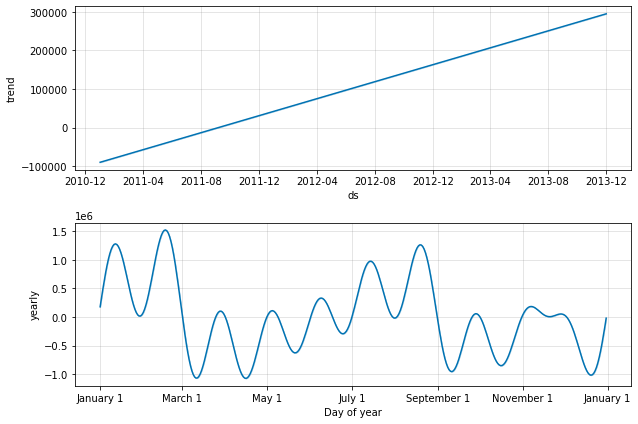

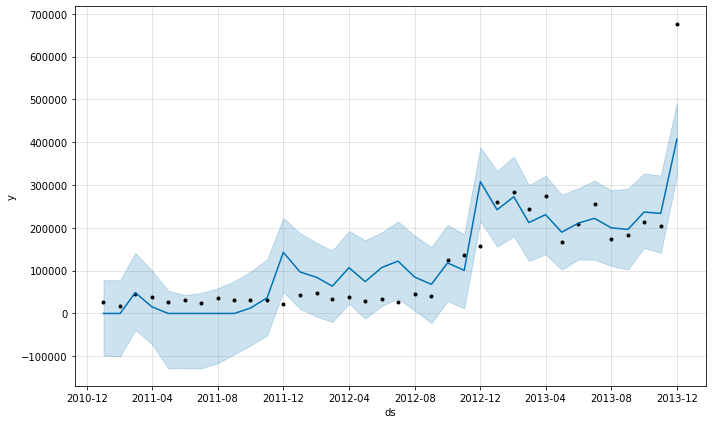

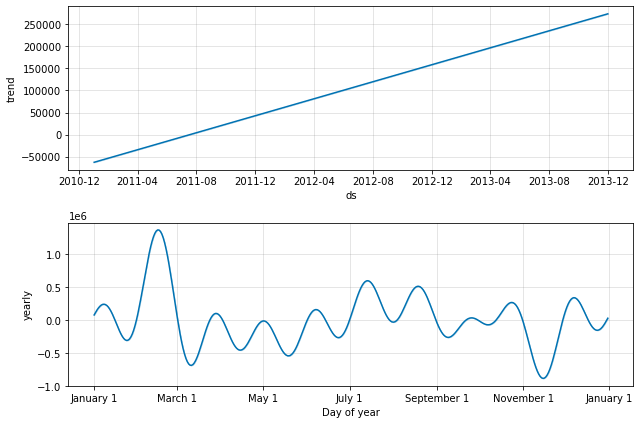

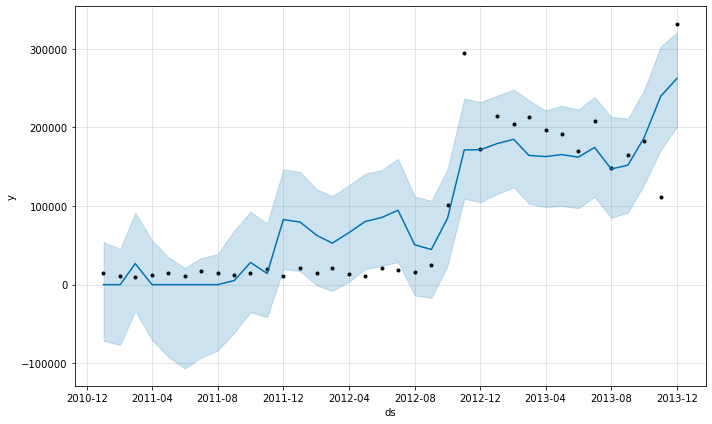

...

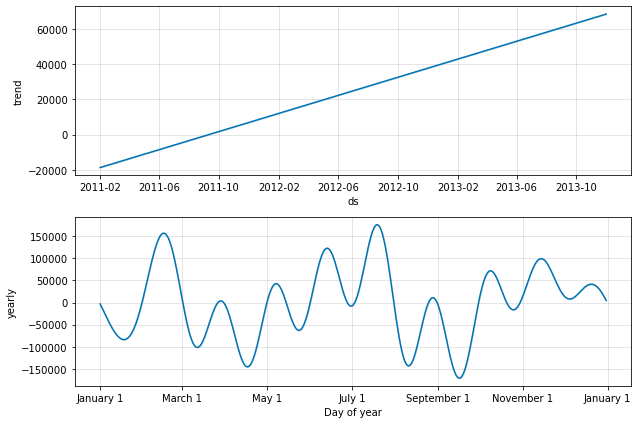

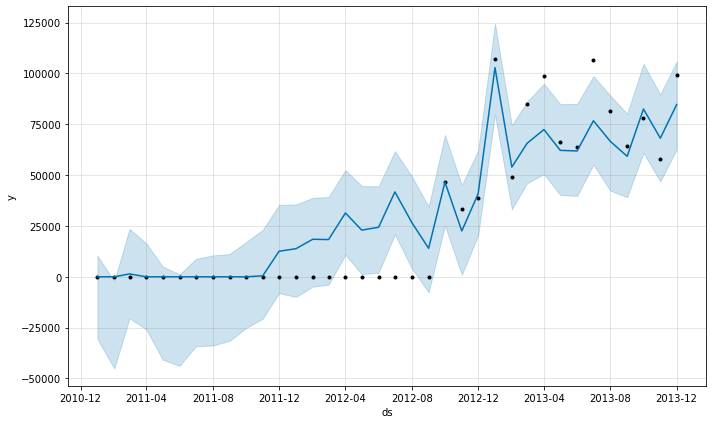

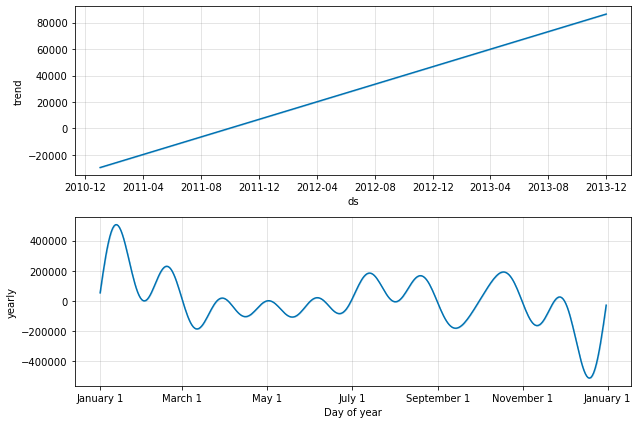

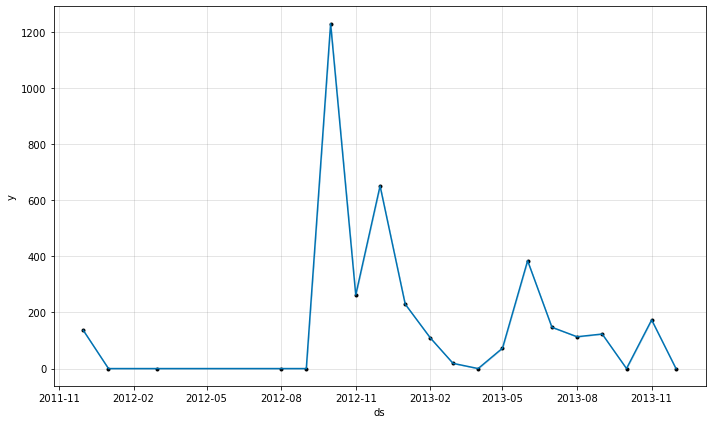

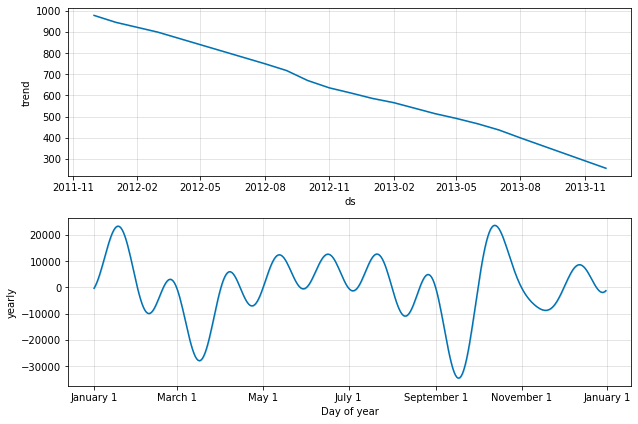

In [109]:
for store in regions:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = region_results[region_results["region"] == store]
    with open("./models/region/prophet/{0}_model.json".format(store), 'r') as fin:
        m = model_from_json(json.load(fin))  # Load model
        fig1 = m.plot(store_results)
        fig1.savefig("./images/region/prophet/{0}_forecast_plot.png".format(store))
        fig2 = m.plot_components(store_results)
        fig2.savefig("./images/region/prophet/{0}_forecast_components.png".format(store))
        

**************************************************
Region 9
**************************************************
**************************************************
Region 032
**************************************************
**************************************************
Region 033
**************************************************
**************************************************
Region 10
**************************************************
**************************************************
Region 031
**************************************************
**************************************************
Region 13
**************************************************
**************************************************
Region 15
**************************************************
**************************************************
Region 14
**************************************************
**************************************************
Region 33
*****************************************

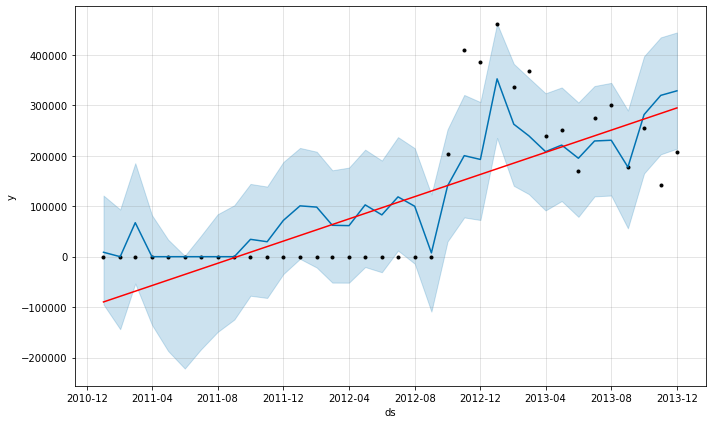

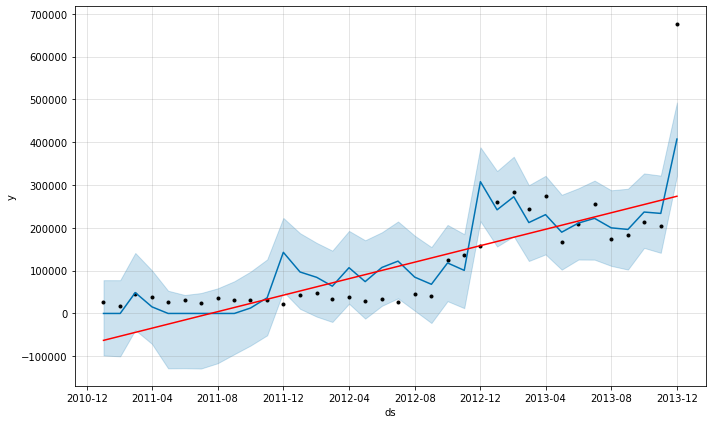

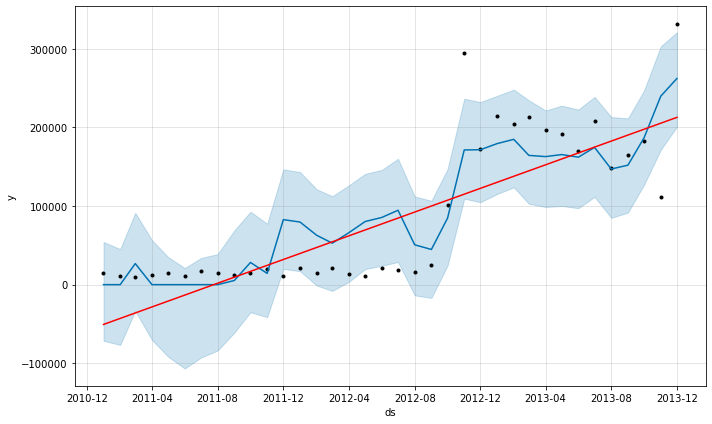

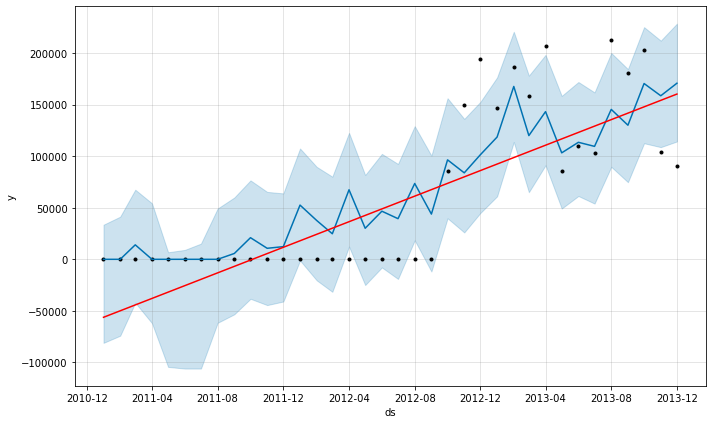

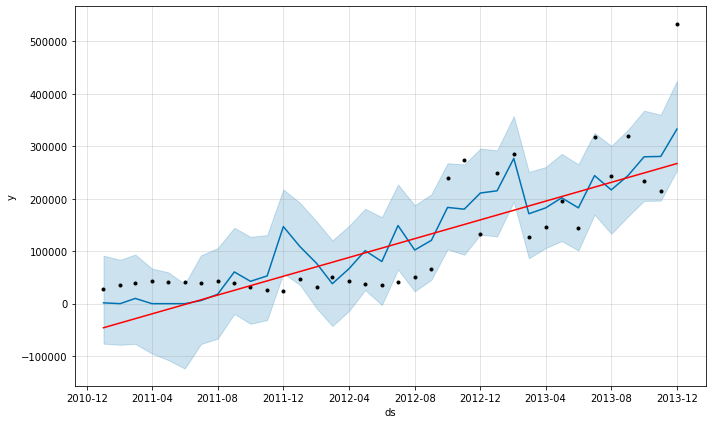

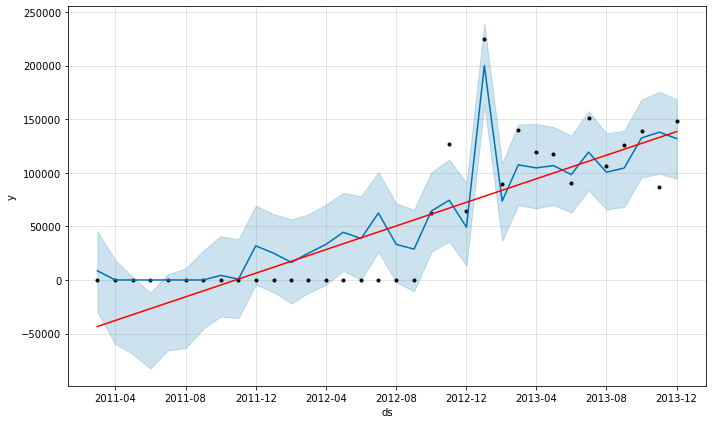

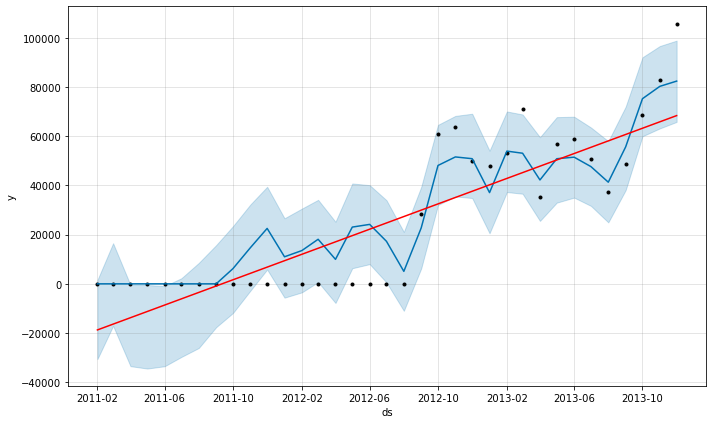

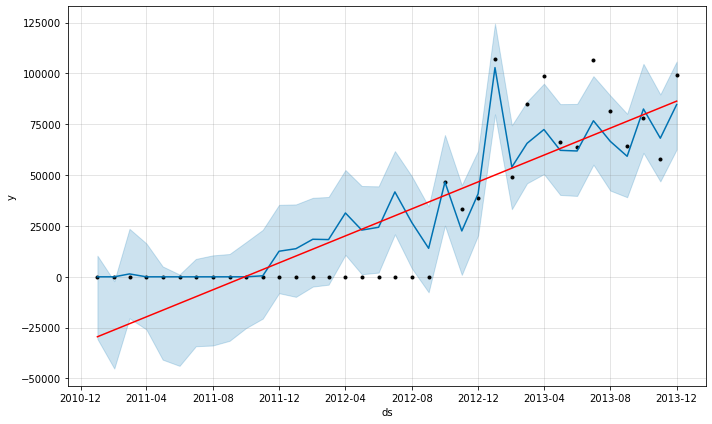

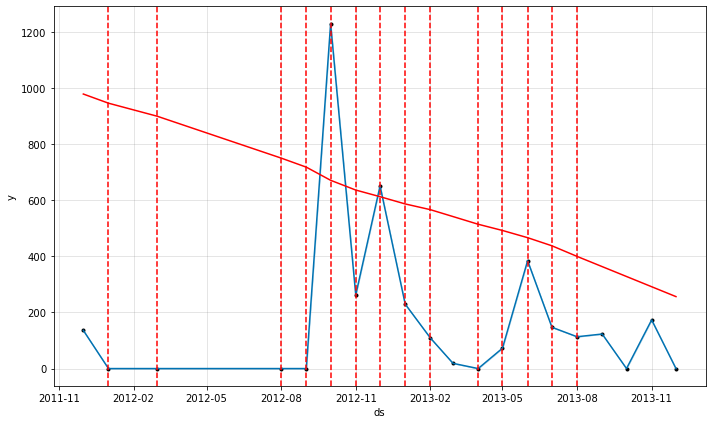

In [110]:
for store in regions:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = region_results[region_results["region"] == store]
    with open("./models/region/prophet/{0}_model.json".format(store), 'r') as fin:
        m = model_from_json(json.load(fin))  # Load model
        fig1 = m.plot(store_results)
        a = add_changepoints_to_plot(fig1.gca(), m, store_results)
        fig1.savefig("./images/region/prophet/{0}_forecast_plot_w_changepoints.png".format(store))
        
        

- evaluate the model and save the metrics

In [111]:
def region_eval_forecast(data):
    #print(data.head())
    data = data.dropna(how='any')
    data = data.replace(np.inf, 0).replace(-np.inf, 0)
    mean_fcst_vals = np.mean(data["y"])
    std_fcst_vals = np.std(data["yhat"])

    mse = mean_squared_error(data["y"], data["yhat"])
    rmse = np.sqrt(mse)
    rmse_pct = np.round(rmse / mean_fcst_vals, 6)
    results_dict = {
      "region": [data["region"].iloc[0]],
      "mse": [mse],
      "rmse": [rmse],
      "rmse_pct": [rmse_pct],
      "forecast_standard_deviation": [std_fcst_vals]
    }

    return pd.DataFrame.from_dict(results_dict)

In [112]:
region_results_errors = region_results.groupby("region").apply(region_eval_forecast)
region_results_errors

,,region,mse,rmse,rmse_pct,forecast_standard_deviation
region,,,,,,
Region 031,0,Region 031,3851041049.175,62056.757,0.497,96920.964
Region 032,0,Region 032,4264285662.882,65301.498,0.551,103567.632
Region 033,0,Region 033,2136950547.824,46227.162,0.515,76565.353
Region 10,0,Region 10,1657920335.055,40717.568,0.662,58019.407
Region 13,0,Region 13,671392281.666,25911.239,0.492,51612.867
Region 14,0,Region 14,236493276.588,15378.338,0.514,30638.581
Region 15,0,Region 15,129322683.298,11372.013,0.432,25043.728
Region 33,0,Region 33,0.000,0.000,0.000,287.503
Region 9,0,Region 9,7110016765.618,84320.915,0.726,107568.150


In [69]:
region_results_errors.to_csv("./results/region/prophet/result_error_metrics.csv", index=False)

In [113]:
region_results_errors.to_csv("./results/region/prophet/forecast.csv", index=False)

### Build a Vector Auto Regression (VAR) model to forecast total cost and labor hours

In [114]:
count = 0
def region_var_ts(data):
    data = data.rename({"date_time_created": "ds",
                        "total_cost": "y"
                       }
                       , axis=1)
    #time_series_data = data[['ds','MedianPrice']]
    data = data.set_index("ds")
    
    #time_series_data.columns = ["ds", "y"]
    store = data.region.iloc[0] 
    ts_data = data.drop("region", axis=1)
    model = VAR(endog=ts_data)
    model_fit = model.fit()
    
    model_fit.save("./models/region/var/{0}_var_model.pickle".format(store))
    
    predictions = model_fit.forecast(model_fit.y, steps=12)
    
    
    pred = pd.DataFrame(index=range(0,len(predictions)),columns=[ts_data.columns])
    for j in range(0,len(ts_data.columns)):
        for i in range(0, len(predictions)):
            pred.iloc[i][j] = predictions[i][j]
    global count
    count +=1
    global start_time
    print("Done.. {0}".format(count))
    print(f"Elapsed: {(time.time() - start_time)/ 60:.2f} mins")
    
    return pred

In [115]:
start_time = time.time()
var_region_results = monthly_region_agg.groupby("region").apply(region_var_ts).reset_index().drop("level_1", axis=1)

Done.. 1
Elapsed: 0.00 mins
Done.. 2
Elapsed: 0.00 mins
Done.. 3
Elapsed: 0.00 mins
Done.. 4
Elapsed: 0.00 mins
Done.. 5
Elapsed: 0.00 mins
Done.. 6
Elapsed: 0.00 mins
Done.. 7
Elapsed: 0.00 mins
Done.. 8
Elapsed: 0.00 mins
Done.. 9
Elapsed: 0.00 mins


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\base\wrapper.py:34: FutureWarning: y is a deprecated alias for endog, will be removed in version 0.11.0
  obj = getattr(results, attr)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3

In [116]:
var_region_results.to_csv("./results/region/var/forecast.csv", index=False)

In [117]:
var_region_results

,region,index,y,total_labor_hours,wo#
0,Region 031,305.152,311933.529,23355.403,2853.600
1,Region 031,314.474,288019.059,27329.673,3229.143
2,Region 031,323.903,302960.721,31173.861,3568.791
3,Region 031,333.413,320644.635,33667.903,3807.740
4,Region 031,342.990,335706.043,35385.786,3984.694
5,Region 031,352.629,348685.189,36766.407,4131.034
6,Region 031,362.328,360541.060,38014.243,4263.207
7,Region 031,372.085,371863.391,39211.762,4388.954
8,Region 031,381.901,382953.464,40391.247,4511.879
9,Region 031,391.774,393958.587,41565.881,4633.711


- print model summary to text files

In [118]:
for store in regions:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = var_region_results[var_region_results["region"] == store]
    
    vm = load_pickle("./models/region/var/{0}_var_model.pickle".format(store))
    with open("./results/region/var/{0}_model_summary.txt".format(store), 'w') as f:
        print(vm.summary(),file=f)

**************************************************
Region 9
**************************************************
**************************************************
Region 032
**************************************************
**************************************************
Region 033
**************************************************
**************************************************
Region 10
**************************************************
**************************************************
Region 031
**************************************************
**************************************************
Region 13
**************************************************
**************************************************
Region 15
**************************************************
**************************************************
Region 14
**************************************************
**************************************************
Region 33
*****************************************

- save forecast and autocorrelation plots 

**************************************************
Region 9
**************************************************
**************************************************
Region 032
**************************************************
**************************************************
Region 033
**************************************************
**************************************************
Region 10
**************************************************
**************************************************
Region 031
**************************************************
**************************************************
Region 13
**************************************************
**************************************************
Region 15
**************************************************
**************************************************
Region 14
**************************************************
**************************************************
Region 33
*****************************************

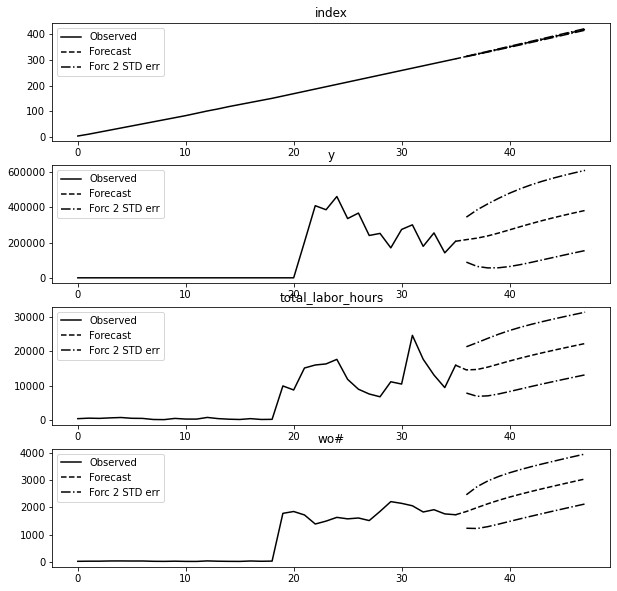

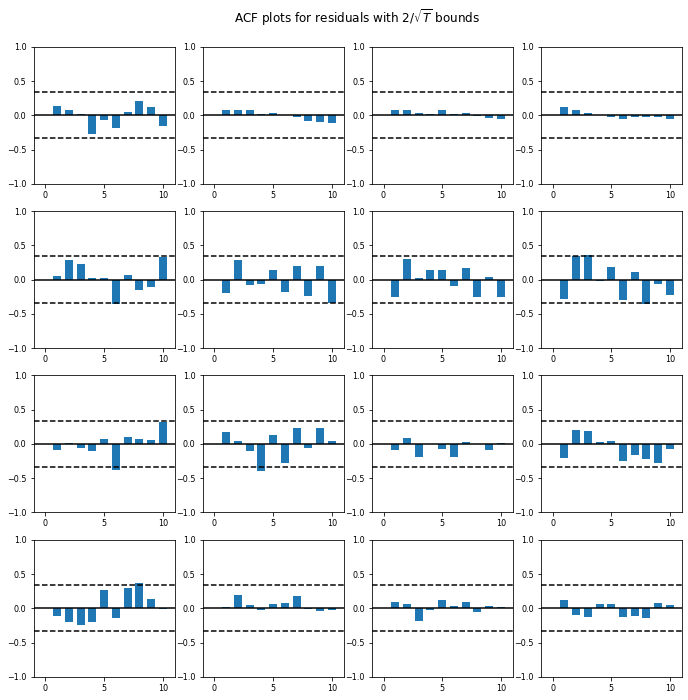

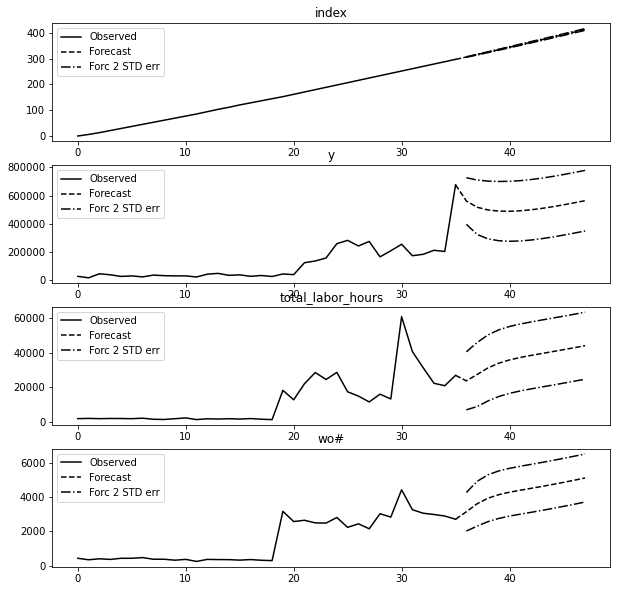

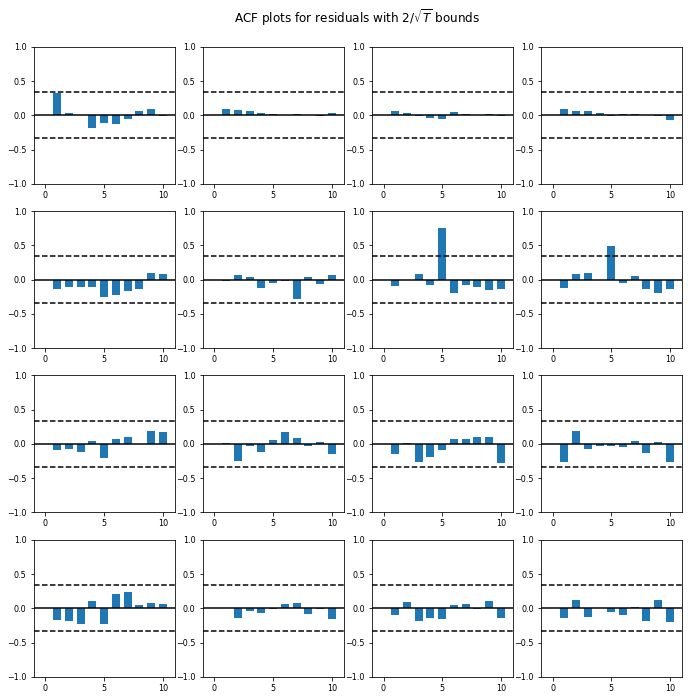

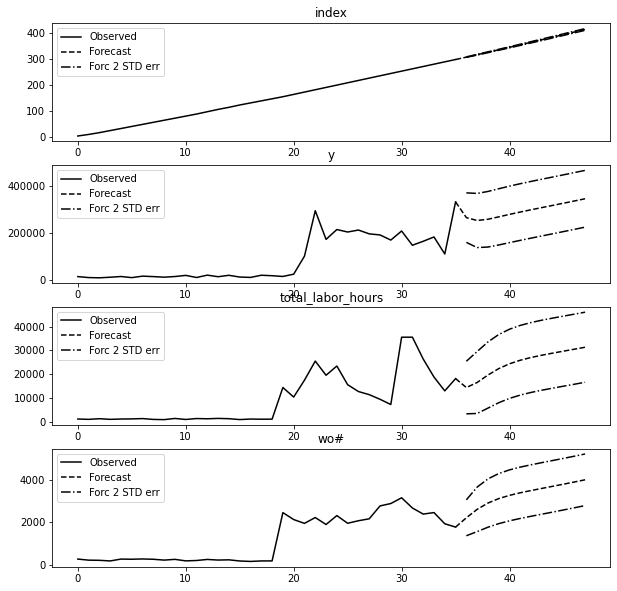

...

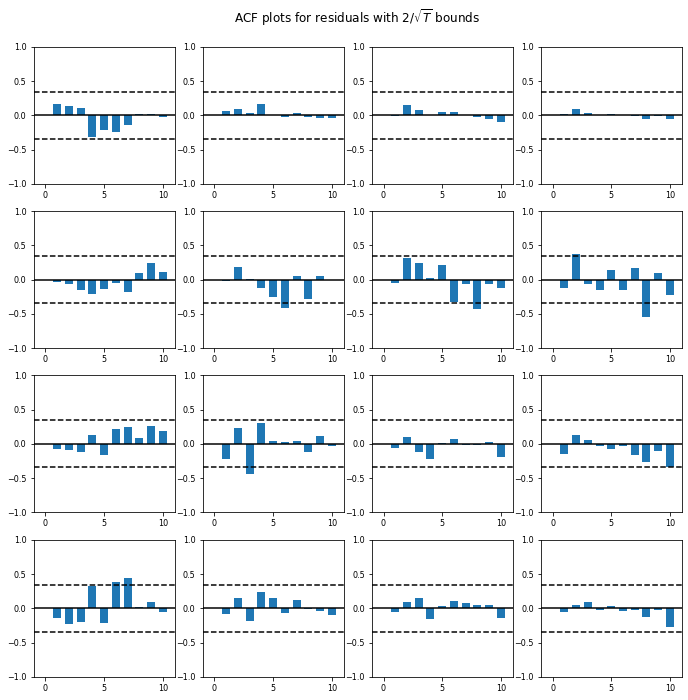

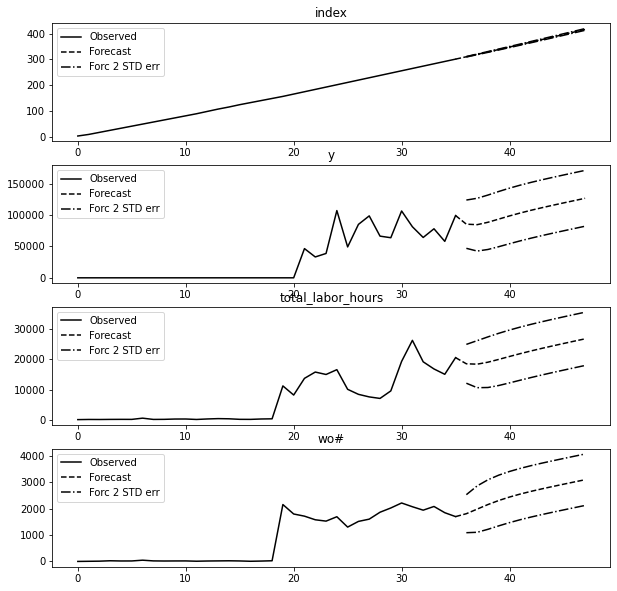

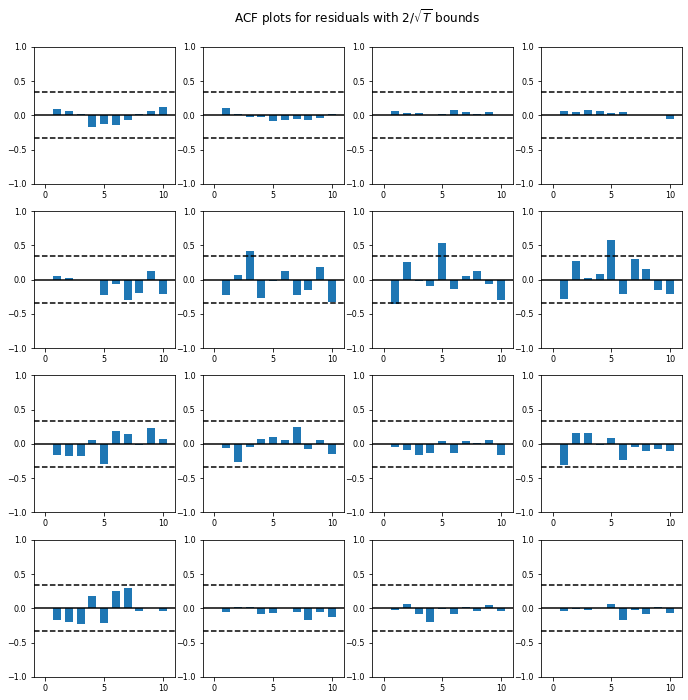

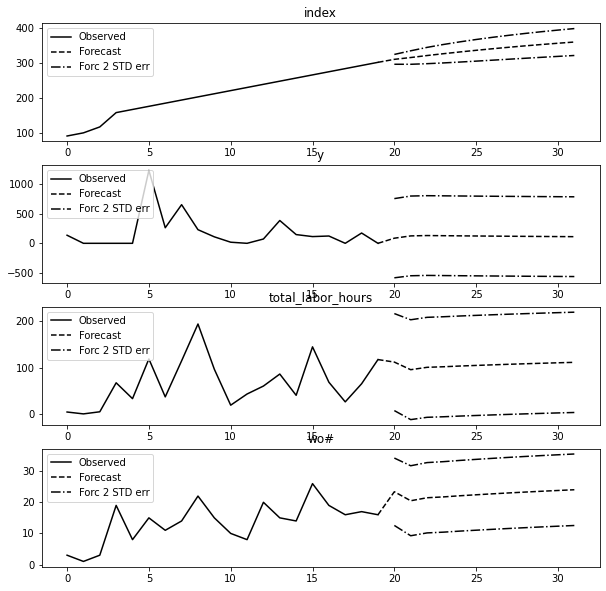

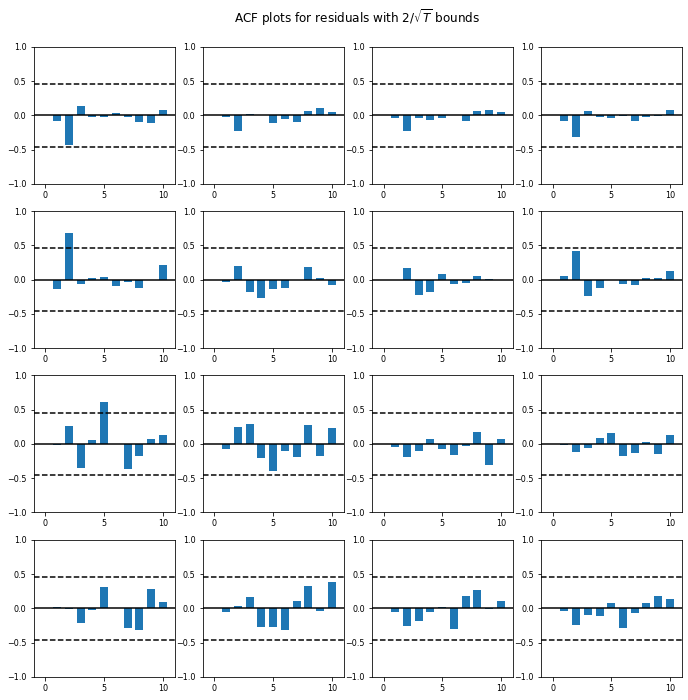

In [129]:
for store in regions:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = var_region_results[var_region_results["region"] == store]
    
    vm = load_pickle("./models/region/var/{0}_var_model.pickle".format(store))
    fig1 = vm.plot_forecast(12)
    for ax in fig1.axes:
        ax.legend(loc="upper left")
    fig1.savefig("./images/region/var/{0}_forecast.png".format(store))
    
    fig2 = vm.plot_acorr()
    fig2.savefig("./images/region/var/{0}_acorr.png".format(store))

### Group the data by month and the Specialty so we can pass it to our model

In [161]:
monthly_specialty_agg = data_dropped_cols_ohe.groupby([pd.Grouper(key="date_time_created", freq="MS"), "specialty"])\
    .agg({"total_cost": 'sum', 
            "total_labor_hours": 'sum',
              "wo#": "count"}).reset_index()

In [163]:
count = 0

def specialty_prophet_ts_reg(data):
    # Select the columns to pass to the prophet model
    if len(data.dropna()) < 3:
        print("skipping...", data.specialty)
        return None 

    data = data.rename({"date_time_created": "ds",
                        "total_cost": "y"
                       }
                       , axis=1)
    #time_series_data = data[['ds','MedianPrice']]
    
    #time_series_data.columns = ["ds", "y"]
    store = data.specialty.iloc[0]    
    
    # Instantiate and fit the prophet model
    m = Prophet(yearly_seasonality=True)
    m.fit(data)
    
    # Save the model
    fname = "./models/specialty/prophet/{0}_model.json".format(store) 
    with open(fname, 'w') as fout:
        json.dump(model_to_json(m), fout)
    
    # Make a monthly dataframe to predict next 12 months (FY 2018)
    future = m.make_future_dataframe(periods=12,freq="MS")
    forecast_df = m.predict(future)
    forecast_df = forecast_df.set_index('ds')

    # joing the forecast and historical data together
    history_data = data.set_index('ds')
    results_df = forecast_df.join(history_data, how="left")
    #results_df = results_df.reset_index(level=0)
    results_df["yhat"] = results_df["yhat"].apply(lambda x: x if x >= 0 else 0)
#     results_df["portfolio"] = store
    global count
    count +=1
    global start_time
    print("Done.. {0}".format(count))
    print(f"Elapsed: {(time.time() - start_time)/ 60:.2f} mins")
    
    return results_df

In [164]:
start_time = time.time()
specialty_results = monthly_specialty_agg.groupby("specialty").apply(specialty_prophet_ts_reg)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 21.


Done.. 1
Elapsed: 0.03 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 2
Elapsed: 0.06 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.


Done.. 3
Elapsed: 0.09 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 4
Elapsed: 0.13 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 5
Elapsed: 0.15 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 1.


Done.. 6
Elapsed: 0.18 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 5.


Done.. 7
Elapsed: 0.20 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 8
Elapsed: 0.23 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 1.


Done.. 9
Elapsed: 0.25 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 5.


Done.. 10
Elapsed: 0.27 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 11
Elapsed: 0.31 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 12
Elapsed: 0.34 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Done.. 13
Elapsed: 0.36 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 14.


Done.. 14
Elapsed: 2.81 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 15
Elapsed: 2.84 mins
skipping... 801    Electrical - General Repairs
Name: specialty, dtype: object


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 16
Elapsed: 2.86 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 17
Elapsed: 2.90 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 18
Elapsed: 2.94 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 19
Elapsed: 2.98 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 8.


Done.. 20
Elapsed: 3.01 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 21
Elapsed: 3.09 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 5.


Done.. 22
Elapsed: 3.11 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 23
Elapsed: 3.22 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 5.


Done.. 24
Elapsed: 3.25 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 25
Elapsed: 3.28 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 26
Elapsed: 3.30 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 5.


Done.. 27
Elapsed: 3.33 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 28
Elapsed: 3.35 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 29
Elapsed: 3.38 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 30
Elapsed: 3.40 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 31
Elapsed: 3.43 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 32
Elapsed: 3.47 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 5.


Done.. 33
Elapsed: 3.49 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 34
Elapsed: 3.51 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 35
Elapsed: 3.55 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 2.


Done.. 36
Elapsed: 3.57 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 37
Elapsed: 3.59 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 38
Elapsed: 3.61 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 5.


Done.. 39
Elapsed: 3.63 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 2.


Done.. 40
Elapsed: 3.66 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 41
Elapsed: 3.68 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 42
Elapsed: 3.70 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 43
Elapsed: 3.74 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Done.. 44
Elapsed: 3.77 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 45
Elapsed: 3.79 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 46
Elapsed: 3.82 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 21.


Done.. 47
Elapsed: 3.86 mins
skipping... 61     MUSAK
830    MUSAK
Name: specialty, dtype: object


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 48
Elapsed: 3.90 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 49
Elapsed: 3.94 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 50
Elapsed: 3.98 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 51
Elapsed: 4.02 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


Done.. 52
Elapsed: 4.05 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 1.


Done.. 53
Elapsed: 4.09 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 2.


Done.. 54
Elapsed: 4.11 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 1.


Done.. 55
Elapsed: 4.14 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 56
Elapsed: 4.16 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 57
Elapsed: 4.19 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 58
Elapsed: 4.21 mins
skipping... 840    Plumbing - Exterior
904    Plumbing - Exterior
Name: specialty, dtype: object


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 59
Elapsed: 4.25 mins
skipping... 842    Power Outages
906    Power Outages
Name: specialty, dtype: object


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 60
Elapsed: 4.28 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 24.


Done.. 61
Elapsed: 4.32 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 62
Elapsed: 4.35 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.


Done.. 63
Elapsed: 4.43 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.


Done.. 64
Elapsed: 4.45 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 65
Elapsed: 5.30 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 66
Elapsed: 5.32 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 16.


Done.. 67
Elapsed: 5.35 mins
skipping... 1099    Snow and Ice
1162    Snow and Ice
Name: specialty, dtype: object


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.


Done.. 68
Elapsed: 6.11 mins
Done.. 69
Elapsed: 6.13 mins


In [165]:
specialty_results.index.set_names(["store", "ds"], inplace=True)
specialty_results = specialty_results.reset_index().drop("store", axis=1)

In [166]:
specialty_results.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat,specialty,y,total_labor_hours,wo#
0,2011-01-01,-25960.127,-29501.370,18828.225,-25960.127,-25960.127,21045.782,21045.782,21045.782,21045.782,21045.782,21045.782,0.000,0.000,0.000,0.000,ALARMS,0.000,3.500,5.000
1,2011-02-01,-23623.983,-32783.122,12512.186,-23623.983,-23623.983,13019.482,13019.482,13019.482,13019.482,13019.482,13019.482,0.000,0.000,0.000,0.000,ALARMS,540.490,13.000,7.000
2,2011-03-01,-21513.917,-14705.055,32672.387,-21513.917,-21513.917,31047.818,31047.818,31047.818,31047.818,31047.818,31047.818,0.000,0.000,0.000,9533.901,ALARMS,32.010,2.000,1.000
3,2011-04-01,-19177.772,-29508.413,17388.641,-19177.772,-19177.772,12775.356,12775.356,12775.356,12775.356,12775.356,12775.356,0.000,0.000,0.000,0.000,ALARMS,0.000,5.500,3.000
4,2011-05-01,-16916.987,-27921.941,23011.055,-16916.987,-16916.987,15593.315,15593.315,15593.315,15593.315,15593.315,15593.315,0.000,0.000,0.000,0.000,ALARMS,0.000,1.000,1.000


In [167]:
specialties = data_dropped_cols_ohe["specialty"].unique().tolist()
specialties

['OPERATIONS REQUEST',
 'CARPENTRY',
 'CLEANING',
 'FLOOR REPAIR',
 'DOOR REPAIR',
 'General Maintenance',
 'Refrigeration Repair',
 'Fire Prevention - Alarms',
 'HVAC',
 'FIRE PREVENTION',
 'ALARMS',
 'REFRIGERATION',
 'ELEVATOR REPAIR',
 'LIGHTING',
 'Food Equipment',
 'ELECTRICAL',
 'Front End - Technology',
 'SIGN REPAIR',
 'GAS STATION',
 'LOCKSMITH',
 'HVAC Repair',
 'Door - Overhead, Rollup',
 'STORE EXTERIOR',
 'BUILDING',
 'MILLWRIGHT',
 'Front End - Mart Carts',
 'Jacks - Powered',
 'Door - Perimeter Alarm',
 'FRONT END',
 'PLUMBING',
 'Front End - Register Lanes',
 'Compactor, Baler, Docks',
 'FOOD EQUIP',
 'PAINTING',
 'Roofing',
 'Janitorial - Cart Cleaning',
 'Flooring Repairs',
 'Door - Other Door Repairs',
 'GLASS REPAIR',
 'Plumbing - Drains',
 'Legacy Metrix Specialty',
 'Fire Prevention - Sprinkler',
 'Fire Prevention - Extinguisher',
 'PLUMBING-DRAINS',
 'ROOF REPAIR',
 'Welding and Fabrication',
 'Janitorial - Floor Care',
 'Janitorial - Window Cleaning',
 'PEST CO

- plot the forecast and the forecast components

**************************************************
OPERATIONS REQUEST
**************************************************
**************************************************
CARPENTRY
**************************************************
**************************************************
CLEANING
**************************************************
**************************************************
FLOOR REPAIR
**************************************************
**************************************************
DOOR REPAIR
**************************************************
**************************************************
General Maintenance
**************************************************
**************************************************
Refrigeration Repair
**************************************************
**************************************************
Fire Prevention - Alarms
**************************************************
**************************************************
HVAC

C:\Users\Alec\anaconda3\lib\site-packages\prophet\plot.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(facecolor='w', figsize=figsize)


**************************************************
REFRIGERATION
**************************************************
**************************************************
ELEVATOR REPAIR
**************************************************
**************************************************
LIGHTING
**************************************************
**************************************************
Food Equipment
**************************************************
**************************************************
ELECTRICAL
**************************************************
**************************************************
Front End - Technology
**************************************************
**************************************************
SIGN REPAIR
**************************************************
**************************************************
GAS STATION
**************************************************
**************************************************
LOCKSMITH
***********

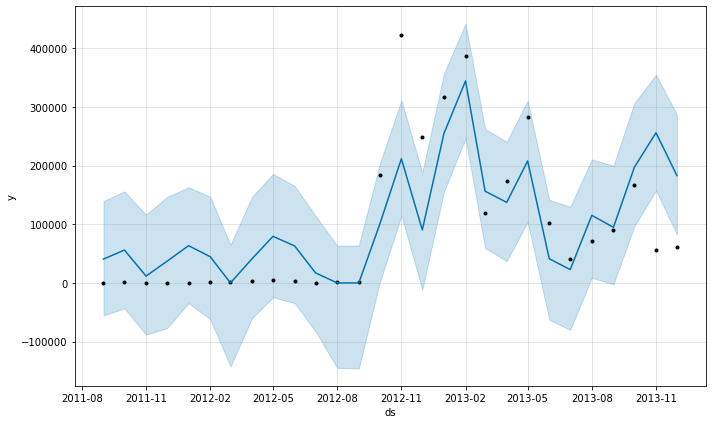

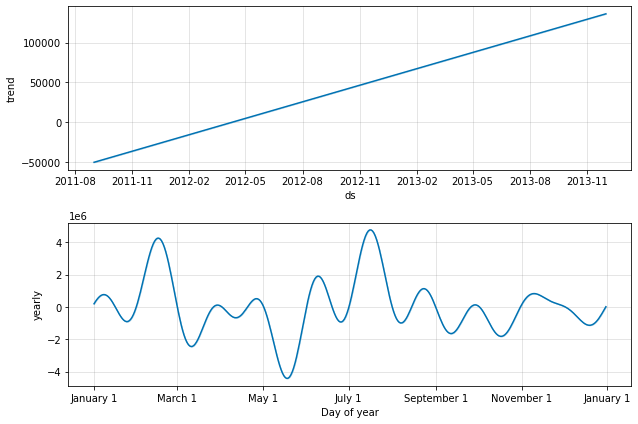

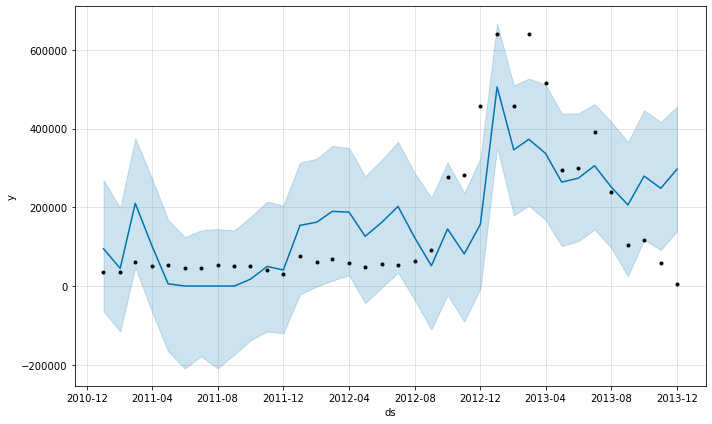

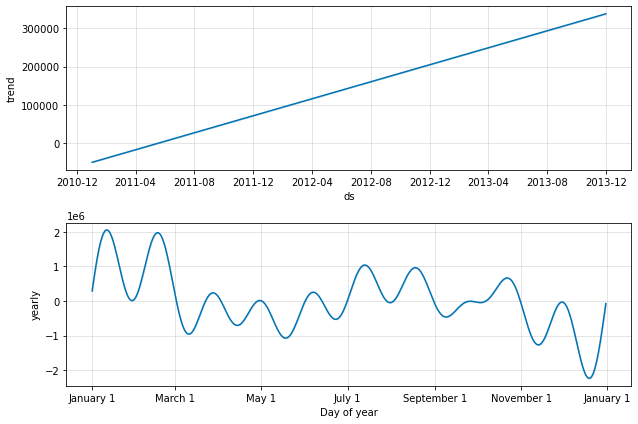

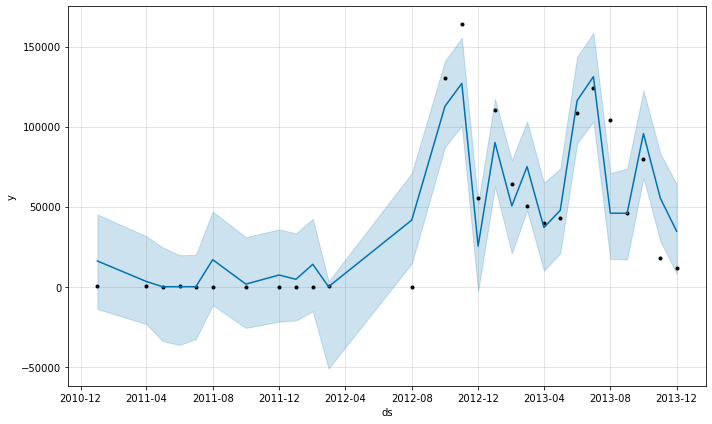

...

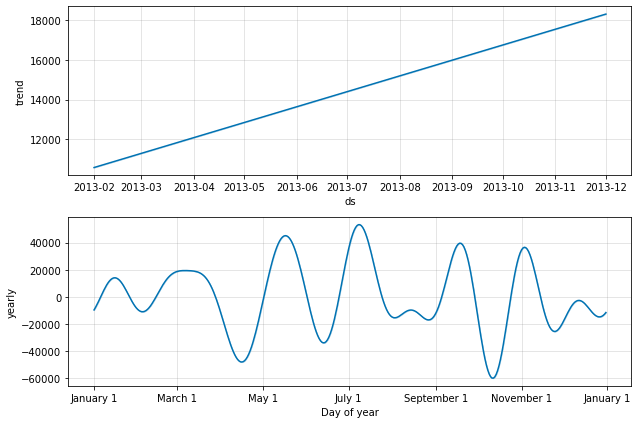

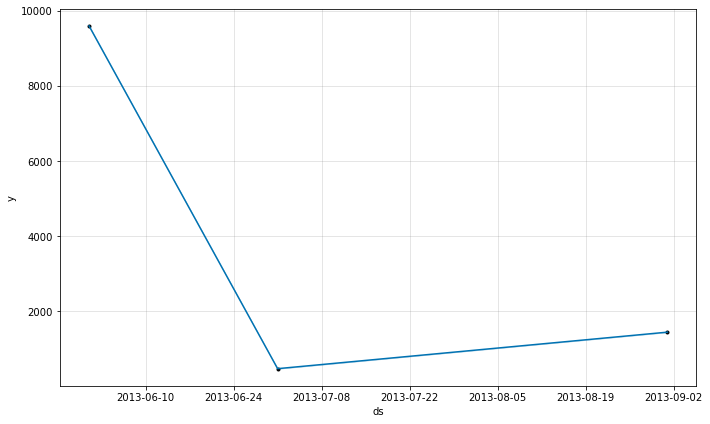

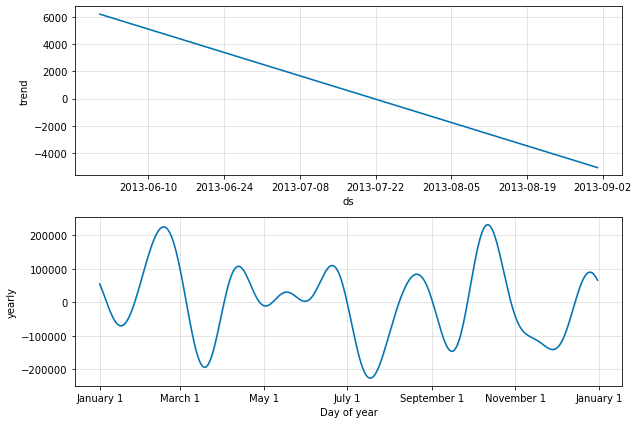

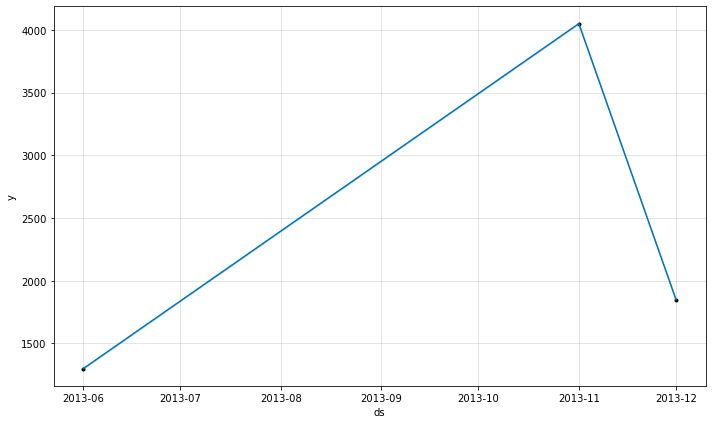

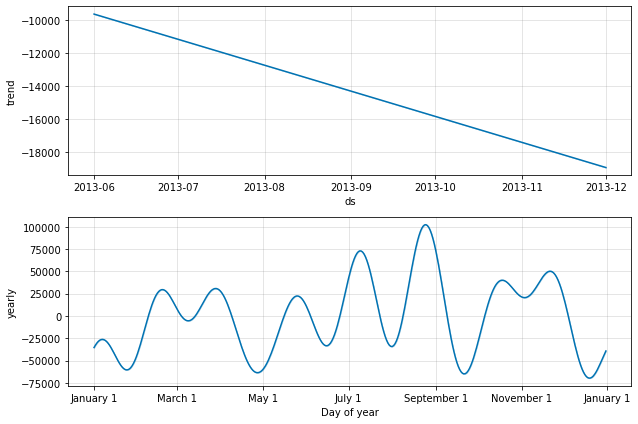

In [168]:
for store in specialties:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = specialty_results[specialty_results["specialty"] == store]
    try:    
        with open("./models/specialty/prophet/{0}_model.json".format(store), 'r') as fin:
            m = model_from_json(json.load(fin))  # Load model
            fig1 = m.plot(store_results)
            fig1.savefig("./images/specialty/prophet/{0}_forecast_plot.png".format(store))
            fig2 = m.plot_components(store_results)
            fig2.savefig("./images/specialty/prophet/{0}_forecast_components.png".format(store))
    except OSError as e:
        print(e)

**************************************************
OPERATIONS REQUEST
**************************************************
**************************************************
CARPENTRY
**************************************************
**************************************************
CLEANING
**************************************************
**************************************************
FLOOR REPAIR
**************************************************
**************************************************
DOOR REPAIR
**************************************************
**************************************************
General Maintenance
**************************************************
**************************************************
Refrigeration Repair
**************************************************
**************************************************
Fire Prevention - Alarms
**************************************************
**************************************************
HVAC

C:\Users\Alec\anaconda3\lib\site-packages\prophet\plot.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(facecolor='w', figsize=figsize)


**************************************************
Door - Overhead, Rollup
**************************************************
**************************************************
STORE EXTERIOR
**************************************************
**************************************************
BUILDING
**************************************************
**************************************************
MILLWRIGHT
**************************************************
**************************************************
Front End - Mart Carts
**************************************************
**************************************************
Jacks - Powered
**************************************************
**************************************************
Door - Perimeter Alarm
**************************************************
**************************************************
FRONT END
**************************************************
**************************************************
PL

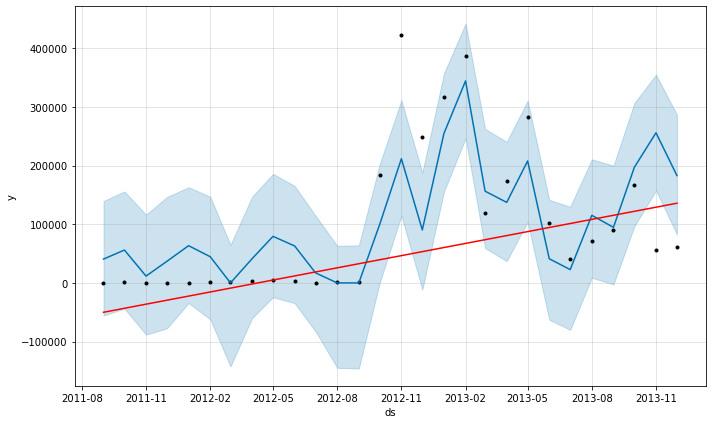

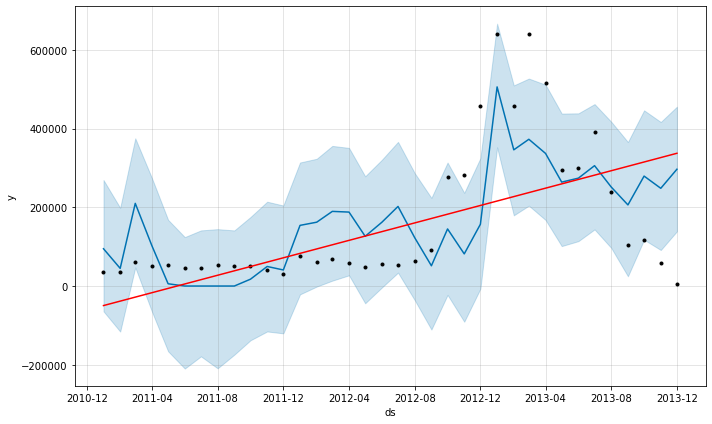

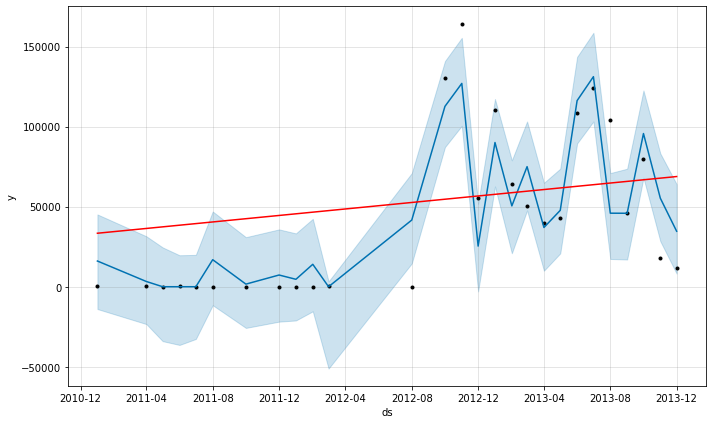

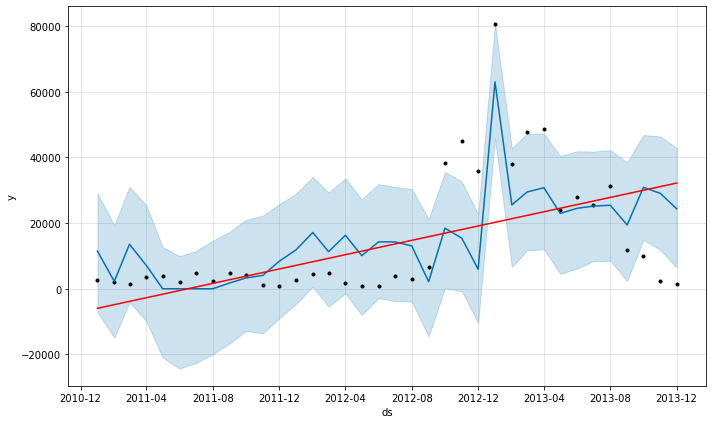

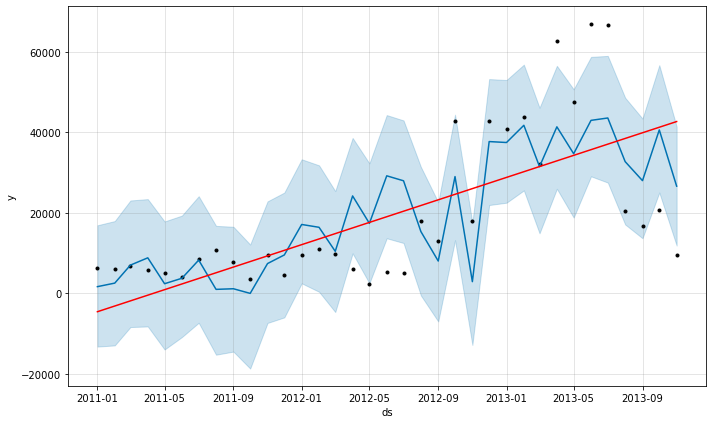

...

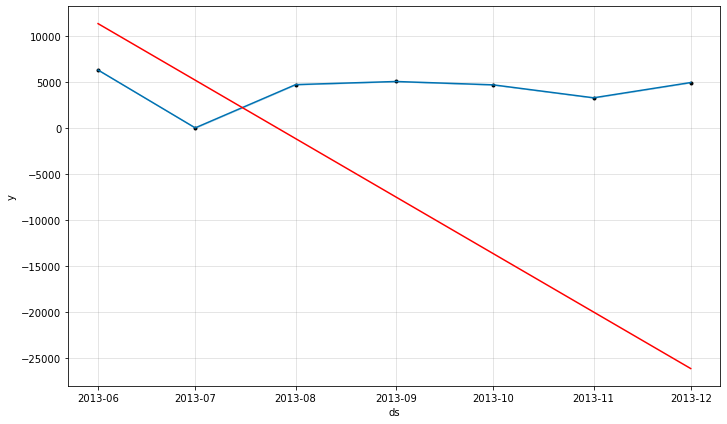

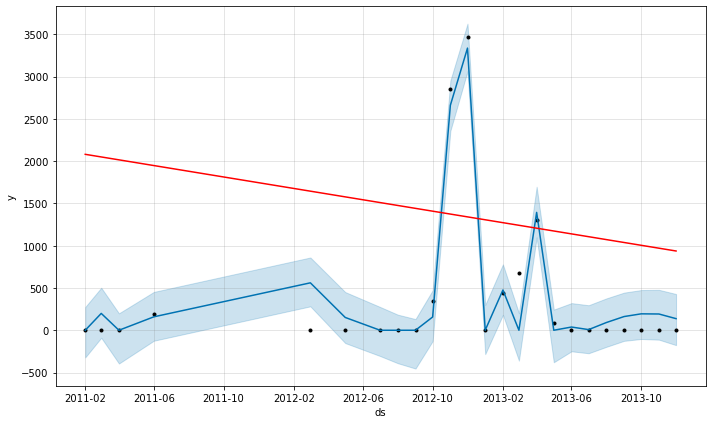

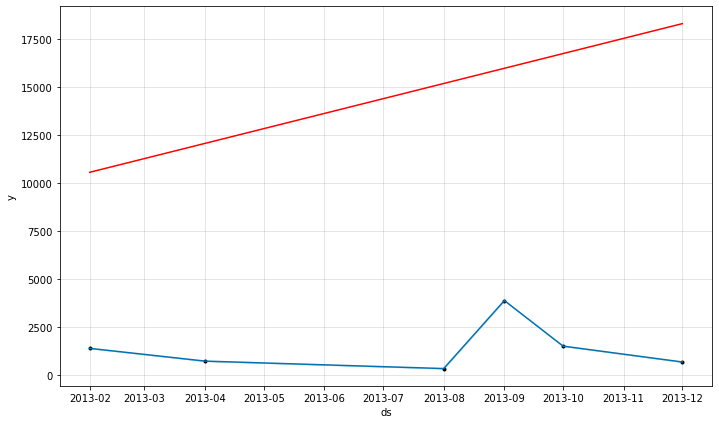

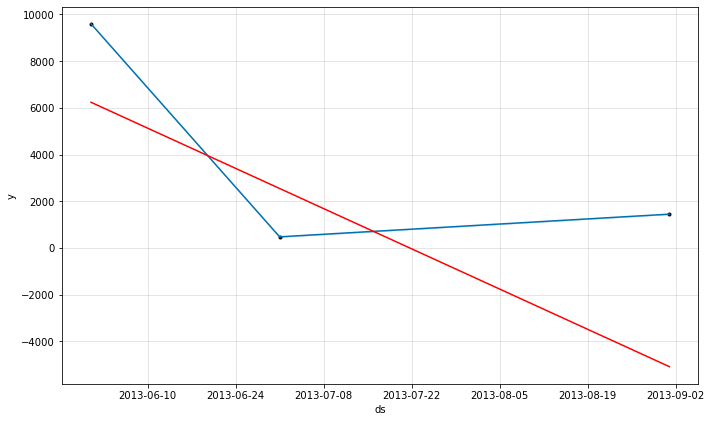

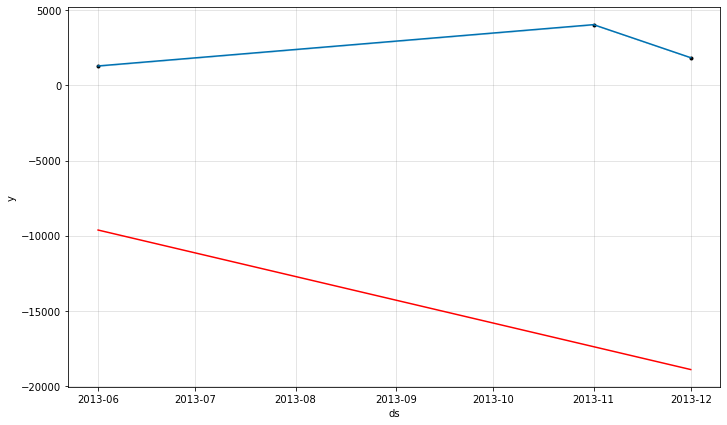

In [169]:
for store in specialties:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = specialty_results[specialty_results["specialty"] == store]
    try:
        with open("./models/specialty/prophet/{0}_model.json".format(store), 'r') as fin:
            m = model_from_json(json.load(fin))  # Load model
            fig1 = m.plot(store_results)
            a = add_changepoints_to_plot(fig1.gca(), m, store_results)
            fig1.savefig("./images/specialty/prophet/{0}_forecast_plot_w_changepoints.png".format(store))
    except OSError as e:
        print(e)
        

- evaluate the model and save the metrics

In [170]:
def specialty_eval_forecast(data):
    #print(data.head())
    data = data.dropna(how='any')
    data = data.replace(np.inf, 0).replace(-np.inf, 0)
    mean_fcst_vals = np.mean(data["y"])
    std_fcst_vals = np.std(data["yhat"])

    mse = mean_squared_error(data["y"], data["yhat"])
    rmse = np.sqrt(mse)
    rmse_pct = np.round(rmse / mean_fcst_vals, 6)
    results_dict = {
      "specialty": [data["specialty"].iloc[0]],
      "mse": [mse],
      "rmse": [rmse],
      "rmse_pct": [rmse_pct],
      "forecast_standard_deviation": [std_fcst_vals]
    }

    return pd.DataFrame.from_dict(results_dict)

In [171]:
specialty_results_errors = specialty_results.groupby("specialty").apply(specialty_eval_forecast)
specialty_results_errors

C:\Users\Alec\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in double_scalars
  # Remove the CWD from sys.path while we load stuff.
C:\Users\Alec\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in double_scalars
  # Remove the CWD from sys.path while we load stuff.
C:\Users\Alec\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in double_scalars
  # Remove the CWD from sys.path while we load stuff.
C:\Users\Alec\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in double_scalars
  # Remove the CWD from sys.path while we load stuff.
C:\Users\Alec\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in double_scalars
  # Remove the CWD from sys.path while we load stuff.


,,specialty,mse,rmse,rmse_pct,forecast_standard_deviation
specialty,,,,,,
ALARMS,0,ALARMS,337548272.808,18372.487,0.900,21909.962
BUILDING,0,BUILDING,211925052.315,14557.646,0.535,35493.013
CARPENTRY,0,CARPENTRY,16154789550.730,127101.493,0.774,123169.479
CLEANING,0,CLEANING,446772801.686,21137.001,0.495,41886.300
"Compactor, Baler, Docks",0,"Compactor, Baler, Docks",0.000,0.000,NaN,0.000
DOOR REPAIR,0,DOOR REPAIR,147685688.185,12152.600,0.616,14671.829
Door - Auto,0,Door - Auto,0.000,0.000,NaN,0.000
Door - Other Door Repairs,0,Door - Other Door Repairs,0.000,0.000,0.000,48180.747
"Door - Overhead, Rollup",0,"Door - Overhead, Rollup",0.000,0.000,NaN,0.000


In [172]:
specialty_results_errors.to_csv("./results/specialty/prophet/result_error_metrics.csv", index=False)

In [173]:
specialty_results_errors.to_csv("./results/specialty/prophet/forecast.csv", index=False)

### Build a Vector Auto Regression (VAR) model to forecast total cost and labor hours

In [230]:
count = 0
def specialty_var_ts(data):
    if len(data) < 3:
        print("skipping...", data.specialty)
        return None 
    
    data = data.rename({"date_time_created": "ds",
                        "total_cost": "y"
                       }
                       , axis=1)
    #time_series_data = data[['ds','MedianPrice']]
    data = data.set_index("ds")
    
    #time_series_data.columns = ["ds", "y"]
    try:
        store = data.specialty.iloc[0] 
        ts_data = data.drop("specialty", axis=1)
        model = VAR(endog=ts_data)
        model_fit = model.fit()
        model_fit.save("./models/specialty/var/{0}_var_model.pickle".format(store))

        predictions = model_fit.forecast(model_fit.y, steps=12)


        pred = pd.DataFrame(index=range(0,len(predictions)),columns=[ts_data.columns])
        for j in range(0,len(ts_data.columns)):
            for i in range(0, len(predictions)):
                pred.iloc[i][j] = predictions[i][j]
        global count
        count +=1
        global start_time
        print("Done.. {0}".format(count))
        print(f"Elapsed: {(time.time() - start_time)/ 60:.2f} mins")

        return pred
    except ValueError as e:
        print("skipping...", data.specialty)
        
    

In [231]:
start_time = time.time()
var_specialty_results = monthly_specialty_agg.groupby("specialty").apply(specialty_var_ts).reset_index().drop("level_1", axis=1)

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', Valu

Done.. 1
Elapsed: 0.00 mins
Done.. 2
Elapsed: 0.00 mins
Done.. 3
Elapsed: 0.00 mins
Done.. 4
Elapsed: 0.00 mins
Done.. 5
Elapsed: 0.00 mins
Done.. 6
Elapsed: 0.00 mins
Done.. 7
Elapsed: 0.00 mins
Done.. 8
Elapsed: 0.00 mins
Done.. 9
Elapsed: 0.00 mins
Done.. 10

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has 


Elapsed: 0.00 mins
Done.. 11
Elapsed: 0.00 mins
Done.. 12
Elapsed: 0.00 mins
Done.. 13
Elapsed: 0.01 mins
Done.. 14
Elapsed: 0.01 mins
Done.. 15
Elapsed: 0.01 mins
skipping... 801    Electrical - General Repairs
Name: specialty, dtype: object
Done.. 16
Elapsed: 0.01 mins
Done.. 17
Elapsed: 0.01 mins
Done.. 18
Elapsed: 0.01 mins


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so i

Done.. 19
Elapsed: 0.01 mins
Done.. 20
Elapsed: 0.01 mins
Done.. 21
Elapsed: 0.01 mins
Done.. 22
Elapsed: 0.01 mins
Done.. 23
Elapsed: 0.01 mins
Done.. 24
Elapsed: 0.01 mins
Done.. 25
Elapsed: 0.01 mins
Done.. 26

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\t


Elapsed: 0.01 mins
Done.. 27
Elapsed: 0.01 mins
Done.. 28
Elapsed: 0.01 mins
Done.. 29
Elapsed: 0.01 mins
Done.. 30
Elapsed: 0.01 mins
Done.. 31
Elapsed: 0.01 mins
Done.. 32
Elapsed: 0.01 mins
Done.. 33
Elapsed: 0.01 mins
Done.. 34
Elapsed: 0.01 mins


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\t

Done.. 35
Elapsed: 0.01 mins
Done.. 36
Elapsed: 0.01 mins
Done.. 37
Elapsed: 0.02 mins
Done.. 38
Elapsed: 0.02 mins
Done.. 39
Elapsed: 0.02 mins
Done.. 40
Elapsed: 0.02 mins
Done.. 41
Elapsed: 0.02 mins
Done.. 42
Elapsed: 0.02 mins
Done.. 43
Elapsed: 0.02 mins


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forec

Done.. 44
Elapsed: 0.02 mins
Done.. 45
Elapsed: 0.02 mins
Done.. 46
Elapsed: 0.02 mins
Done.. 47
Elapsed: 0.02 mins
skipping... 61     MUSAK
830    MUSAK
Name: specialty, dtype: object
Done.. 48
Elapsed: 0.02 mins
Done.. 49
Elapsed: 0.02 mins
Done.. 50

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has 


Elapsed: 0.02 mins
Done.. 51
Elapsed: 0.02 mins
Done.. 52
Elapsed: 0.02 mins
Done.. 53
Elapsed: 0.02 mins
skipping... ds
2013-06-01    Parking Lot - Line Painting
2013-11-01    Parking Lot - Line Painting
2013-12-01    Parking Lot - Line Painting
Name: specialty, dtype: object
Done.. 54
Elapsed: 0.02 mins
Done.. 55
Elapsed: 0.02 mins
Done.. 56
Elapsed: 0.02 mins
Done.. 57

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will b


Elapsed: 0.02 mins
skipping... 840    Plumbing - Exterior
904    Plumbing - Exterior
Name: specialty, dtype: object
Done.. 58
Elapsed: 0.03 mins
skipping... 842    Power Outages
906    Power Outages
Name: specialty, dtype: object
Done.. 59
Elapsed: 0.03 mins
Done.. 60
Elapsed: 0.03 mins
Done.. 61
Elapsed: 0.03 mins
Done.. 62
Elapsed: 0.03 mins
Done.. 63
Elapsed: 0.03 mins
Done.. 64
Elapsed: 0.03 mins
Done.. 65
Elapsed: 0.03 mins
Done.. 66

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\t


Elapsed: 0.03 mins
skipping... 1099    Snow and Ice
1162    Snow and Ice
Name: specialty, dtype: object
Done.. 67
Elapsed: 0.03 mins
Done.. 68
Elapsed: 0.03 mins


In [232]:
var_specialty_results.to_csv("./results/specialty/var/forecast.csv", index=False)

In [233]:
var_specialty_results

,specialty,y,total_labor_hours,wo#
0,ALARMS,-210.323,-5.623,2.060
1,ALARMS,358.229,8.553,5.691
2,ALARMS,2476.314,33.582,11.276
3,ALARMS,4927.720,59.443,17.029
4,ALARMS,7210.274,82.668,22.220
...,...,...,...,...
811,Welding and Fabrication,0.000,448.186,25.036
812,Welding and Fabrication,0.000,403.521,21.944
813,Welding and Fabrication,0.000,448.818,22.383
814,Welding and Fabrication,0.000,496.885,24.709


- print model summary to text files

In [239]:
for store in specialties:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = var_specialty_results[var_specialty_results["specialty"] == store]
    try:
        vm = load_pickle("./models/specialty/var/{0}_var_model.pickle".format(store))
        with open("./results/specialty/var/{0}_model_summary.txt".format(store), 'w') as f:
            print(vm.summary(),file=f)
    except Exception as e:
        print(e)

**************************************************
OPERATIONS REQUEST
**************************************************
**************************************************
CARPENTRY
**************************************************
**************************************************
CLEANING
**************************************************
**************************************************
FLOOR REPAIR
**************************************************
**************************************************
DOOR REPAIR
**************************************************
**************************************************
General Maintenance
**************************************************
**************************************************
Refrigeration Repair
**************************************************
Singular matrix
**************************************************
Fire Prevention - Alarms
**************************************************
***************************************

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:1379: RuntimeWarning: invalid value encountered in multiply
  return self.sigma_u * self.df_resid / self.nobs


- save forecast and autocorrelation plots 

**************************************************
OPERATIONS REQUEST
**************************************************
**************************************************
CARPENTRY
**************************************************
**************************************************
CLEANING
**************************************************
**************************************************
FLOOR REPAIR
**************************************************
**************************************************
DOOR REPAIR
**************************************************
**************************************************
General Maintenance
**************************************************
**************************************************
Refrigeration Repair
**************************************************
**************************************************
Fire Prevention - Alarms
**************************************************
**************************************************
HVAC

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\plotting.py:65: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10, 10))


**************************************************
REFRIGERATION
**************************************************
**************************************************
ELEVATOR REPAIR
**************************************************
**************************************************
LIGHTING
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Food Equipment
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
ELECTRICAL
**************************************************
**************************************************
Front End - Technology
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
SIGN REPAIR
**************************************************
**************************************************
GAS STATION
**************************************************
**************************************************
LOCKSMITH
**************************************************
**************************************************
HVAC Repair
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Door - Overhead, Rollup
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
STORE EXTERIOR
**************************************************
**************************************************
BUILDING
**************************************************
**************************************************
MILLWRIGHT
**************************************************
**************************************************
Front End - Mart Carts
**************************************************
**************************************************
Jacks - Powered
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Door - Perimeter Alarm
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:1164: RuntimeWarning: invalid value encountered in sqrt
  sigma = np.sqrt(self._forecast_vars(steps))
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
FRONT END
**************************************************
**************************************************
PLUMBING
**************************************************
**************************************************
Front End - Register Lanes
**************************************************
**************************************************
Compactor, Baler, Docks
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
FOOD EQUIP
**************************************************
**************************************************
PAINTING
**************************************************
**************************************************
Roofing
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Janitorial - Cart Cleaning
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Flooring Repairs
**************************************************
**************************************************
Door - Other Door Repairs
**************************************************
**************************************************
GLASS REPAIR
**************************************************
**************************************************
Plumbing - Drains
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Legacy Metrix Specialty
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Fire Prevention - Sprinkler
**************************************************
**************************************************
Fire Prevention - Extinguisher
**************************************************
**************************************************
PLUMBING-DRAINS
**************************************************
**************************************************
ROOF REPAIR
**************************************************
**************************************************
Welding and Fabrication
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Janitorial - Floor Care
**************************************************
**************************************************
Janitorial - Window Cleaning
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:1164: RuntimeWarning: invalid value encountered in sqrt
  sigma = np.sqrt(self._forecast_vars(steps))


**************************************************
PEST CONTROL
**************************************************
**************************************************
Plumbing - EVAC
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Front End - Cart Corral
**************************************************
**************************************************
Door - Auto
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:1164: RuntimeWarning: invalid value encountered in sqrt
  sigma = np.sqrt(self._forecast_vars(steps))
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
ELEVATOR
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Jacks - Manual
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:1164: RuntimeWarning: invalid value encountered in sqrt
  sigma = np.sqrt(self._forecast_vars(steps))


**************************************************
Energy Management
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Landscaping
**************************************************
**************************************************
VENTILATION
**************************************************
**************************************************
Gas Station Equipment
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
ELEC-LOW VOLTAGE
**************************************************
**************************************************
ENERGY MGMT
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:2306: RuntimeWarning: invalid value encountered in true_divide
  return acovs / np.outer(sd, sd)
C:\Users\Alec\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


**************************************************
Pressure Washing
**************************************************
**************************************************
Snow and Ice
**************************************************
[Errno 2] No such file or directory: './models/specialty/var/Snow and Ice_var_model.pickle'
**************************************************
STARBUCKS
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:1114: RuntimeWarning: invalid value encountered in matmul
  var = phi @ self.sigma_u @ phi.T


**************************************************
Fire Prevention - Ansul
**************************************************
**************************************************
Parking Lot - Lot Sweeping
**************************************************


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:1164: RuntimeWarning: invalid value encountered in sqrt
  sigma = np.sqrt(self._forecast_vars(steps))


**************************************************
Plumbing - General Repairs
**************************************************
**************************************************
Electrical - General Repairs
**************************************************
[Errno 2] No such file or directory: './models/specialty/var/Electrical - General Repairs_var_model.pickle'
**************************************************
PLUMBING-EXTERIOR
**************************************************
**************************************************
Life Safety
**************************************************
**************************************************
Plumbing - Exterior
**************************************************
[Errno 2] No such file or directory: './models/specialty/var/Plumbing - Exterior_var_model.pickle'
**************************************************
Power Outages
**************************************************
[Errno 2] No such file or directory: './models/specialty/var/

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:1164: RuntimeWarning: invalid value encountered in sqrt
  sigma = np.sqrt(self._forecast_vars(steps))


**************************************************
Parking Lot - Line Painting
**************************************************
[Errno 2] No such file or directory: './models/specialty/var/Parking Lot - Line Painting_var_model.pickle'


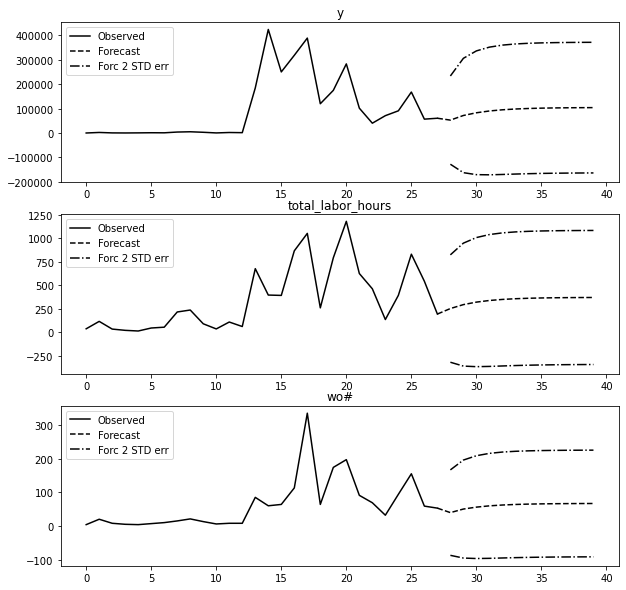

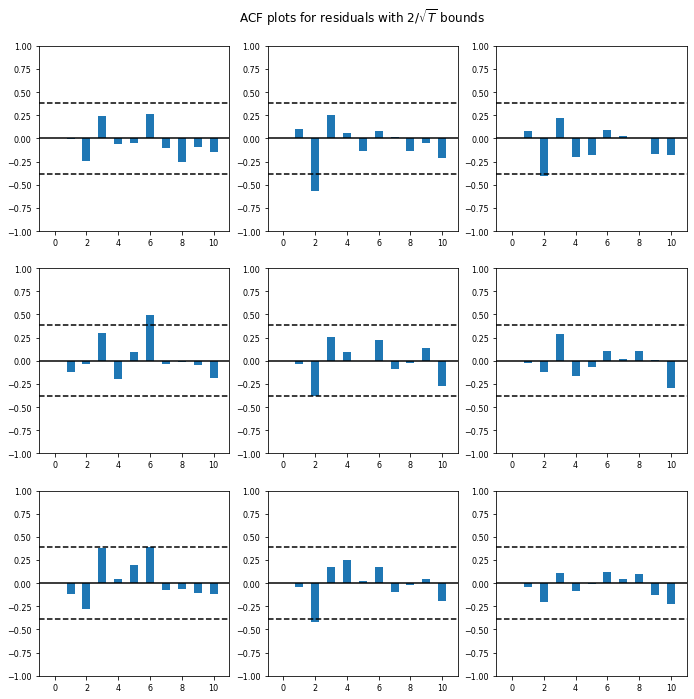

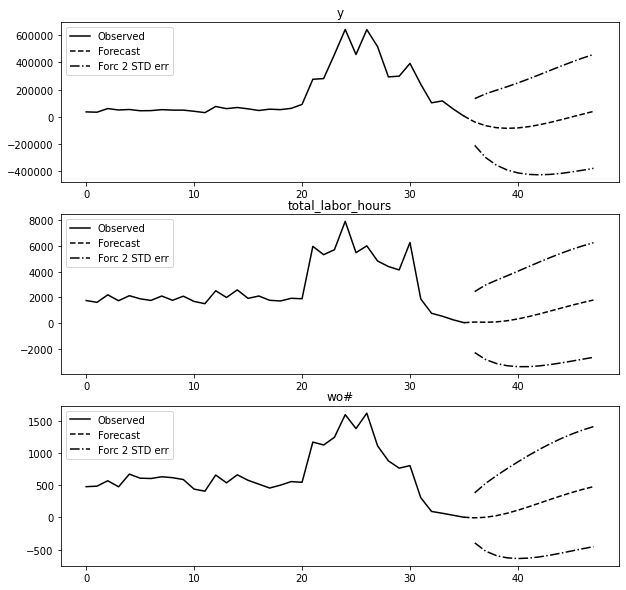

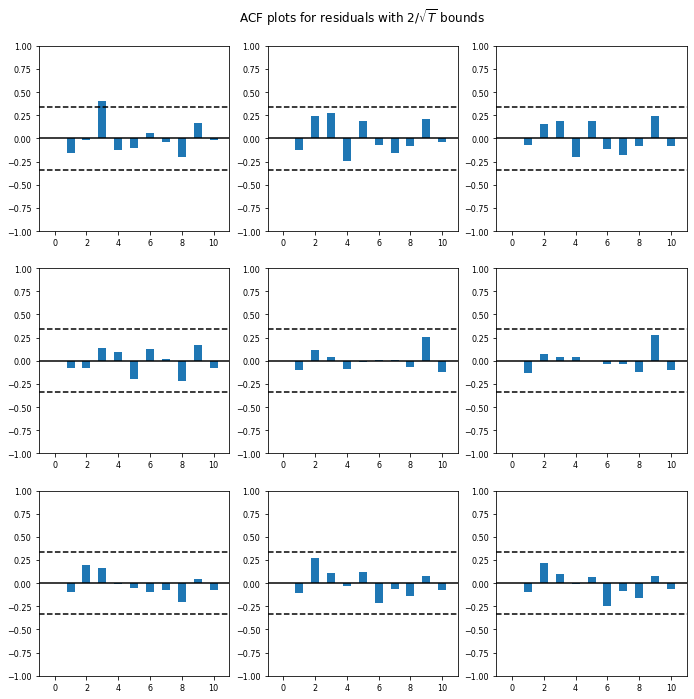

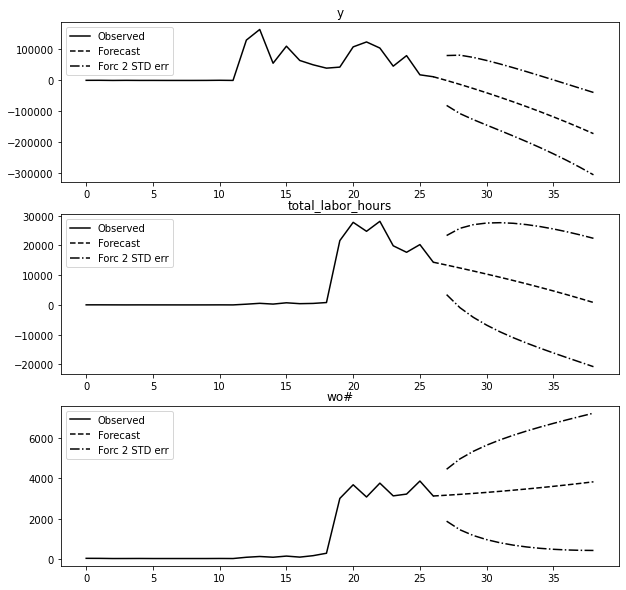

...

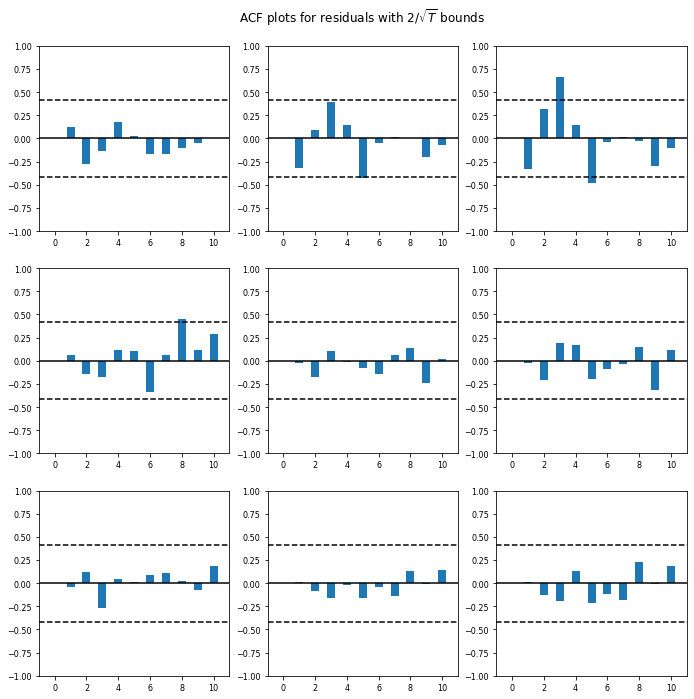

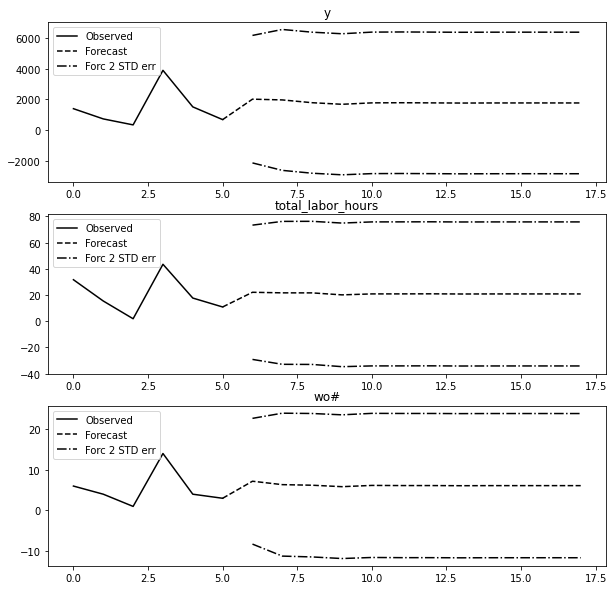

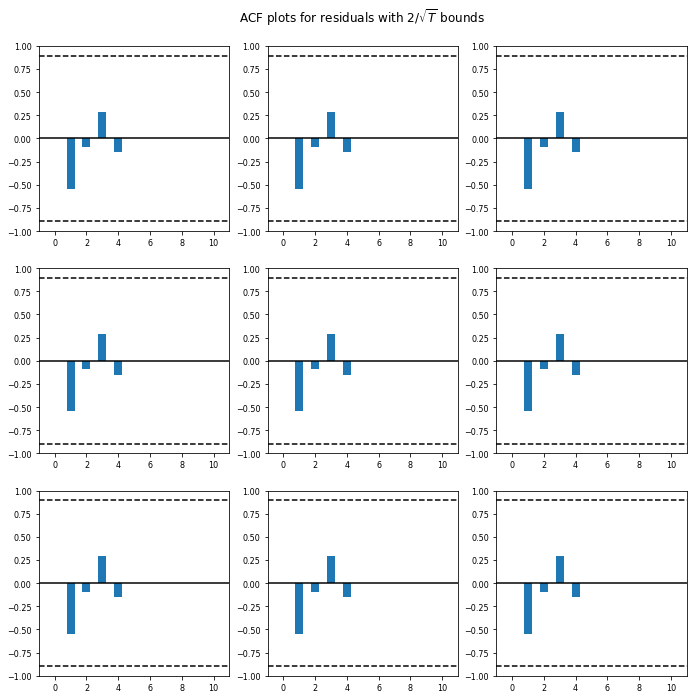

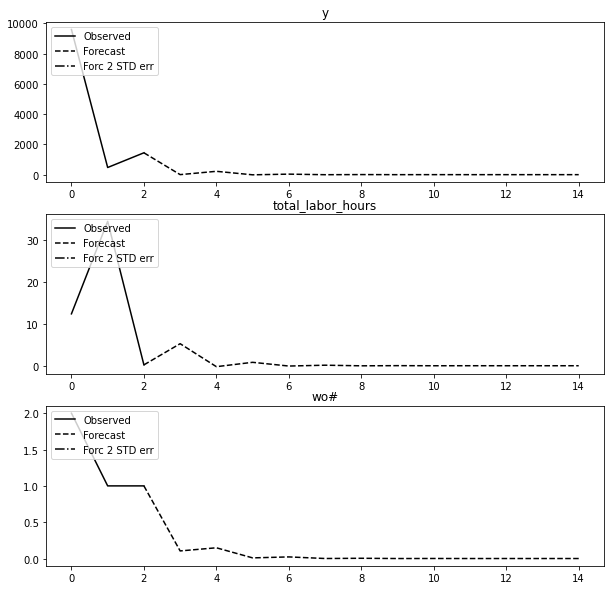

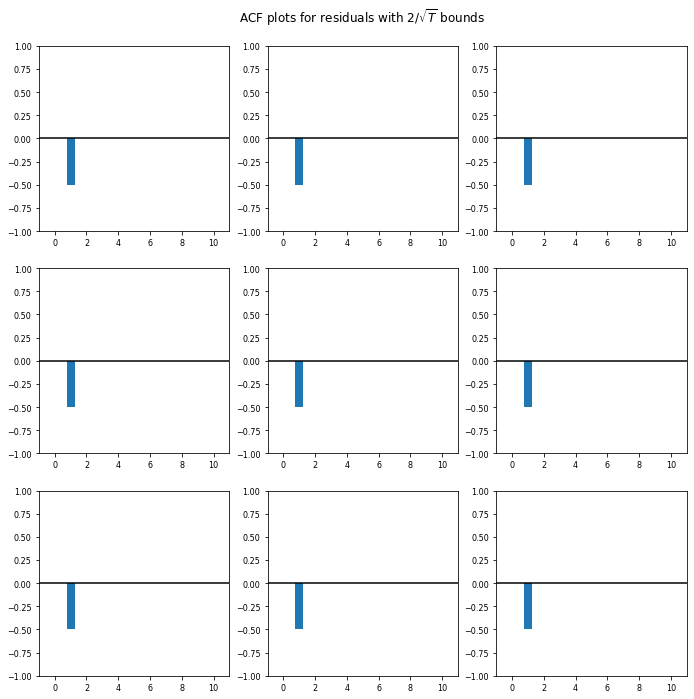

In [240]:
for store in specialties:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = var_specialty_results[var_specialty_results["specialty"] == store]
    try:
        vm = load_pickle("./models/specialty/var/{0}_var_model.pickle".format(store))
        fig1 = vm.plot_forecast(12)
        for ax in fig1.axes:
            ax.legend(loc="upper left")
        fig1.savefig("./images/specialty/var/{0}_forecast.png".format(store))

        fig2 = vm.plot_acorr()
        fig2.savefig("./images/specialty/var/{0}_acorr.png".format(store))
    except Exception as e:
        print(e)    
    

### Group the data by month and the District so we can pass it to our model

In [180]:
monthly_district_agg = data_dropped_cols_ohe.groupby([pd.Grouper(key="date_time_created", freq="MS"), "district"])\
    .agg({"total_cost": 'sum', 
            "total_labor_hours": 'sum',
              "wo#": "count"}).reset_index()

In [181]:
count = 0

def district_prophet_ts_reg(data):
    # Select the columns to pass to the prophet model
    if len(data.dropna()) < 3:
        print("skipping...", data.district)
        return None 

    data = data.rename({"date_time_created": "ds",
                        "total_cost": "y"
                       }
                       , axis=1)
    #time_series_data = data[['ds','MedianPrice']]
    
    #time_series_data.columns = ["ds", "y"]
    store = data.district.iloc[0]    
    
    # Instantiate and fit the prophet model
    m = Prophet(yearly_seasonality=True)
    m.fit(data)
    
    # Save the model
    fname = "./models/district/prophet/{0}_model.json".format(store) 
    with open(fname, 'w') as fout:
        json.dump(model_to_json(m), fout)
    
    # Make a monthly dataframe to predict next 12 months (FY 2018)
    future = m.make_future_dataframe(periods=12,freq="MS")
    forecast_df = m.predict(future)
    forecast_df = forecast_df.set_index('ds')

    # joing the forecast and historical data together
    history_data = data.set_index('ds')
    results_df = forecast_df.join(history_data, how="left")
    #results_df = results_df.reset_index(level=0)
    results_df["yhat"] = results_df["yhat"].apply(lambda x: x if x >= 0 else 0)
#     results_df["portfolio"] = store
    global count
    count +=1
    global start_time
    print("Done.. {0}".format(count))
    print(f"Elapsed: {(time.time() - start_time)/ 60:.2f} mins")
    
    return results_df

In [182]:
start_time = time.time()
district_results = monthly_district_agg.groupby("district").apply(district_prophet_ts_reg)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


Done.. 1
Elapsed: 0.03 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 2
Elapsed: 0.07 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 3
Elapsed: 0.12 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 4
Elapsed: 0.15 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 23.


Done.. 5
Elapsed: 0.19 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 6
Elapsed: 0.22 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 23.


Done.. 7
Elapsed: 0.26 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 8
Elapsed: 0.29 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 9
Elapsed: 0.33 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 10
Elapsed: 0.36 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 11
Elapsed: 0.40 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 12
Elapsed: 0.43 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 13
Elapsed: 0.47 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 14
Elapsed: 0.51 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 24.


Done.. 15
Elapsed: 0.56 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 16
Elapsed: 0.59 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 17
Elapsed: 0.64 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 18
Elapsed: 0.68 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 19
Elapsed: 0.72 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 20
Elapsed: 0.76 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 21
Elapsed: 0.81 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 22
Elapsed: 0.85 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 23
Elapsed: 0.89 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 24
Elapsed: 0.93 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 25
Elapsed: 0.98 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 26
Elapsed: 1.02 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 27
Elapsed: 1.06 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 28
Elapsed: 1.11 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 29
Elapsed: 1.15 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 30
Elapsed: 1.20 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 31
Elapsed: 1.24 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 32
Elapsed: 1.27 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 33
Elapsed: 1.31 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 34
Elapsed: 1.35 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 35
Elapsed: 1.39 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 36
Elapsed: 1.43 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 37
Elapsed: 1.46 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 38
Elapsed: 1.49 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 39
Elapsed: 1.52 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 40
Elapsed: 1.56 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 41
Elapsed: 1.60 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 42
Elapsed: 1.63 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 43
Elapsed: 1.67 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 44
Elapsed: 1.70 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 45
Elapsed: 1.74 mins
Done.. 46
Elapsed: 1.78 mins


In [183]:
district_results.index.set_names(["store", "ds"], inplace=True)
district_results = district_results.reset_index().drop("store", axis=1)

In [184]:
district_results.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat,district,y,total_labor_hours,wo#
0,2011-01-01,-12471.680,-32299.576,11287.887,-12471.680,-12471.680,1360.522,1360.522,1360.522,1360.522,1360.522,1360.522,0.000,0.000,0.000,0.000,District 101,0.000,1.140,1.000
1,2011-02-01,-10633.434,-18460.917,25129.543,-10633.434,-10633.434,13516.993,13516.993,13516.993,13516.993,13516.993,13516.993,0.000,0.000,0.000,2883.558,District 101,0.000,38.280,4.000
2,2011-03-01,-8973.083,-26251.427,16344.638,-8973.083,-8973.083,4837.796,4837.796,4837.796,4837.796,4837.796,4837.796,0.000,0.000,0.000,0.000,District 101,0.000,12.500,2.000
3,2011-04-01,-7134.838,-14915.629,28209.987,-7134.838,-7134.838,13965.424,13965.424,13965.424,13965.424,13965.424,13965.424,0.000,0.000,0.000,6830.587,District 101,0.000,2.230,2.000
4,2011-05-01,-5355.890,-39073.409,6218.711,-5355.890,-5355.890,-10982.125,-10982.125,-10982.125,-10982.125,-10982.125,-10982.125,0.000,0.000,0.000,0.000,District 101,0.000,2.930,6.000


In [185]:
districts = data_dropped_cols_ohe["district"].unique().tolist()
districts

['District 95',
 'District 326',
 'District 336',
 'District 105',
 'District 333',
 'District 94',
 'District 315',
 'District 132',
 'District 151',
 'District 317',
 'District 316',
 'District 318',
 'District 314',
 'District 312',
 'District 322',
 'District 324',
 'District 313',
 'District 152',
 'District 142',
 'District 331',
 'District 321',
 'District 133',
 'District 328',
 'District 335',
 'District 327',
 'District 141',
 'District 103',
 'District 323',
 'District 311',
 'District 332',
 'District 325',
 'District 91',
 'District 134',
 'District 337',
 'District 135',
 'District 93',
 'District 334',
 'District 101',
 'District 144',
 'District 145',
 'District 131',
 'District 104',
 'District 92',
 'District 338',
 'District 102',
 'District 143']

- plot the forecast and the forecast components

**************************************************
District 95
**************************************************
**************************************************
District 326
**************************************************
**************************************************
District 336
**************************************************
**************************************************
District 105
**************************************************
**************************************************
District 333
**************************************************
**************************************************
District 94
**************************************************
**************************************************
District 315
**************************************************
**************************************************
District 132
**************************************************
**************************************************
District 151
******************

C:\Users\Alec\anaconda3\lib\site-packages\prophet\plot.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(facecolor='w', figsize=figsize)


**************************************************
District 318
**************************************************
**************************************************
District 314
**************************************************
**************************************************
District 312
**************************************************
**************************************************
District 322
**************************************************
**************************************************
District 324
**************************************************
**************************************************
District 313
**************************************************
**************************************************
District 152
**************************************************
**************************************************
District 142
**************************************************
**************************************************
District 331
****************

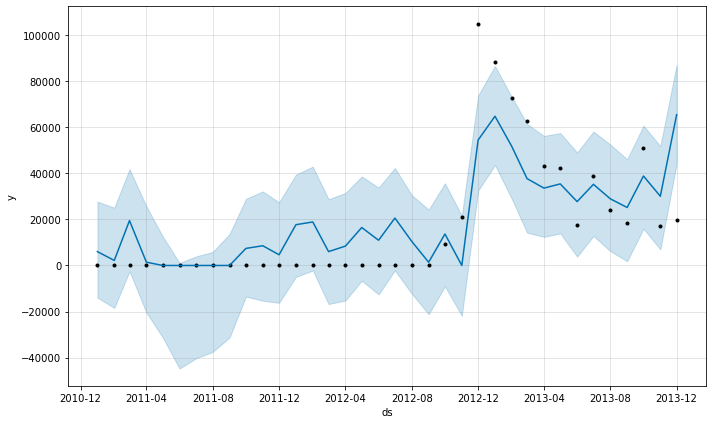

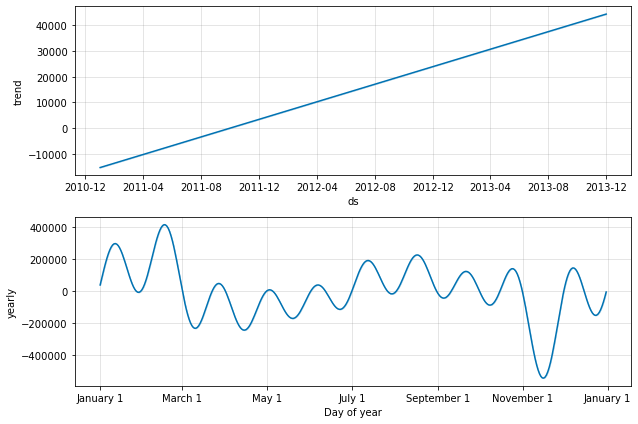

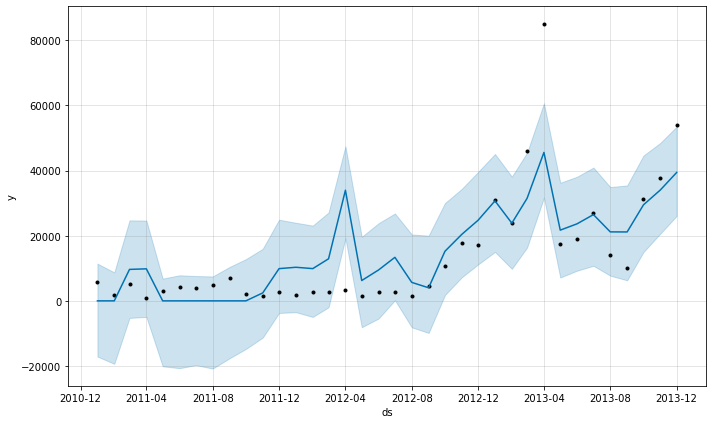

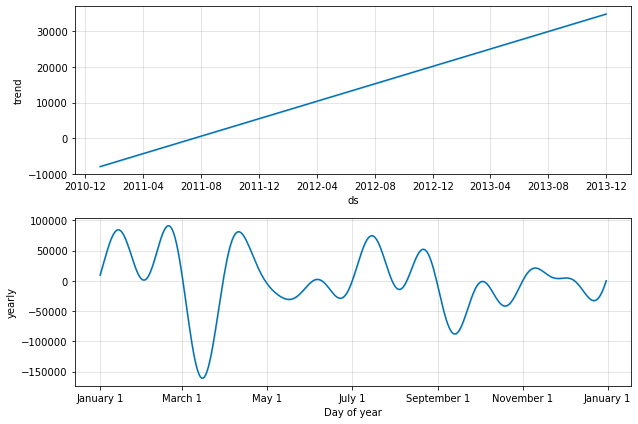

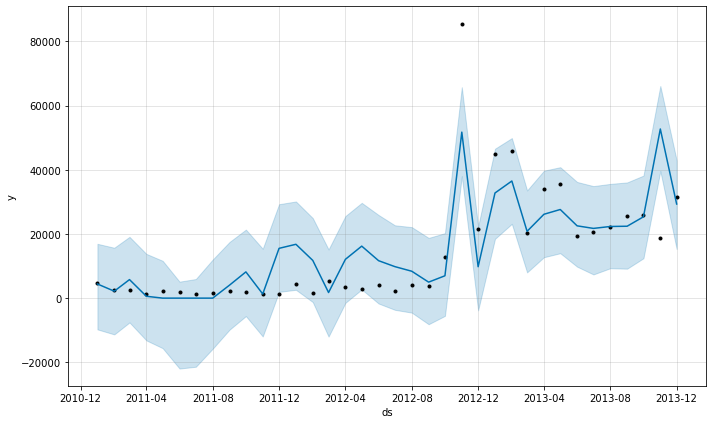

...

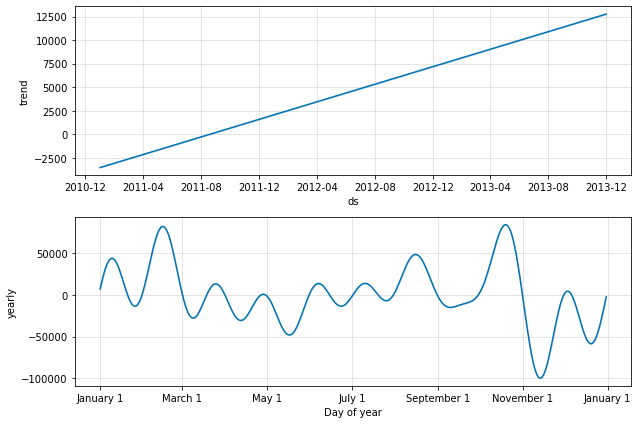

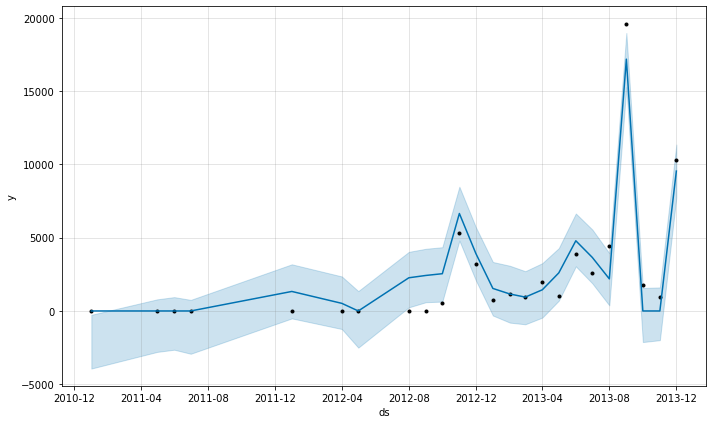

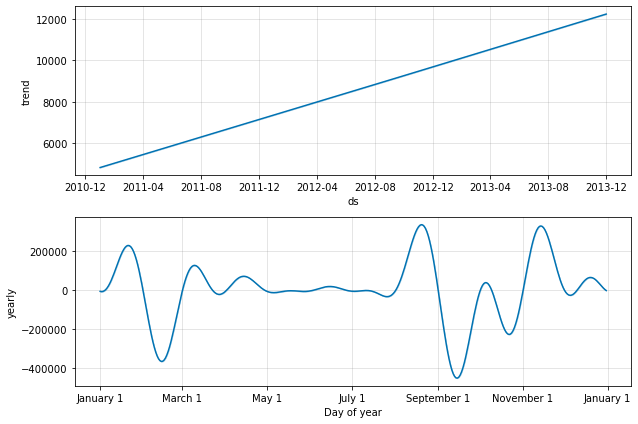

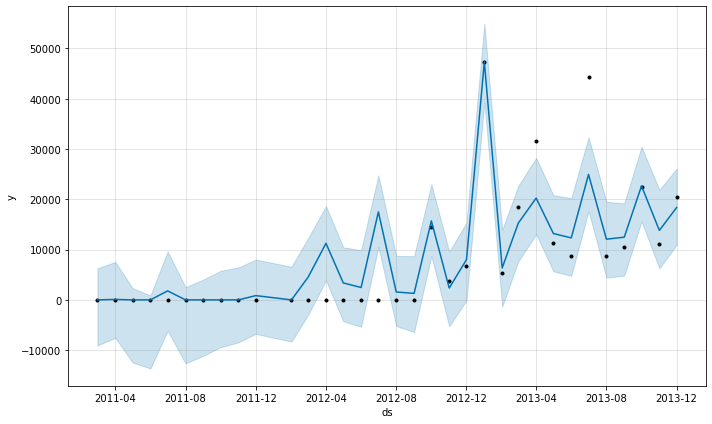

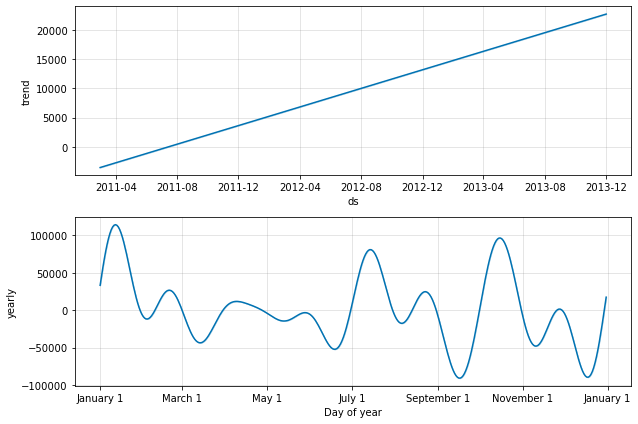

In [187]:
for store in districts:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = district_results[district_results["district"] == store]
    with open("./models/district/prophet/{0}_model.json".format(store), 'r') as fin:
        m = model_from_json(json.load(fin))  # Load model
        fig1 = m.plot(store_results)
        fig1.savefig("./images/district/prophet/{0}_forecast_plot.png".format(store))
        fig2 = m.plot_components(store_results)
        fig2.savefig("./images/district/prophet/{0}_forecast_components.png".format(store))
        

**************************************************
District 95
**************************************************
**************************************************
District 326
**************************************************
**************************************************
District 336
**************************************************
**************************************************
District 105
**************************************************
**************************************************
District 333
**************************************************
**************************************************
District 94
**************************************************
**************************************************
District 315
**************************************************
**************************************************
District 132
**************************************************
**************************************************
District 151
******************

C:\Users\Alec\anaconda3\lib\site-packages\prophet\plot.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(facecolor='w', figsize=figsize)


**************************************************
District 133
**************************************************
**************************************************
District 328
**************************************************
**************************************************
District 335
**************************************************
**************************************************
District 327
**************************************************
**************************************************
District 141
**************************************************
**************************************************
District 103
**************************************************
**************************************************
District 323
**************************************************
**************************************************
District 311
**************************************************
**************************************************
District 332
****************

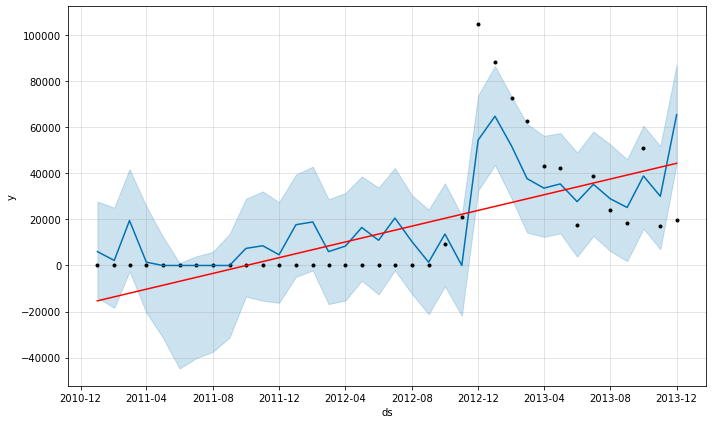

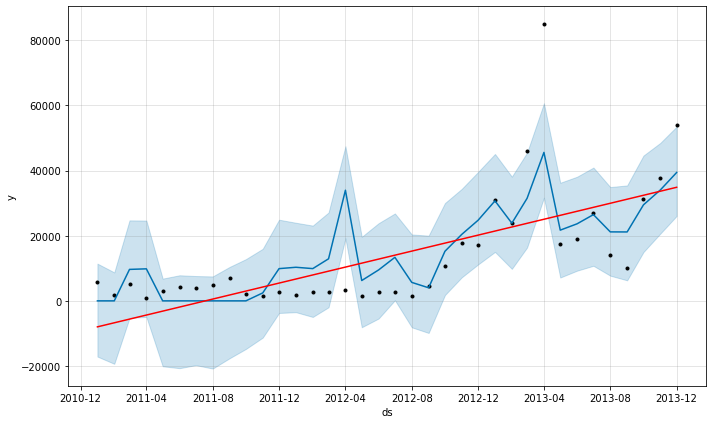

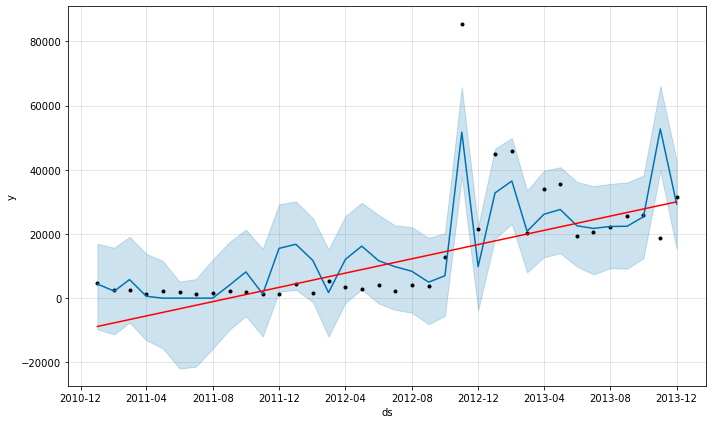

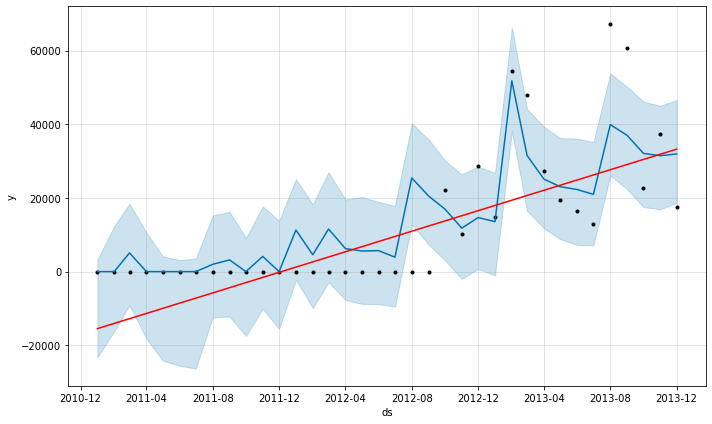

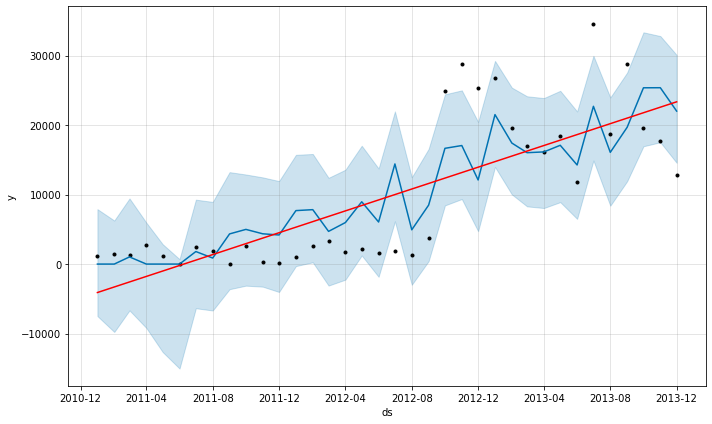

...

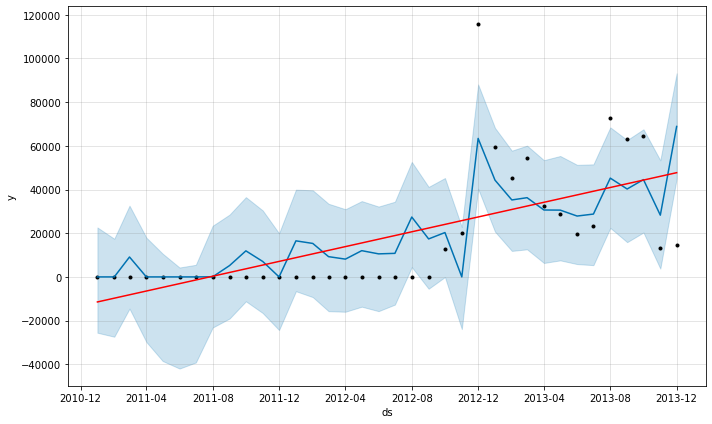

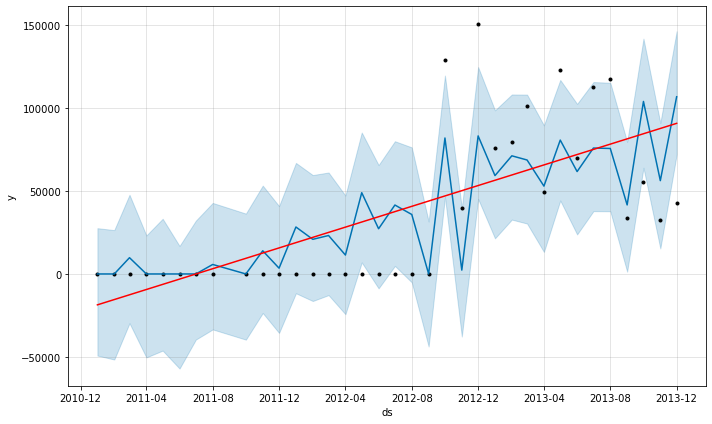

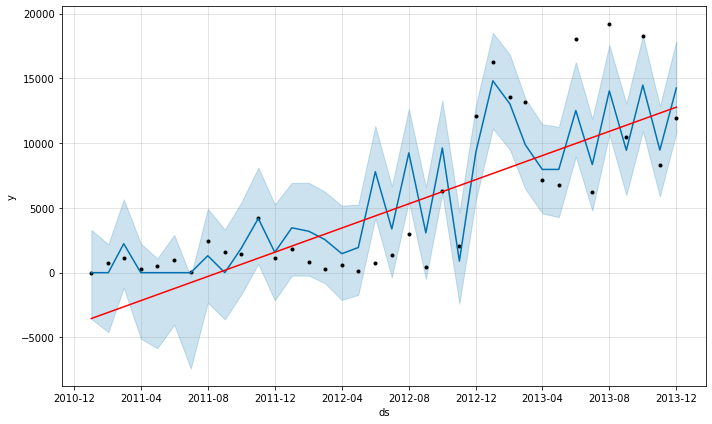

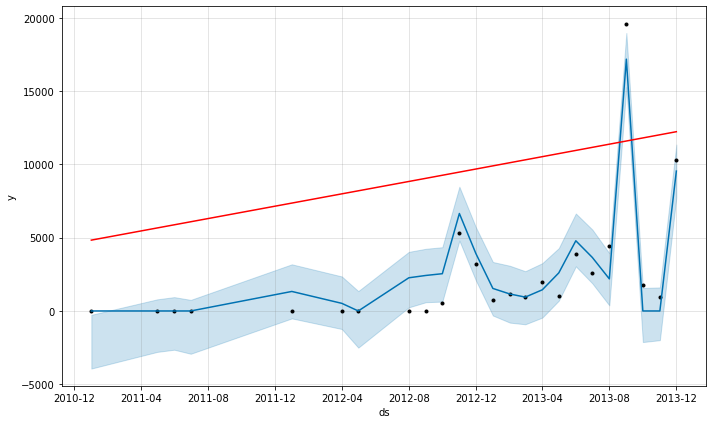

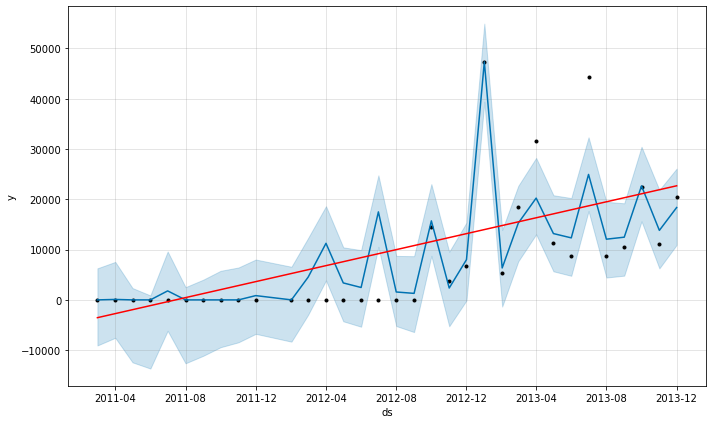

In [188]:
for store in districts:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = district_results[district_results["district"] == store]
    with open("./models/district/prophet/{0}_model.json".format(store), 'r') as fin:
        m = model_from_json(json.load(fin))  # Load model
        fig1 = m.plot(store_results)
        a = add_changepoints_to_plot(fig1.gca(), m, store_results)
        fig1.savefig("./images/district/prophet/{0}_forecast_plot_w_changepoints.png".format(store))
        
        

- evaluate the model and save the metrics

In [189]:
def district_eval_forecast(data):
    #print(data.head())
    data = data.dropna(how='any')
    data = data.replace(np.inf, 0).replace(-np.inf, 0)
    mean_fcst_vals = np.mean(data["y"])
    std_fcst_vals = np.std(data["yhat"])

    mse = mean_squared_error(data["y"], data["yhat"])
    rmse = np.sqrt(mse)
    rmse_pct = np.round(rmse / mean_fcst_vals, 6)
    results_dict = {
      "district": [data["district"].iloc[0]],
      "mse": [mse],
      "rmse": [rmse],
      "rmse_pct": [rmse_pct],
      "forecast_standard_deviation": [std_fcst_vals]
    }

    return pd.DataFrame.from_dict(results_dict)

In [190]:
district_results_errors = district_results.groupby("district").apply(district_eval_forecast)
district_results_errors

,,district,mse,rmse,rmse_pct,forecast_standard_deviation
district,,,,,,
District 101,0,District 101,261198025.754,16161.622,0.840,21020.078
District 102,0,District 102,1675229.369,1294.307,0.531,3793.232
District 103,0,District 103,44022357.081,6634.935,0.621,12466.997
District 104,0,District 104,311718563.372,17655.553,0.994,18403.019
District 105,0,District 105,104945085.362,10244.271,0.802,13749.864
District 131,0,District 131,74652257.159,8640.154,0.542,16784.017
District 132,0,District 132,57586359.148,7588.568,0.529,14493.303
District 133,0,District 133,13408399.182,3661.748,0.501,7074.371
District 134,0,District 134,20646023.844,4543.790,0.561,7912.877


In [191]:
district_results_errors.to_csv("./results/district/prophet/result_error_metrics.csv", index=False)

In [192]:
district_results_errors.to_csv("./results/district/prophet/forecast.csv", index=False)

### Build a Vector Auto Regression (VAR) model to forecast total cost and labor hours

In [193]:
count = 0
def district_var_ts(data):
    data = data.rename({"date_time_created": "ds",
                        "total_cost": "y"
                       }
                       , axis=1)
    #time_series_data = data[['ds','MedianPrice']]
    data = data.set_index("ds")
    
    #time_series_data.columns = ["ds", "y"]
    store = data.district.iloc[0] 
    ts_data = data.drop("district", axis=1)
    model = VAR(endog=ts_data)
    model_fit = model.fit()
    
    model_fit.save("./models/district/var/{0}_var_model.pickle".format(store))
    
    predictions = model_fit.forecast(model_fit.y, steps=12)
    
    
    pred = pd.DataFrame(index=range(0,len(predictions)),columns=[ts_data.columns])
    for j in range(0,len(ts_data.columns)):
        for i in range(0, len(predictions)):
            pred.iloc[i][j] = predictions[i][j]
    global count
    count +=1
    global start_time
    print("Done.. {0}".format(count))
    print(f"Elapsed: {(time.time() - start_time)/ 60:.2f} mins")
    
    return pred

In [194]:
start_time = time.time()
var_district_results = monthly_district_agg.groupby("district").apply(district_var_ts).reset_index().drop("level_1", axis=1)

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\base\wrapper.py:34: FutureWarning: y is a deprecated alias for endog, will be removed in version 0.11.0
  obj = getattr(results, attr)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:583: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model

Done.. 1
Elapsed: 0.00 mins
Done.. 2
Elapsed: 0.00 mins
Done.. 3
Elapsed: 0.00 mins
Done.. 4
Elapsed: 0.00 mins
Done.. 5
Elapsed: 0.00 mins
Done.. 6
Elapsed: 0.00 mins
Done.. 7
Elapsed: 0.00 mins
Done.. 8
Elapsed: 0.00 mins
Done.. 9
Elapsed: 0.00 mins
Done.. 10
Elapsed: 0.00 mins
Done.. 11
Elapsed: 0.00 mins
Done.. 12
Elapsed: 0.00 mins
Done.. 13
Elapsed: 0.00 mins
Done.. 14
Elapsed: 0.00 mins
Done.. 15
Elapsed: 0.00 mins
Done.. 16
Elapsed: 0.00 mins
Done.. 17
Elapsed: 0.00 mins
Done.. 18
Elapsed: 0.00 mins
Done.. 19
Elapsed: 0.00 mins
Done.. 20
Elapsed: 0.00 mins
Done.. 21
Elapsed: 0.00 mins
Done.. 22
Elapsed: 0.00 mins
Done.. 23
Elapsed: 0.00 mins
Done.. 24
Elapsed: 0.00 mins
Done.. 25
Elapsed: 0.00 mins
Done.. 26
Elapsed: 0.00 mins
Done.. 27
Elapsed: 0.00 mins
Done.. 28
Elapsed: 0.01 mins
Done.. 29
Elapsed: 0.01 mins
Done.. 30
Elapsed: 0.01 mins
Done.. 31
Elapsed: 0.01 mins
Done.. 32
Elapsed: 0.01 mins
Done.. 33
Elapsed: 0.01 mins
Done.. 34
Elapsed: 0.01 mins
Done.. 35
Elapsed: 0.01

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\a

Done.. 36
Elapsed: 0.01 mins
Done.. 37
Elapsed: 0.01 mins
Done.. 38
Elapsed: 0.01 mins
Done.. 39
Elapsed: 0.01 mins
Done.. 40
Elapsed: 0.01 mins
Done.. 41
Elapsed: 0.01 mins
Done.. 42
Elapsed: 0.01 mins
Done.. 43
Elapsed: 0.01 mins
Done.. 44
Elapsed: 0.01 mins
Done.. 45
Elapsed: 0.01 mins
Done.. 46
Elapsed: 0.01 mins


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\a

In [ ]:
var_district_results.to_csv("./results/district/var/forecast.csv", index=False)

In [195]:
var_district_results

,district,y,total_labor_hours,wo#
0,District 101,42128.159,2050.850,263.287
1,District 101,37376.537,1786.167,252.953
2,District 101,34493.988,1649.215,246.489
3,District 101,32892.899,1573.996,241.826
4,District 101,31937.842,1529.200,238.194
...,...,...,...,...
547,District 95,35497.104,2083.265,273.268
548,District 95,35354.793,2076.515,272.349
549,District 95,35228.154,2070.048,271.482
550,District 95,35111.321,2063.970,270.674


- print model summary to text files

In [197]:
for store in districts:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = var_district_results[var_district_results["district"] == store]
    
    vm = load_pickle("./models/district/var/{0}_var_model.pickle".format(store))
    with open("./results/district/var/{0}_model_summary.txt".format(store), 'w') as f:
        print(vm.summary(),file=f)

**************************************************
District 95
**************************************************
**************************************************
District 326
**************************************************
**************************************************
District 336
**************************************************
**************************************************
District 105
**************************************************
**************************************************
District 333
**************************************************
**************************************************
District 94
**************************************************
**************************************************
District 315
**************************************************
**************************************************
District 132
**************************************************
**************************************************
District 151
******************

- save forecast and autocorrelation plots 

**************************************************
District 95
**************************************************
**************************************************
District 326
**************************************************
**************************************************
District 336
**************************************************
**************************************************
District 105
**************************************************
**************************************************
District 333
**************************************************
**************************************************
District 94
**************************************************
**************************************************
District 315
**************************************************
**************************************************
District 132
**************************************************
**************************************************
District 151
******************

C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\plotting.py:65: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10, 10))


**************************************************
District 318
**************************************************
**************************************************
District 314
**************************************************
**************************************************
District 312
**************************************************
**************************************************
District 322
**************************************************
**************************************************
District 324
**************************************************
**************************************************
District 313
**************************************************
**************************************************
District 152
**************************************************
**************************************************
District 142
**************************************************
**************************************************
District 331
****************

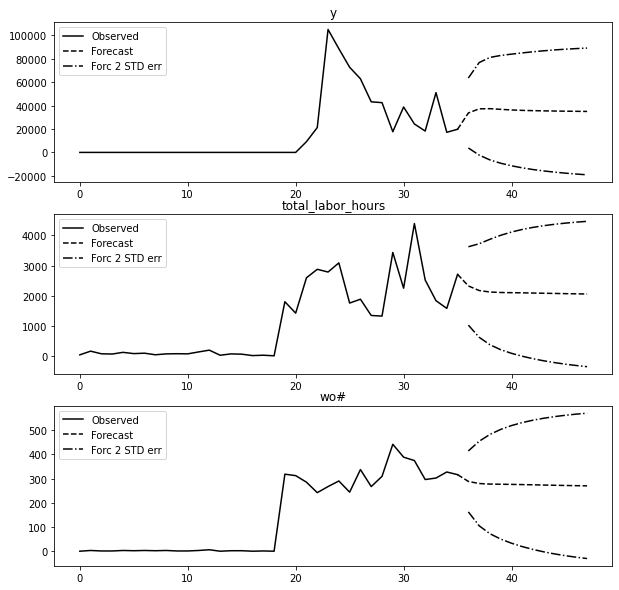

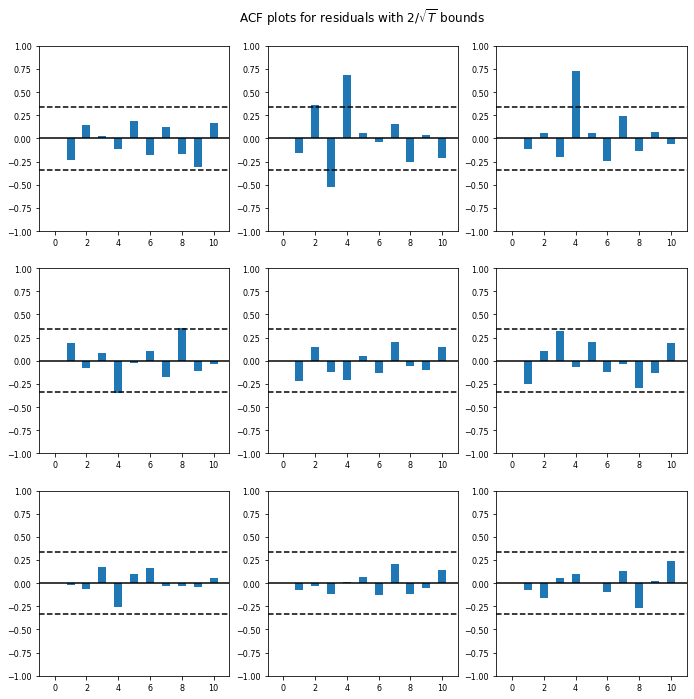

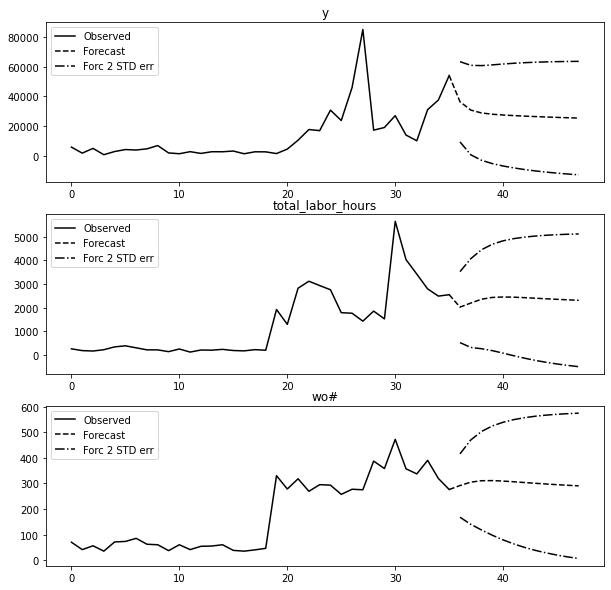

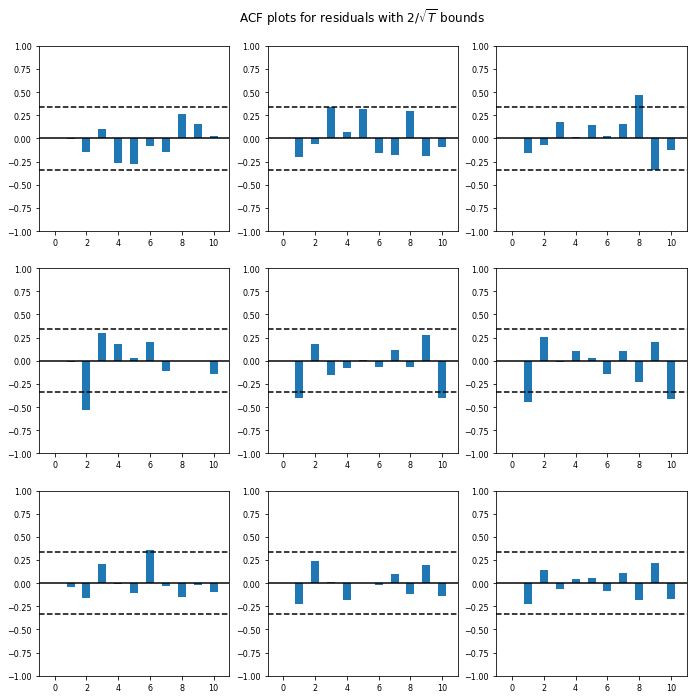

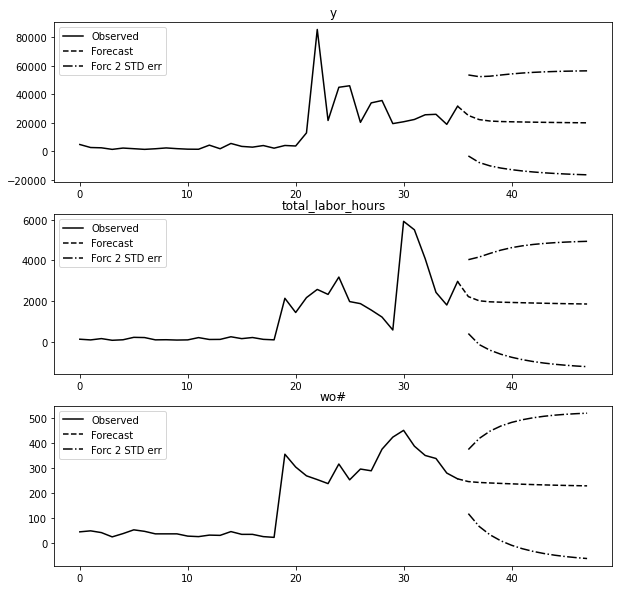

...

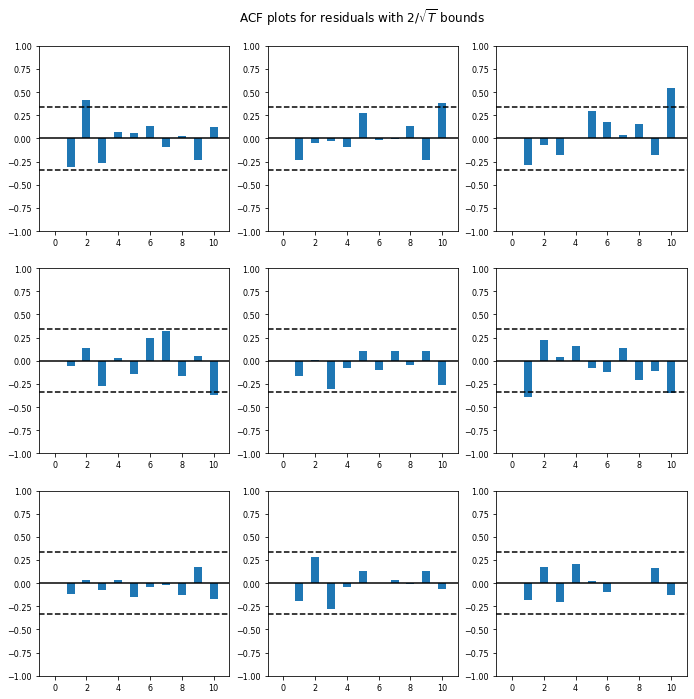

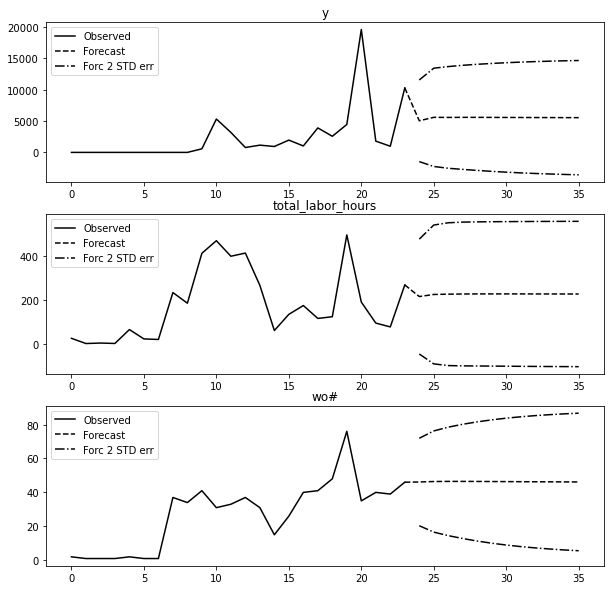

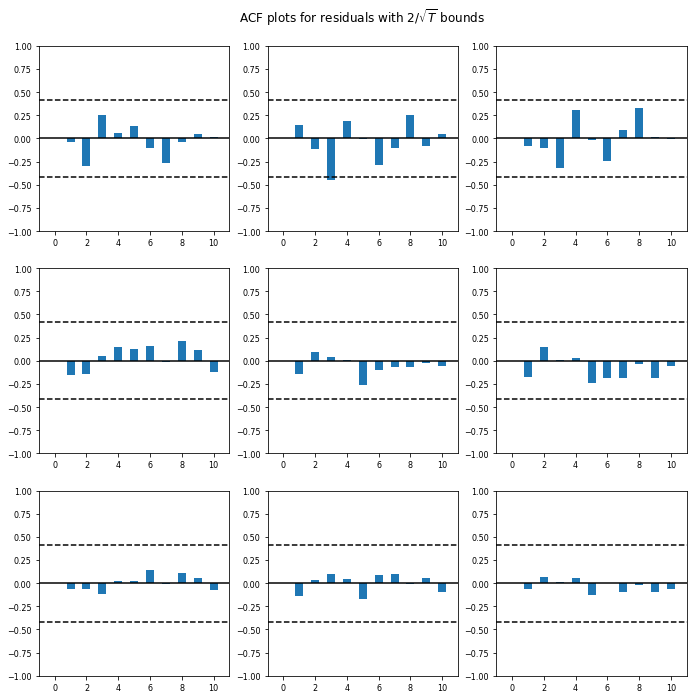

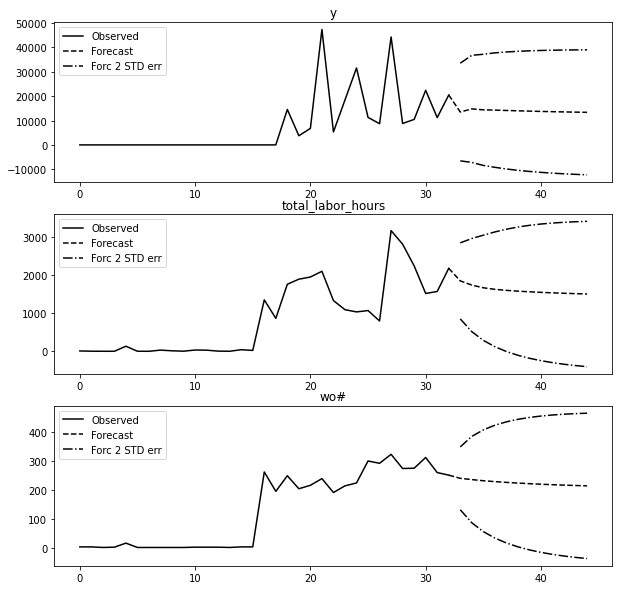

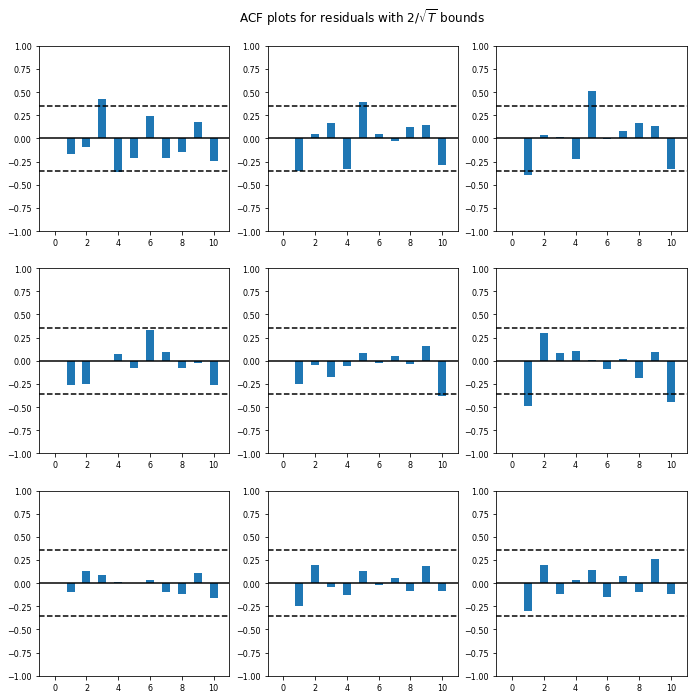

In [198]:
for store in districts:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = var_district_results[var_district_results["district"] == store]
    
    vm = load_pickle("./models/district/var/{0}_var_model.pickle".format(store))
    fig1 = vm.plot_forecast(12)
    for ax in fig1.axes:
        ax.legend(loc="upper left")
    fig1.savefig("./images/district/var/{0}_forecast.png".format(store))
    
    fig2 = vm.plot_acorr()
    fig2.savefig("./images/district/var/{0}_acorr.png".format(store))

### Group the data by month and the Type Category so we can pass it to our model

In [202]:
monthly_type_category_agg = data_dropped_cols_ohe.groupby([pd.Grouper(key="date_time_created", freq="MS"), "type_category"])\
    .agg({"total_cost": 'sum', 
            "total_labor_hours": 'sum',
              "wo#": "count"}).reset_index()

In [203]:
count = 0

def type_category_prophet_ts_reg(data):
    # Select the columns to pass to the prophet model
    if len(data.dropna()) < 3:
        print("skipping...", data.type_category)
        return None 

    data = data.rename({"date_time_created": "ds",
                        "total_cost": "y"
                       }
                       , axis=1)
    #time_series_data = data[['ds','MedianPrice']]
    
    #time_series_data.columns = ["ds", "y"]
    store = data.type_category.iloc[0]    
    
    # Instantiate and fit the prophet model
    m = Prophet(yearly_seasonality=True)
    m.fit(data)
    
    # Save the model
    fname = "./models/type_category/prophet/{0}_model.json".format(store) 
    with open(fname, 'w') as fout:
        json.dump(model_to_json(m), fout)
    
    # Make a monthly dataframe to predict next 12 months (FY 2018)
    future = m.make_future_dataframe(periods=12,freq="MS")
    forecast_df = m.predict(future)
    forecast_df = forecast_df.set_index('ds')

    # joing the forecast and historical data together
    history_data = data.set_index('ds')
    results_df = forecast_df.join(history_data, how="left")
    #results_df = results_df.reset_index(level=0)
    results_df["yhat"] = results_df["yhat"].apply(lambda x: x if x >= 0 else 0)
#     results_df["portfolio"] = store
    global count
    count +=1
    global start_time
    print("Done.. {0}".format(count))
    print(f"Elapsed: {(time.time() - start_time)/ 60:.2f} mins")
    
    return results_df

In [204]:
start_time = time.time()
type_category_results = monthly_type_category_agg.groupby("type_category").apply(type_category_prophet_ts_reg)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 5.


Done.. 1
Elapsed: 0.71 mins


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Done.. 2
Elapsed: 0.75 mins
Done.. 3
Elapsed: 0.79 mins


In [205]:
type_category_results.index.set_names(["store", "ds"], inplace=True)
type_category_results = type_category_results.reset_index().drop("store", axis=1)

In [206]:
type_category_results.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat,type_category,y,total_labor_hours,wo#
0,2012-09-01,1305624.739,-0.000,0.000,1305624.739,1305624.739,-1305624.739,-1305624.739,-1305624.739,-1305624.739,-1305624.739,-1305624.739,0.000,0.000,0.000,0.000,Basic,0.000,7.500,1.000
1,2012-10-01,1365718.794,451751.750,451751.750,1365718.794,1365718.794,-913967.044,-913967.044,-913967.044,-913967.044,-913967.044,-913967.044,0.000,0.000,0.000,451751.750,Basic,451751.750,1601.580,237.000
2,2012-11-01,1449542.121,1091368.420,1091368.420,1449542.121,1449542.121,-358173.701,-358173.701,-358173.701,-358173.701,-358173.701,-358173.701,0.000,0.000,0.000,1091368.420,Basic,1091368.420,3115.950,504.000
3,2012-12-01,1536236.513,856373.800,856373.800,1536236.513,1536236.513,-679862.713,-679862.713,-679862.713,-679862.713,-679862.713,-679862.713,0.000,0.000,0.000,856373.800,Basic,856373.800,2603.690,531.000
4,2013-01-01,1489653.962,1263645.920,1263645.920,1489653.962,1489653.962,-226008.042,-226008.042,-226008.042,-226008.042,-226008.042,-226008.042,0.000,0.000,0.000,1263645.920,Basic,1263645.920,4760.983,993.000


In [207]:
types = data_dropped_cols_ohe["type_category"].unique().tolist()
types

['Basic', 'Request', 'PMRM']

- plot the forecast and the forecast components

**************************************************
Basic
**************************************************
**************************************************
Request
**************************************************
**************************************************
PMRM
**************************************************


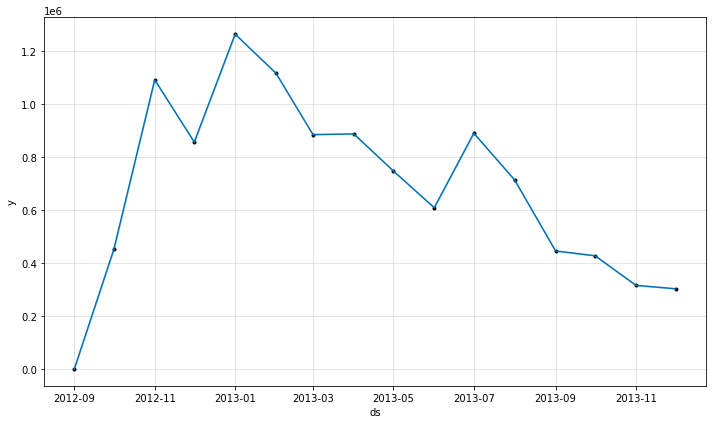

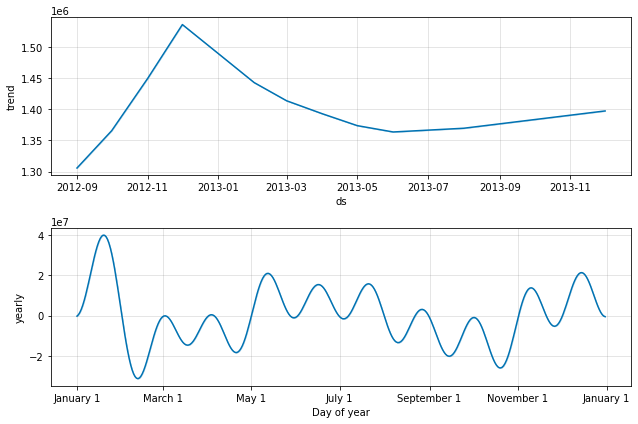

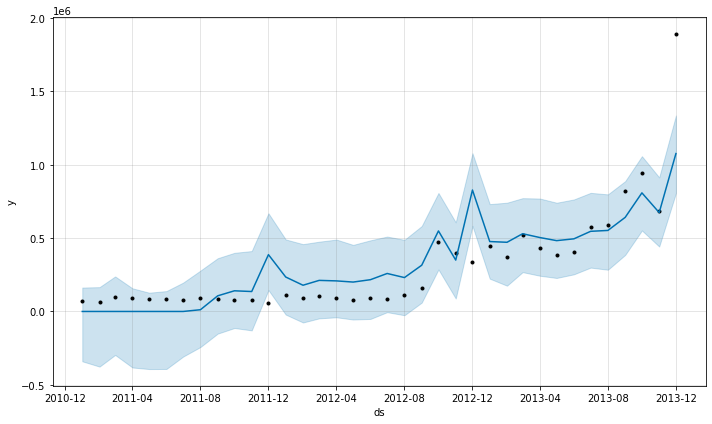

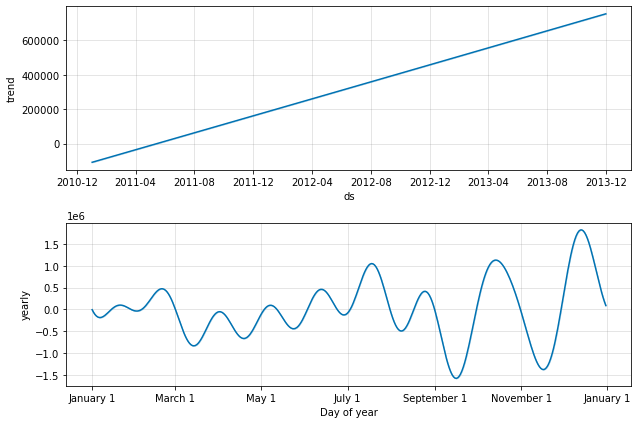

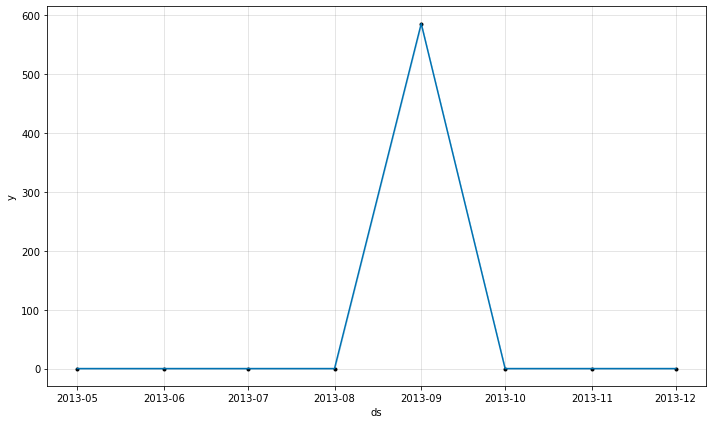

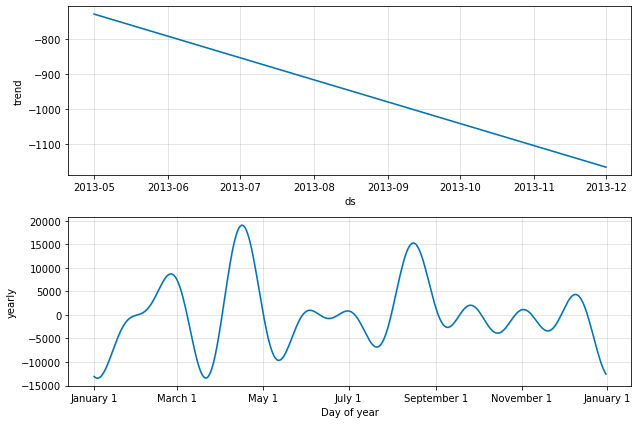

In [208]:
for store in types:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = type_category_results[type_category_results["type_category"] == store]
    with open("./models/type_category/prophet/{0}_model.json".format(store), 'r') as fin:
        m = model_from_json(json.load(fin))  # Load model
        fig1 = m.plot(store_results)
        fig1.savefig("./images/type_category/prophet/{0}_forecast_plot.png".format(store))
        fig2 = m.plot_components(store_results)
        fig2.savefig("./images/type_category/prophet/{0}_forecast_components.png".format(store))
        

**************************************************
Basic
**************************************************
**************************************************
Request
**************************************************
**************************************************
PMRM
**************************************************


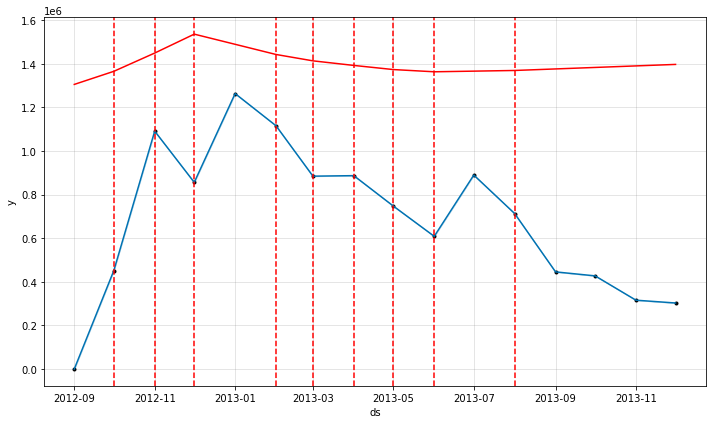

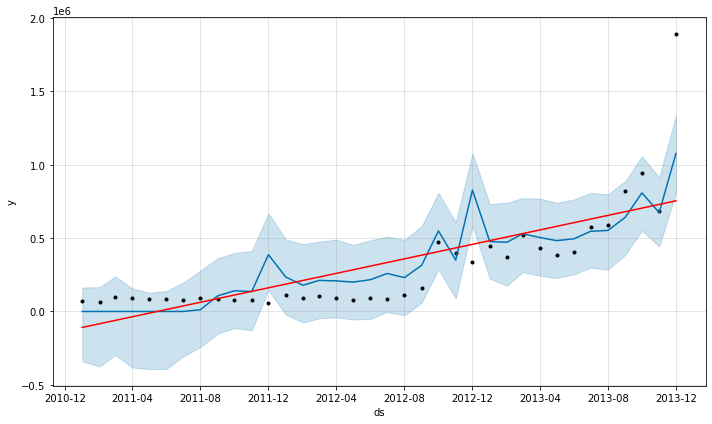

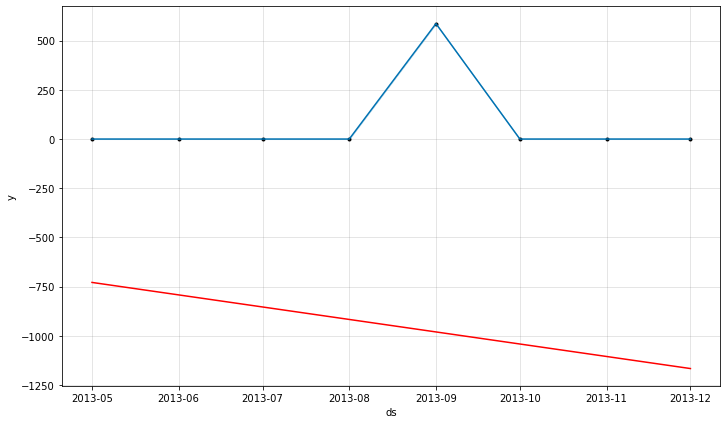

In [209]:
for store in types:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = type_category_results[type_category_results["type_category"] == store]
    with open("./models/type_category/prophet/{0}_model.json".format(store), 'r') as fin:
        m = model_from_json(json.load(fin))  # Load model
        fig1 = m.plot(store_results)
        a = add_changepoints_to_plot(fig1.gca(), m, store_results)
        fig1.savefig("./images/type_category/prophet/{0}_forecast_plot_w_changepoints.png".format(store))
        
        

- evaluate the model and save the metrics

In [211]:
def type_category_eval_forecast(data):
    #print(data.head())
    data = data.dropna(how='any')
    data = data.replace(np.inf, 0).replace(-np.inf, 0)
    mean_fcst_vals = np.mean(data["y"])
    std_fcst_vals = np.std(data["yhat"])

    mse = mean_squared_error(data["y"], data["yhat"])
    rmse = np.sqrt(mse)
    rmse_pct = np.round(rmse / mean_fcst_vals, 6)
    results_dict = {
      "type_category": [data["type_category"].iloc[0]],
      "mse": [mse],
      "rmse": [rmse],
      "rmse_pct": [rmse_pct],
      "forecast_standard_deviation": [std_fcst_vals]
    }

    return pd.DataFrame.from_dict(results_dict)

In [212]:
type_category_results_errors = type_category_results.groupby("type_category").apply(type_category_eval_forecast)
type_category_results_errors

,,type_category,mse,rmse,rmse_pct,forecast_standard_deviation
type_category,,,,,,
Basic,0,Basic,0.000,0.000,0.000,333324.178
PMRM,0,PMRM,0.000,0.000,0.000,193.831
Request,0,Request,36399093526.592,190785.465,0.614,271452.236


In [213]:
type_category_results_errors.to_csv("./results/type_category/prophet/result_error_metrics.csv", index=False)

In [214]:
type_category_results_errors.to_csv("./results/type_category/prophet/forecast.csv", index=False)

### Build a Vector Auto Regression (VAR) model to forecast total cost and labor hours

In [216]:
count = 0
def type_category_var_ts(data):
    data = data.rename({"date_time_created": "ds",
                        "total_cost": "y"
                       }
                       , axis=1)
    #time_series_data = data[['ds','MedianPrice']]
    data = data.set_index("ds")
    
    #time_series_data.columns = ["ds", "y"]
    store = data.type_category.iloc[0] 
    ts_data = data.drop("type_category", axis=1)
    model = VAR(endog=ts_data)
    model_fit = model.fit()
    
    model_fit.save("./models/type_category/var/{0}_var_model.pickle".format(store))
    
    predictions = model_fit.forecast(model_fit.y, steps=12)
    
    
    pred = pd.DataFrame(index=range(0,len(predictions)),columns=[ts_data.columns])
    for j in range(0,len(ts_data.columns)):
        for i in range(0, len(predictions)):
            pred.iloc[i][j] = predictions[i][j]
    global count
    count +=1
    global start_time
    print("Done.. {0}".format(count))
    print(f"Elapsed: {(time.time() - start_time)/ 60:.2f} mins")
    
    return pred

In [217]:
start_time = time.time()
var_type_category_results = monthly_type_category_agg.groupby("type_category").apply(type_category_var_ts).reset_index().drop("level_1", axis=1)

Done.. 1
Elapsed: 0.00 mins
Done.. 2
Elapsed: 0.00 mins
Done.. 3
Elapsed: 0.00 mins


C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\base\wrapper.py:34: FutureWarning: y is a deprecated alias for endog, will be removed in version 0.11.0
  obj = getattr(results, attr)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:527: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  % freq, ValueWarning)
C:\Users\Alec\anaconda3\lib\site-packages\pandas\core\generic.py:4153: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  obj = obj._drop_axis(labels, axis, le

In [218]:
var_type_category_results.to_csv("./results/type_category/var/forecast.csv", index=False)

In [220]:
var_type_category_results

,type_category,y,total_labor_hours,wo#
0,Basic,578035.718,1849.416,320.940
1,Basic,708844.722,2513.841,457.786
2,Basic,764345.241,2883.382,540.511
3,Basic,781812.884,3073.591,580.774
4,Basic,781987.293,3157.417,594.156
5,Basic,776005.139,3183.023,593.528
6,Basic,769281.148,3180.969,587.428
7,Basic,763960.323,3169.012,580.576
8,Basic,760493.002,3156.176,575.034
9,Basic,758593.654,3146.108,571.315


- print model summary to text files

In [221]:
for store in types:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = var_type_category_results[var_type_category_results["type_category"] == store]
    
    vm = load_pickle("./models/type_category/var/{0}_var_model.pickle".format(store))
    with open("./results/type_category/var/{0}_model_summary.txt".format(store), 'w') as f:
        print(vm.summary(),file=f)

**************************************************
Basic
**************************************************
**************************************************
Request
**************************************************
**************************************************
PMRM
**************************************************


- save forecast and autocorrelation plots 

**************************************************
Basic
**************************************************
**************************************************
Request
**************************************************
**************************************************
PMRM
**************************************************


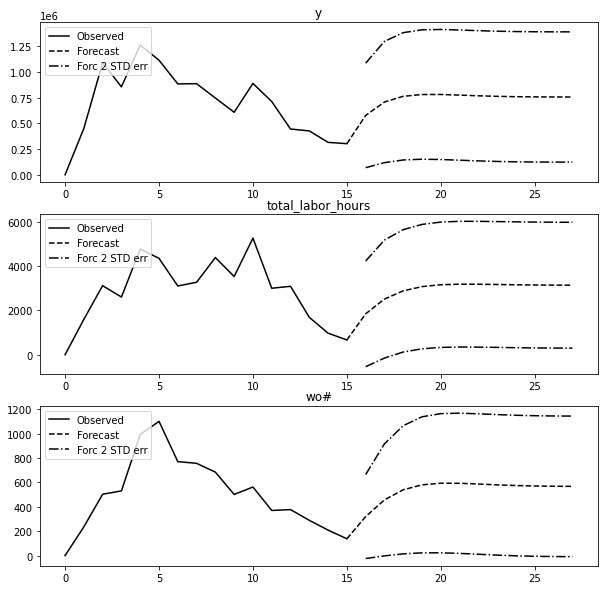

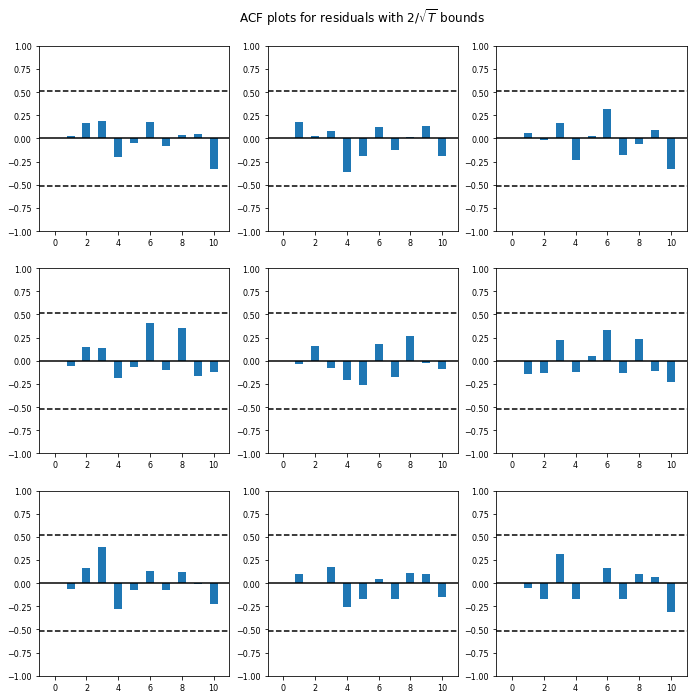

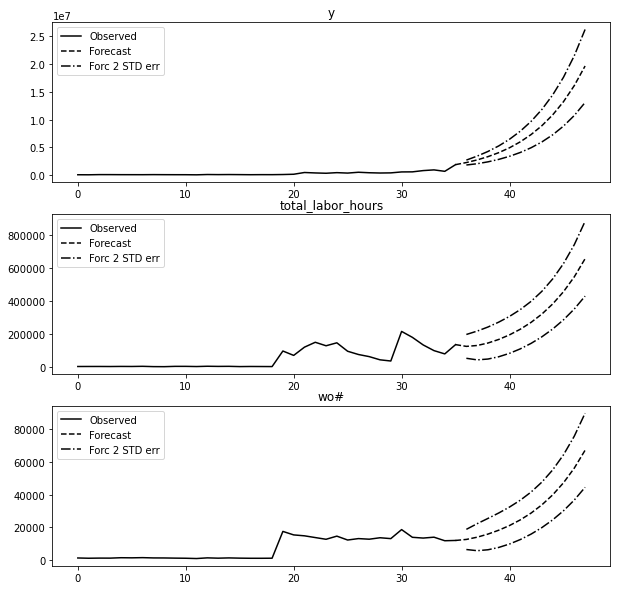

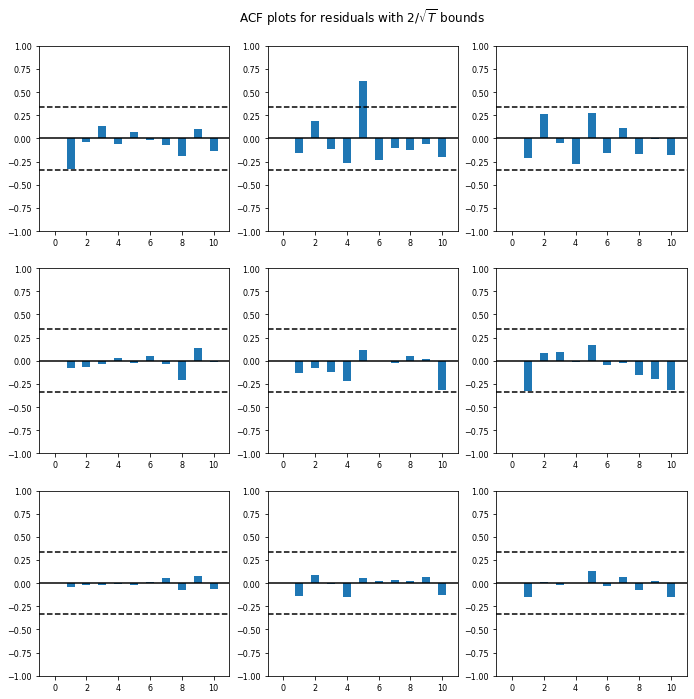

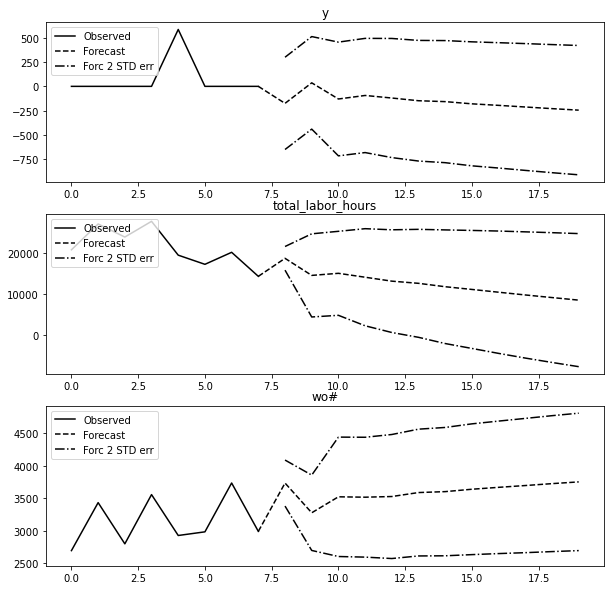

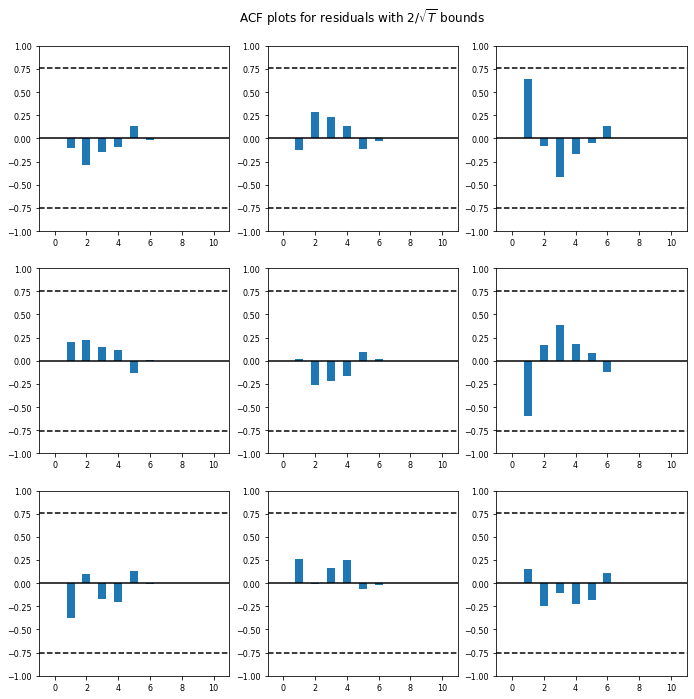

In [222]:
for store in types:
    print("*"*50)
    print(store)
    print("*"*50)
    store_results = var_type_category_results[var_type_category_results["type_category"] == store]
    
    vm = load_pickle("./models/type_category/var/{0}_var_model.pickle".format(store))
    fig1 = vm.plot_forecast(12)
    for ax in fig1.axes:
        ax.legend(loc="upper left")
    fig1.savefig("./images/type_category/var/{0}_forecast.png".format(store))
    
    fig2 = vm.plot_acorr()
    fig2.savefig("./images/type_category/var/{0}_acorr.png".format(store))